# Image Captioning
<img src="static/sheep.png" align="center"/>

Image captioning is a process of **describing content in the image**. As we already know, neural networks can understand the content of the image and they also can generate text. MIX and we get NN for image captioning. As a reference paper we'll use [Show, Attend and Tell: Neural Image Caption Generation with Visual Attention](https://arxiv.org/abs/1502.03044). It's a really good idea to read the paper before doing this homework.

Here's a brief overview of the paper (reference to [this repository](https://github.com/sgrvinod/a-PyTorch-Tutorial-to-Image-Captioning#concepts)):

## Encoder

The encoder encodes the input image with 3 color channels into a feature map which is a summary representation of all that's useful in the image. We use fully-conv architecture for it. Don't train encoder from scratch, but use pretrained CNN. E.g. you can use ResNet-101 pretrained on ImageNet from [torchvision models](https://pytorch.org/docs/stable/torchvision/models.html).

To keep encoder's output feature maps of fixed size you can use [nn.AdaptiveAvgPool2d](https://pytorch.org/docs/stable/nn.html#torch.nn.AdaptiveAvgPool2d).


<img src="static/encoder.png" align="center"/>

## Decoder

The decoder's job is to look at the encoded image and generate caption **word-by-word** (note, at the `08 seminar` generated sequences token-by-token). Since we generate sequence, we'll Recurrent Neural Network (LSTM). To feed image information to RNN we 1) average `(h, w)` dimensions of image feature map to get 1D vector, then 2) transform this vector with linear layer to fit the size of the RNN's hidden state and 3) pass it as an initial hidden state $h_0$.

<img src="static/decoder_no_att.png" align="center"/>

## Attention

In a setting with attention, we want the decoder to be able to look at different parts of the image at different timestamps in the sequence. For example, while generating the word `football` it's a good idea to look at image area, where football is located!

Instead of the simple averaging (like before), we use the **weighted averaging** across all pixels. This weighted representation of the image can be concatenated with the previously generated word at each timestamp to generate the next word.

<img src="static/decoder_att.png" align="center"/>


The attention network **computes these weights**. How would you estimate the importance of a certain part of an image? You would need to be aware of the sequence you have generated so far, so you can look at the image and decide what needs describing next. For example, after you mention a man, it is logical to declare that he is holding a football.

This is exactly what the attention mechanism does – it considers the sequence generated thus far, and attends to the part of the image that needs describing next.


<img src="static/att.png" align="center"/>

We'll use **soft** attention, where the weights of the pixels add up to 1. If there are $P$ pixels in our encoded image, then at each timestep $t$:



<img src="static/weights.png" align="center"/>

## Beam search

We use a linear layer to transform the decoder's output into a score for each word in the vocabulary.

The straightforward and greedy (just like we did at the `08 seminar`) option would be to choose the word with the highest score and use it to predict the next word. But this is not optimal because the rest of the sequence hinges on that first word you choose. If that choice isn't the best, everything that follows is sub-optimal. And it's not just the first word – each word in the sequence has consequences for the ones that succeed it.

It might happen that if you'd chosen the third best word at that first step, and the second best word at the second step, and so on... that would be the best sequence you could generate.

It would be best if we could somehow not decide until we've finished decoding completely, and choose the sequence that has the highest overall score from a basket of candidate sequences.

Beam Search does exactly this.

1. At the first decode step, consider the top k candidates.
2. Generate k second words for each of these k first words.
3. Choose the top k [first word, second word] combinations considering additive scores.
4. For each of these k second words, choose k third words, choose the top k [first word, second word, third word] combinations.
5. Repeat at each decode step.

After k sequences terminate, choose the sequence with the best overall score.


<img src="static/beam_search.png" align="center"/>

## Data
We'll use [Flickr8K dataset](http://nlp.cs.illinois.edu/HockenmaierGroup/8k-pictures.html). The Flickr 8K dataset includes images obtained from the Flickr website. Each image has several captions annotated by humans. To download the dataset follow [this link](http://nlp.cs.illinois.edu/HockenmaierGroup/8k-pictures.html) (use your academic e-mail for faster approvement).

## Game rules:
Maximum score you can get for this task is **10.0**.

1. **Baseline (5 points):** implement Encoder-Decoder network which generates worthy captions (without attention and beam search).
2. **+ attention (3 points):** add attention mechanism to the implemented baseline (+ visualize attention masks).
3. **+ beam search (2 points):** implement beam search generation algorithm.

We won't use any quantitative metric to measure quality. We'll just look at your generated captions for **20 images** from Flickr8K not used during training and **5 random images** from the Internet (you can choose any). 

So the result of your homework should be:
1. Code
2. 20 + 5 images with generated captions (+ attention masks if you implemented attention mechanism)
3. Short report about things you tried and what parts you managed to implement

In [ ]:
## A LOT OF YOUR CODE HERE

In [192]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import torch
import torch.nn as nn
import torchvision
import torchvision.transforms as transforms

from torch import optim
from torch.nn import functional as F
from torch.utils.data import DataLoader
from torchvision.models import resnet101
from torchvision.datasets import Flickr30k
from torch.nn.utils.rnn import pack_padded_sequence

from tqdm import tqdm_notebook as tqdm
from collections import defaultdict, Counter

%matplotlib inline

# Encoder

In [2]:
def set_parameter_requires_grad(model, feature_extracting=True):
    if feature_extracting:
        for param in model.parameters():
            param.requires_grad = False

In [3]:
class Permute(nn.Module):
    def __init__(self, *args):
        super(Permute, self).__init__()
        self.permute = args

    def forward(self, x):
        return x.permute(self.permute)

In [4]:
def make_encoder():
    encoder = resnet101(pretrained=True)
    modules = list(encoder.children())[:-2] + [nn.AdaptiveAvgPool2d(14), Permute(0, 2, 3, 1)]
    encoder = nn.Sequential(*modules)
    set_parameter_requires_grad(encoder, feature_extracting=True)
    return encoder

In [5]:
encoder = make_encoder()

In [6]:
encoder

Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (1

# Используем encoder как feature extractor(чтобы не пересчитывать кучу раз)

Загрузим изображения

In [155]:
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")

image_size = 224

data_dir = "./data"

enc_transform = transforms.Compose([
    transforms.Resize(size=(image_size, image_size)),
    transforms.ToTensor(),
    transforms.Normalize(
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225],
    ),
])

In [156]:
enc_transform

Compose(
    Resize(size=(224, 224), interpolation=PIL.Image.BILINEAR)
    ToTensor()
    Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
)

In [8]:
batch_size = 32
dataset = torchvision.datasets.ImageFolder(data_dir, transform=enc_transform)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False, num_workers=2)

Проверим, что все грузится правильно

In [9]:
def imshow(img):
    img = img / 2 + 0.5  # unnormalize
    img = img.cpu().numpy()
    plt.imshow(np.transpose(img, (1, 2, 0)))
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


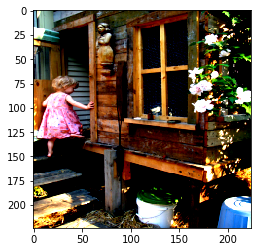

In [10]:
(image, _) = dataset[0]
imshow(image)

Извлечем фичи и сохраним

In [49]:
8000 / batch_size

250.0

In [50]:
feature_path = 'data/features'

for i, batch in tqdm(enumerate(dataloader)):
    names = list(map(
        lambda pair: pair[0].split('/')[-1].split('.')[0], 
        dataset.imgs[i*batch_size:(i+1)*batch_size]
    ))
    paths = list(map(lambda name: os.path.join(feature_path, f"{name}.npy"), names))
    
    # get features
    features = encoder(batch[0])
    
    # save features
    for path, feature in zip(paths, features):
        with open(path, 'wb') as file:
            np.save(file, feature.numpy())

In [36]:
names

['1000268201_693b08cb0e',
 '1001773457_577c3a7d70',
 '1002674143_1b742ab4b8',
 '1003163366_44323f5815']

In [37]:
features.shape

torch.Size([4, 14, 14, 2048])

Для загрузки фичей

paths = list(map(lambda name: os.path.join(feature_path, f"{name}.npy"), names))
for path, feature in zip(paths, features):
    with open(path, 'rb') as file:
        f = np.load(file)

# Нагло стыренная реализация Attention и Decoder слоев

[this repository](https://github.com/sgrvinod/a-PyTorch-Tutorial-to-Image-Captioning#concepts)

In [11]:
class Attention(nn.Module):
    """
    Attention Network.
    """

    def __init__(self, encoder_dim, decoder_dim, attention_dim):
        """
        :param encoder_dim: feature size of encoded images
        :param decoder_dim: size of decoder's RNN
        :param attention_dim: size of the attention network
        """
        super(Attention, self).__init__()
        self.encoder_att = nn.Linear(encoder_dim, attention_dim)  # linear layer to transform encoded image
        self.decoder_att = nn.Linear(decoder_dim, attention_dim)  # linear layer to transform decoder's output
        self.full_att = nn.Linear(attention_dim, 1)  # linear layer to calculate values to be softmax-ed
        self.relu = nn.ReLU()
        self.softmax = nn.Softmax(dim=1)  # softmax layer to calculate weights

    def forward(self, encoder_out, decoder_hidden):
        """
        Forward propagation.
        :param encoder_out: encoded images, a tensor of dimension (batch_size, num_pixels, encoder_dim)
        :param decoder_hidden: previous decoder output, a tensor of dimension (batch_size, decoder_dim)
        :return: attention weighted encoding, weights
        """
        att1 = self.encoder_att(encoder_out)  # (batch_size, num_pixels, attention_dim)
        att2 = self.decoder_att(decoder_hidden)  # (batch_size, attention_dim)
        att = self.full_att(self.relu(att1 + att2.unsqueeze(1))).squeeze(2)  # (batch_size, num_pixels)
        alpha = self.softmax(att)  # (batch_size, num_pixels)
        attention_weighted_encoding = (encoder_out * alpha.unsqueeze(2)).sum(dim=1)  # (batch_size, encoder_dim)

        return attention_weighted_encoding, alpha

In [12]:
class DecoderWithAttention(nn.Module):
    """
    Decoder.
    """

    def __init__(self, attention_dim, embed_dim, decoder_dim, vocab_size, encoder_dim=2048, dropout=0.5):
        """
        :param attention_dim: size of attention network
        :param embed_dim: embedding size
        :param decoder_dim: size of decoder's RNN
        :param vocab_size: size of vocabulary
        :param encoder_dim: feature size of encoded images
        :param dropout: dropout
        """
        super(DecoderWithAttention, self).__init__()

        self.encoder_dim = encoder_dim
        self.attention_dim = attention_dim
        self.embed_dim = embed_dim
        self.decoder_dim = decoder_dim
        self.vocab_size = vocab_size
        self.dropout = dropout

        self.attention = Attention(encoder_dim, decoder_dim, attention_dim)  # attention network

        self.embedding = nn.Embedding(vocab_size, embed_dim)  # embedding layer
        self.dropout = nn.Dropout(p=self.dropout)
        self.decode_step = nn.LSTMCell(embed_dim + encoder_dim, decoder_dim, bias=True)  # decoding LSTMCell
        self.init_h = nn.Linear(encoder_dim, decoder_dim)  # linear layer to find initial hidden state of LSTMCell
        self.init_c = nn.Linear(encoder_dim, decoder_dim)  # linear layer to find initial cell state of LSTMCell
        self.f_beta = nn.Linear(decoder_dim, encoder_dim)  # linear layer to create a sigmoid-activated gate
        self.sigmoid = nn.Sigmoid()
        self.fc = nn.Linear(decoder_dim, vocab_size)  # linear layer to find scores over vocabulary
        self.init_weights()  # initialize some layers with the uniform distribution

    def init_weights(self):
        """
        Initializes some parameters with values from the uniform distribution, for easier convergence.
        """
        self.embedding.weight.data.uniform_(-0.1, 0.1)
        self.fc.bias.data.fill_(0)
        self.fc.weight.data.uniform_(-0.1, 0.1)

    def load_pretrained_embeddings(self, embeddings):
        """
        Loads embedding layer with pre-trained embeddings.
        :param embeddings: pre-trained embeddings
        """
        self.embedding.weight = nn.Parameter(embeddings)

    def fine_tune_embeddings(self, fine_tune=True):
        """
        Allow fine-tuning of embedding layer? (Only makes sense to not-allow if using pre-trained embeddings).
        :param fine_tune: Allow?
        """
        for p in self.embedding.parameters():
            p.requires_grad = fine_tune

    def init_hidden_state(self, encoder_out):
        """
        Creates the initial hidden and cell states for the decoder's LSTM based on the encoded images.
        :param encoder_out: encoded images, a tensor of dimension (batch_size, num_pixels, encoder_dim)
        :return: hidden state, cell state
        """
        mean_encoder_out = encoder_out.mean(dim=1)
        h = self.init_h(mean_encoder_out)  # (batch_size, decoder_dim)
        c = self.init_c(mean_encoder_out)
        return h, c

    def forward(self, encoder_out, encoded_captions, caption_lengths):
        """
        Forward propagation.
        :param encoder_out: encoded images, a tensor of dimension (batch_size, enc_image_size, enc_image_size, encoder_dim)
        :param encoded_captions: encoded captions, a tensor of dimension (batch_size, max_caption_length)
        :param caption_lengths: caption lengths, a tensor of dimension (batch_size, 1)
        :return: scores for vocabulary, sorted encoded captions, decode lengths, weights, sort indices
        """

        batch_size = encoder_out.size(0)
        encoder_dim = encoder_out.size(-1)
        vocab_size = self.vocab_size

        # Flatten image
        encoder_out = encoder_out.view(batch_size, -1, encoder_dim)  # (batch_size, num_pixels, encoder_dim)
        num_pixels = encoder_out.size(1)

        # Sort input data by decreasing lengths; why? apparent below
        caption_lengths, sort_ind = caption_lengths.squeeze(1).sort(dim=0, descending=True)
        encoder_out = encoder_out[sort_ind]
        encoded_captions = encoded_captions[sort_ind]

        # Embedding
        embeddings = self.embedding(encoded_captions)  # (batch_size, max_caption_length, embed_dim)

        # Initialize LSTM state
        h, c = self.init_hidden_state(encoder_out)  # (batch_size, decoder_dim)

        # We won't decode at the <end> position, since we've finished generating as soon as we generate <end>
        # So, decoding lengths are actual lengths - 1
        decode_lengths = (caption_lengths - 1).tolist()

        # Create tensors to hold word predicion scores and alphas
        predictions = torch.zeros(batch_size, max(decode_lengths), vocab_size).to(device)
        alphas = torch.zeros(batch_size, max(decode_lengths), num_pixels).to(device)

        # At each time-step, decode by
        # attention-weighing the encoder's output based on the decoder's previous hidden state output
        # then generate a new word in the decoder with the previous word and the attention weighted encoding
        for t in range(max(decode_lengths)):
            batch_size_t = sum([l > t for l in decode_lengths])
            attention_weighted_encoding, alpha = self.attention(encoder_out[:batch_size_t],
                                                                h[:batch_size_t])
            gate = self.sigmoid(self.f_beta(h[:batch_size_t]))  # gating scalar, (batch_size_t, encoder_dim)
            attention_weighted_encoding = gate * attention_weighted_encoding
            h, c = self.decode_step(
                torch.cat([embeddings[:batch_size_t, t, :], attention_weighted_encoding], dim=1),
                (h[:batch_size_t], c[:batch_size_t]))  # (batch_size_t, decoder_dim)
            preds = self.fc(self.dropout(h))  # (batch_size_t, vocab_size)
            predictions[:batch_size_t, t, :] = preds
            alphas[:batch_size_t, t, :] = alpha

        return predictions, encoded_captions, decode_lengths, alphas, sort_ind

# Подготовим подачу данных

In [13]:
class FeaturesFlickr(Flickr30k):
    def __init__(self, features_path, **kwargs):
        super(FeaturesFlickr, self).__init__(**kwargs)
        self.features_path = features_path

        self.test_ids = self.ids[:20]
        self.ids = self.ids[20:]
        
    def __getitem__(self, index):
        """
        Args:
            index (int): Index

        Returns:
            tuple: Tuple (image, target). target is a list of captions for the image.
        """
        img_id = self.ids[index]
        return self._getitem_by_img_id(img_id)
    
    def _getitem_by_img_id(self, img_id):
        """
        Returns:
            tuple: Tuple (image, target). target is a list of captions for the image.
        """
        # Features
        path = os.path.join(self.features_path, img_id.replace(".jpg", ".npy"))
        with open(path, 'rb') as file:
            features = np.load(file)
        
        if self.transform is not None:
            features = self.transform(features)

        # Captions
        target = self.annotations[img_id]
        if self.target_transform is not None:
            target = self.target_transform(target)

        return features, target

In [14]:
features_path = 'data/features'
batch_size = 32

dataset = FeaturesFlickr(
    root=os.path.join(data_dir, 'Flicker8k_Dataset'),
    ann_file=os.path.join(data_dir, 'Flickr8k_text', 'Flickr8k.token.txt'),
    features_path=features_path,
    transform=transforms.ToTensor(),
    target_transform=np.random.choice,
)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=2)

In [15]:
dataset.annotations

defaultdict(list,
            {'1000268201_693b08cb0e.jpg': ['A child in a pink dress is climbing up a set of stairs in an entry way .',
              'A girl going into a wooden building .',
              'A little girl climbing into a wooden playhouse .',
              'A little girl climbing the stairs to her playhouse .',
              'A little girl in a pink dress going into a wooden cabin .'],
             '1001773457_577c3a7d70.jpg': ['A black dog and a spotted dog are fighting',
              'A black dog and a tri-colored dog playing with each other on the road .',
              'A black dog and a white dog with brown spots are staring at each other in the street .',
              'Two dogs of different breeds looking at each other on the road .',
              'Two dogs on pavement moving toward each other .'],
             '1002674143_1b742ab4b8.jpg': ['A little girl covered in paint sits in front of a painted rainbow with her hands in a bowl .',
              'A little gir

In [16]:
for batch in dataloader:
    features, target = batch[0]
    print(target)
    print(features)
    break

ValueError: too many values to unpack (expected 2)

In [17]:
batch[0].shape

torch.Size([32, 2048, 14, 14])

In [18]:
batch[1]

('Young people in uniform are playing in a rugby game .',
 'A child wearing a white shirt hangs from the playground equipment .',
 'A soaking wet dog is splashing through the water .',
 'Two men in ethnic dress standing in a barren landscape .',
 'a group of children posing with their certificates ,',
 'Two drag racing cars resembling train locomotives are leaving the starting line .',
 'Two girls in midair with trees in the background',
 'A white dog running next to a bench .',
 'A man climbs a rocky wall .',
 'A young man is standing outside wearing a black denim jacket .',
 'A child playing with a water hose while a woman records with a camcorder',
 'a group of skiers jumping down slopes with the sun directly cast in backgroud',
 'Smiling man and boy standing in a yard .',
 'two dogs are walking through a sheep field .',
 'Two little girls play by a hotel pool .',
 'The large brown and white dog splashes on the shore .',
 'A large white bird goes across the water',
 'A skinny brown 

# Составим словарь

In [19]:
max_len = max(len(text.split()) for texts in dataset.annotations.values() for text in texts) + 2

In [20]:
words = Counter(word.lower() for texts in dataset.annotations.values() for text in texts for word in text.split())

In [21]:
words.most_common()

[('a', 62989),
 ('.', 36581),
 ('in', 18975),
 ('the', 18419),
 ('on', 10744),
 ('is', 9345),
 ('and', 8852),
 ('dog', 8136),
 ('with', 7765),
 ('man', 7266),
 ('of', 6713),
 ('two', 5639),
 ('white', 3940),
 ('black', 3832),
 ('boy', 3581),
 ('are', 3505),
 ('woman', 3403),
 ('girl', 3328),
 (',', 3232),
 ('to', 3173),
 ('wearing', 3062),
 ('at', 2915),
 ('people', 2887),
 ('water', 2783),
 ('red', 2672),
 ('young', 2630),
 ('brown', 2563),
 ('an', 2432),
 ('his', 2357),
 ('blue', 2268),
 ('dogs', 2125),
 ('running', 2073),
 ('through', 2032),
 ('playing', 2008),
 ('while', 1968),
 ('down', 1825),
 ('shirt', 1806),
 ('standing', 1789),
 ('ball', 1779),
 ('little', 1768),
 ('grass', 1622),
 ('child', 1545),
 ('person', 1542),
 ('snow', 1492),
 ('jumping', 1472),
 ('over', 1414),
 ('front', 1386),
 ('three', 1383),
 ('sitting', 1368),
 ('holding', 1324),
 ('field', 1280),
 ('small', 1278),
 ('up', 1260),
 ('by', 1248),
 ('large', 1236),
 ('green', 1225),
 ('one', 1218),
 ('group', 1218)

In [22]:
idx2word = {
    i: word[0] 
    for i, word in enumerate([('<pad>', ), ('<bos>', ), ('<eos>', ), ('<unk>', )] + words.most_common())
}
word2idx = {word: idx for idx, word in idx2word.items()}

In [23]:
idx2word[0], word2idx['a']

('<pad>', 4)

In [24]:
def text2idx(text):
    idx_list = np.full(max_len, word2idx['<pad>'])
    idx_list[0] = word2idx['<bos>']
    text_len = len(text.split())
    idx_list[1:text_len + 1] = np.array([word2idx.get(word.lower(), word2idx['<unk>']) for word in text.split()])
    idx_list[text_len + 1] = word2idx['<eos>']
    return idx_list

In [25]:
text2idx('')

array([1, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [26]:
text2idx('.')

array([1, 5, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [27]:
text2idx('The little girl is sitting on an old bench and making a face')

array([  1,   7,  43,  21,   9,  52,   8,  31, 284, 164,  10, 311,   4,
       126,   2,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0])

In [28]:
def idx2text(idx_list):
    return ' '.join([idx2word[idx] for idx in idx_list if idx != word2idx['<pad>']])

In [29]:
idx2text(text2idx('The little girl is sitting on an old bench and making a face'))

'<bos> the little girl is sitting on an old bench and making a face <eos>'

## Будем переводить текст в тензоры индексов

In [160]:
def target_transform(target):
    text = np.random.choice(target)
    return torch.from_numpy(text2idx(text)), torch.as_tensor(np.array([len(text.split()) + 2]))

In [161]:
def transform(x):
    return torch.from_numpy(x)#.permute(0, 2, 3, 1)

In [162]:
features_path = 'data/features'
batch_size = 32

dataset = FeaturesFlickr(
    root=os.path.join(data_dir, 'Flicker8k_Dataset'),
    ann_file=os.path.join(data_dir, 'Flickr8k_text', 'Flickr8k.token.txt'),
    features_path=features_path,
    transform=transform,
    target_transform=target_transform,
)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=2)

In [163]:
for batch in dataloader:
    features, target = batch[0]
    print(target)
    print(features)
    break

ValueError: too many values to unpack (expected 2)

In [ ]:
batch[0].shape

In [164]:
batch[1][0]

tensor([[   1,    4,  266,  ...,    0,    0,    0],
        [   1,    4,   45,  ...,    0,    0,    0],
        [   1,    4,   13,  ...,    0,    0,    0],
        ...,
        [   1,    4, 2479,  ...,    0,    0,    0],
        [   1,   15,  101,  ...,    0,    0,    0],
        [   1,  123,   65,  ...,    0,    0,    0]])

In [165]:
batch[1][1].shape

torch.Size([32, 1])

# Train loop

In [166]:
n_epochs = 20
lr = 0.0001
grad_clip = 10.0

# Model parameters
emb_dim = 128  # dimension of word embeddings
attention_dim = 256  # dimension of attention linear layers
decoder_dim = 256  # dimension of decoder RNN
dropout = 0.2
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # sets device for model and PyTorch tensors

Model

In [167]:
encoder = make_encoder().to(device)
decoder = DecoderWithAttention(
    attention_dim=attention_dim,
    embed_dim=emb_dim,
    decoder_dim=decoder_dim,
    vocab_size=len(word2idx),
    dropout=dropout,
).to(device)

optimizer = optim.Adam(decoder.parameters(), lr=lr)
criterion = nn.CrossEntropyLoss().to(device)
# trg_sos_token = EN.vocab.stoi['<sos>']

In [168]:
%%time

total_loss = 0
decoder.train()
for epoch in range(n_epochs):
    for i, batch in enumerate(tqdm(dataloader)):
        # unpack batch
        encoder_out = batch[0].to(device)
        encoded_captions = batch[1][0].to(device)
        caption_lengths = batch[1][1].to(device)
        
        # forward
        predictions, encoded_captions, decode_lengths, alphas, sort_ind = decoder(
            encoder_out, encoded_captions, caption_lengths
        )
        
        # Since we decoded starting with <bos>, the targets are all words after <bos>, up to <eos>
        targets = encoded_captions[:, 1:]

        # Remove timesteps that we didn't decode at, or are pads
        # pack_padded_sequence is an easy trick to do this
        predictions, _ = pack_padded_sequence(predictions, decode_lengths, batch_first=True)
        targets, _ = pack_padded_sequence(targets, decode_lengths, batch_first=True)
        loss = criterion(predictions, targets)
        
        # optimize
        optimizer.zero_grad()
        loss.backward()
        
        # clip gradients using nn.utils.clip_grad_norm_ by `grad_clip` value
        nn.utils.clip_grad_norm_(decoder.parameters(), grad_clip)
        
        optimizer.step()
        total_loss += loss.item()

        if i % 10 == 0 and i != 0:
            total_loss = total_loss / 10
            print("[%d][loss:%5.2f][pp:%5.2f]" % (i, total_loss, np.exp(total_loss)))
            total_loss = 0

[10][loss: 9.59][pp:14673.53]
[20][loss: 7.92][pp:2763.89]
[30][loss: 7.33][pp:1527.60]
[40][loss: 6.93][pp:1019.24]
[50][loss: 6.53][pp:682.32]
[60][loss: 6.24][pp:511.47]
[70][loss: 6.02][pp:411.09]
[80][loss: 5.90][pp:365.51]
[90][loss: 5.73][pp:308.06]
[100][loss: 5.63][pp:277.93]
[110][loss: 5.58][pp:266.12]
[120][loss: 5.46][pp:234.31]
[130][loss: 5.30][pp:200.29]
[140][loss: 5.37][pp:214.56]
[150][loss: 5.32][pp:204.85]
[160][loss: 5.28][pp:196.22]
[170][loss: 5.23][pp:186.83]
[180][loss: 5.26][pp:192.22]
[190][loss: 5.17][pp:175.60]
[200][loss: 5.16][pp:173.61]
[210][loss: 5.15][pp:173.29]
[220][loss: 5.12][pp:167.09]
[230][loss: 5.11][pp:166.11]
[240][loss: 5.15][pp:172.59]
[250][loss: 5.05][pp:155.27]


[10][loss: 6.62][pp:750.41]
[20][loss: 5.15][pp:172.25]
[30][loss: 5.06][pp:157.01]
[40][loss: 5.06][pp:158.04]
[50][loss: 5.01][pp:150.34]
[60][loss: 5.02][pp:150.95]
[70][loss: 5.07][pp:159.56]
[80][loss: 5.03][pp:153.00]
[90][loss: 5.02][pp:150.87]
[100][loss: 5.02][pp:151.29]
[110][loss: 4.98][pp:145.77]
[120][loss: 4.91][pp:136.30]
[130][loss: 4.96][pp:143.16]
[140][loss: 5.00][pp:148.11]
[150][loss: 4.99][pp:147.27]
[160][loss: 4.94][pp:140.00]
[170][loss: 4.91][pp:135.92]
[180][loss: 4.91][pp:135.87]
[190][loss: 4.87][pp:130.01]
[200][loss: 4.88][pp:131.98]
[210][loss: 4.96][pp:142.10]
[220][loss: 4.87][pp:130.16]
[230][loss: 4.87][pp:129.81]
[240][loss: 4.85][pp:127.78]
[250][loss: 4.76][pp:117.10]


[10][loss: 6.26][pp:523.94]
[20][loss: 4.80][pp:122.07]
[30][loss: 4.83][pp:125.00]
[40][loss: 4.82][pp:123.54]
[50][loss: 4.80][pp:121.57]
[60][loss: 4.71][pp:111.02]
[70][loss: 4.74][pp:114.13]
[80][loss: 4.74][pp:114.11]
[90][loss: 4.72][pp:112.13]
[100][loss: 4.76][pp:117.12]
[110][loss: 4.67][pp:106.33]
[120][loss: 4.70][pp:109.83]
[130][loss: 4.73][pp:112.84]
[140][loss: 4.72][pp:111.85]
[150][loss: 4.66][pp:105.48]
[160][loss: 4.64][pp:103.06]
[170][loss: 4.69][pp:108.32]
[180][loss: 4.68][pp:108.20]
[190][loss: 4.64][pp:103.33]
[200][loss: 4.67][pp:107.19]
[210][loss: 4.70][pp:109.67]
[220][loss: 4.64][pp:103.62]
[230][loss: 4.61][pp:100.85]
[240][loss: 4.57][pp:96.14]
[250][loss: 4.65][pp:104.60]


[10][loss: 6.05][pp:426.09]
[20][loss: 4.59][pp:98.25]
[30][loss: 4.66][pp:105.50]
[40][loss: 4.56][pp:95.15]
[50][loss: 4.54][pp:94.15]
[60][loss: 4.67][pp:106.71]
[70][loss: 4.54][pp:93.60]
[80][loss: 4.50][pp:90.31]
[90][loss: 4.53][pp:92.81]
[100][loss: 4.54][pp:93.63]
[110][loss: 4.54][pp:93.50]
[120][loss: 4.46][pp:86.56]
[130][loss: 4.50][pp:89.95]
[140][loss: 4.59][pp:98.07]
[150][loss: 4.51][pp:90.97]
[160][loss: 4.47][pp:87.53]
[170][loss: 4.47][pp:87.15]
[180][loss: 4.49][pp:89.29]
[190][loss: 4.47][pp:87.33]
[200][loss: 4.48][pp:88.57]
[210][loss: 4.49][pp:88.87]
[220][loss: 4.50][pp:89.71]
[230][loss: 4.39][pp:80.47]
[240][loss: 4.51][pp:90.92]
[250][loss: 4.41][pp:82.27]


[10][loss: 5.77][pp:320.54]
[20][loss: 4.39][pp:81.03]
[30][loss: 4.57][pp:96.36]
[40][loss: 4.43][pp:83.90]
[50][loss: 4.35][pp:77.76]
[60][loss: 4.35][pp:77.68]
[70][loss: 4.36][pp:78.32]
[80][loss: 4.33][pp:76.26]
[90][loss: 4.45][pp:85.40]
[100][loss: 4.39][pp:80.42]
[110][loss: 4.33][pp:76.12]
[120][loss: 4.41][pp:82.33]
[130][loss: 4.25][pp:69.86]
[140][loss: 4.36][pp:78.29]
[150][loss: 4.36][pp:78.23]
[160][loss: 4.35][pp:77.28]
[170][loss: 4.28][pp:72.57]
[180][loss: 4.27][pp:71.66]
[190][loss: 4.38][pp:79.53]
[200][loss: 4.33][pp:76.27]
[210][loss: 4.29][pp:73.28]
[220][loss: 4.33][pp:75.72]
[230][loss: 4.27][pp:71.86]
[240][loss: 4.29][pp:72.95]
[250][loss: 4.37][pp:79.40]


[10][loss: 5.63][pp:278.83]
[20][loss: 4.27][pp:71.58]
[30][loss: 4.35][pp:77.13]
[40][loss: 4.28][pp:72.39]
[50][loss: 4.20][pp:66.93]
[60][loss: 4.18][pp:65.17]
[70][loss: 4.33][pp:76.23]
[80][loss: 4.29][pp:72.95]
[90][loss: 4.34][pp:77.00]
[100][loss: 4.24][pp:69.13]
[110][loss: 4.31][pp:74.17]
[120][loss: 4.22][pp:68.14]
[130][loss: 4.17][pp:64.81]
[140][loss: 4.21][pp:67.32]
[150][loss: 4.21][pp:67.51]
[160][loss: 4.22][pp:68.14]
[170][loss: 4.25][pp:70.15]
[180][loss: 4.24][pp:69.16]
[190][loss: 4.16][pp:64.38]
[200][loss: 4.20][pp:66.38]
[210][loss: 4.15][pp:63.63]
[220][loss: 4.22][pp:67.83]
[230][loss: 4.13][pp:61.89]
[240][loss: 4.15][pp:63.64]
[250][loss: 4.18][pp:65.53]


[10][loss: 5.29][pp:197.87]
[20][loss: 4.16][pp:64.07]
[30][loss: 4.18][pp:65.60]
[40][loss: 4.20][pp:66.94]
[50][loss: 4.23][pp:68.66]
[60][loss: 4.07][pp:58.78]
[70][loss: 4.12][pp:61.42]
[80][loss: 4.16][pp:64.36]
[90][loss: 4.09][pp:59.45]
[100][loss: 4.10][pp:60.12]
[110][loss: 4.10][pp:60.42]
[120][loss: 4.00][pp:54.83]
[130][loss: 4.08][pp:59.32]
[140][loss: 4.19][pp:65.78]
[150][loss: 4.15][pp:63.62]
[160][loss: 4.09][pp:59.95]
[170][loss: 3.97][pp:53.01]
[180][loss: 4.08][pp:59.08]
[190][loss: 4.10][pp:60.26]
[200][loss: 4.13][pp:61.95]
[210][loss: 4.05][pp:57.54]
[220][loss: 4.04][pp:56.83]
[230][loss: 3.96][pp:52.34]
[240][loss: 4.12][pp:61.59]
[250][loss: 4.11][pp:61.23]


[10][loss: 5.31][pp:201.78]
[20][loss: 3.93][pp:51.01]
[30][loss: 3.98][pp:53.47]
[40][loss: 3.93][pp:50.88]
[50][loss: 4.00][pp:54.53]
[60][loss: 3.94][pp:51.50]
[70][loss: 4.00][pp:54.49]
[80][loss: 4.01][pp:55.40]
[90][loss: 3.99][pp:53.80]
[100][loss: 4.02][pp:55.44]
[110][loss: 4.08][pp:59.22]
[120][loss: 4.01][pp:54.88]
[130][loss: 4.06][pp:57.87]
[140][loss: 4.01][pp:55.16]
[150][loss: 4.06][pp:57.98]
[160][loss: 3.98][pp:53.71]
[170][loss: 3.98][pp:53.32]
[180][loss: 3.99][pp:53.79]
[190][loss: 3.98][pp:53.39]
[200][loss: 4.03][pp:56.19]
[210][loss: 3.98][pp:53.60]
[220][loss: 3.95][pp:51.81]
[230][loss: 4.05][pp:57.35]
[240][loss: 4.05][pp:57.50]
[250][loss: 3.98][pp:53.51]


[10][loss: 5.13][pp:169.02]
[20][loss: 4.01][pp:55.29]
[30][loss: 3.96][pp:52.72]
[40][loss: 3.88][pp:48.53]
[50][loss: 3.93][pp:50.86]
[60][loss: 3.93][pp:50.74]
[70][loss: 3.89][pp:48.81]
[80][loss: 3.87][pp:48.12]
[90][loss: 3.91][pp:49.86]
[100][loss: 3.91][pp:49.76]
[110][loss: 3.95][pp:51.77]
[120][loss: 3.96][pp:52.54]
[130][loss: 3.89][pp:48.97]
[140][loss: 3.96][pp:52.66]
[150][loss: 3.93][pp:50.71]
[160][loss: 3.89][pp:48.86]
[170][loss: 3.93][pp:50.75]
[180][loss: 3.89][pp:48.81]
[190][loss: 3.84][pp:46.55]
[200][loss: 3.86][pp:47.55]
[210][loss: 3.92][pp:50.15]
[220][loss: 3.89][pp:48.75]
[230][loss: 3.87][pp:48.01]
[240][loss: 3.88][pp:48.48]
[250][loss: 3.95][pp:51.91]


[10][loss: 5.15][pp:173.12]
[20][loss: 3.87][pp:47.81]
[30][loss: 3.95][pp:52.11]
[40][loss: 3.84][pp:46.62]
[50][loss: 3.87][pp:48.00]
[60][loss: 3.88][pp:48.24]
[70][loss: 3.79][pp:44.24]
[80][loss: 3.85][pp:47.20]
[90][loss: 3.89][pp:48.80]
[100][loss: 3.83][pp:46.00]
[110][loss: 3.79][pp:44.05]
[120][loss: 3.83][pp:46.24]
[130][loss: 3.80][pp:44.61]
[140][loss: 3.80][pp:44.71]
[150][loss: 3.90][pp:49.62]
[160][loss: 3.87][pp:47.97]
[170][loss: 3.76][pp:42.93]
[180][loss: 3.84][pp:46.39]
[190][loss: 3.80][pp:44.86]
[200][loss: 3.83][pp:46.23]
[210][loss: 3.92][pp:50.43]
[220][loss: 3.74][pp:42.23]
[230][loss: 3.70][pp:40.40]
[240][loss: 3.83][pp:46.24]
[250][loss: 3.76][pp:42.78]


[10][loss: 5.01][pp:150.51]
[20][loss: 3.68][pp:39.83]
[30][loss: 3.83][pp:45.95]
[40][loss: 3.97][pp:53.10]
[50][loss: 3.80][pp:44.53]
[60][loss: 3.81][pp:45.21]
[70][loss: 3.79][pp:44.25]
[80][loss: 3.70][pp:40.63]
[90][loss: 3.75][pp:42.64]
[100][loss: 3.78][pp:43.76]
[110][loss: 3.70][pp:40.63]
[120][loss: 3.79][pp:44.26]
[130][loss: 3.70][pp:40.30]
[140][loss: 3.76][pp:42.79]
[150][loss: 3.81][pp:45.36]
[160][loss: 3.82][pp:45.57]
[170][loss: 3.75][pp:42.53]
[180][loss: 3.69][pp:40.21]
[190][loss: 3.86][pp:47.39]
[200][loss: 3.67][pp:39.36]
[210][loss: 3.67][pp:39.28]
[220][loss: 3.68][pp:39.71]
[230][loss: 3.63][pp:37.83]
[240][loss: 3.71][pp:40.96]
[250][loss: 3.69][pp:39.90]


[10][loss: 4.78][pp:119.63]
[20][loss: 3.73][pp:41.70]
[30][loss: 3.78][pp:43.69]
[40][loss: 3.71][pp:40.67]
[50][loss: 3.78][pp:43.79]
[60][loss: 3.66][pp:38.94]
[70][loss: 3.69][pp:40.14]
[80][loss: 3.73][pp:41.63]
[90][loss: 3.64][pp:37.91]
[100][loss: 3.68][pp:39.45]
[110][loss: 3.71][pp:41.01]
[120][loss: 3.70][pp:40.52]
[130][loss: 3.83][pp:45.96]
[140][loss: 3.67][pp:39.20]
[150][loss: 3.74][pp:42.14]
[160][loss: 3.71][pp:40.76]
[170][loss: 3.73][pp:41.81]
[180][loss: 3.67][pp:39.08]
[190][loss: 3.68][pp:39.63]
[200][loss: 3.70][pp:40.60]
[210][loss: 3.63][pp:37.67]
[220][loss: 3.66][pp:39.05]
[230][loss: 3.78][pp:43.94]
[240][loss: 3.76][pp:43.05]
[250][loss: 3.62][pp:37.25]


[10][loss: 4.76][pp:117.20]
[20][loss: 3.70][pp:40.54]
[30][loss: 3.79][pp:44.31]
[40][loss: 3.63][pp:37.54]
[50][loss: 3.64][pp:38.07]
[60][loss: 3.57][pp:35.63]
[70][loss: 3.56][pp:35.12]
[80][loss: 3.55][pp:34.81]
[90][loss: 3.68][pp:39.63]
[100][loss: 3.61][pp:37.13]
[110][loss: 3.71][pp:40.98]
[120][loss: 3.59][pp:36.09]
[130][loss: 3.70][pp:40.45]
[140][loss: 3.66][pp:38.92]
[150][loss: 3.66][pp:38.99]
[160][loss: 3.71][pp:40.92]
[170][loss: 3.69][pp:40.02]
[180][loss: 3.56][pp:35.00]
[190][loss: 3.62][pp:37.27]
[200][loss: 3.51][pp:33.56]
[210][loss: 3.72][pp:41.21]
[220][loss: 3.58][pp:35.88]
[230][loss: 3.72][pp:41.08]
[240][loss: 3.62][pp:37.39]
[250][loss: 3.70][pp:40.54]


[10][loss: 4.74][pp:114.82]
[20][loss: 3.60][pp:36.60]
[30][loss: 3.55][pp:34.92]
[40][loss: 3.65][pp:38.35]
[50][loss: 3.63][pp:37.61]
[60][loss: 3.57][pp:35.52]
[70][loss: 3.58][pp:35.72]
[80][loss: 3.64][pp:38.12]
[90][loss: 3.66][pp:38.77]
[100][loss: 3.67][pp:39.26]
[110][loss: 3.59][pp:36.14]
[120][loss: 3.61][pp:36.79]
[130][loss: 3.63][pp:37.89]
[140][loss: 3.59][pp:36.36]
[150][loss: 3.60][pp:36.76]
[160][loss: 3.64][pp:38.15]
[170][loss: 3.51][pp:33.41]
[180][loss: 3.65][pp:38.50]
[190][loss: 3.64][pp:38.23]
[200][loss: 3.66][pp:38.76]
[210][loss: 3.54][pp:34.56]
[220][loss: 3.52][pp:33.81]
[230][loss: 3.53][pp:33.98]
[240][loss: 3.58][pp:35.80]
[250][loss: 3.64][pp:38.24]


[10][loss: 4.56][pp:95.65]
[20][loss: 3.45][pp:31.35]
[30][loss: 3.63][pp:37.72]
[40][loss: 3.54][pp:34.37]
[50][loss: 3.61][pp:37.13]
[60][loss: 3.57][pp:35.47]
[70][loss: 3.58][pp:36.01]
[80][loss: 3.56][pp:35.29]
[90][loss: 3.51][pp:33.57]
[100][loss: 3.63][pp:37.64]
[110][loss: 3.62][pp:37.25]
[120][loss: 3.52][pp:33.70]
[130][loss: 3.67][pp:39.41]
[140][loss: 3.60][pp:36.77]
[150][loss: 3.52][pp:33.79]
[160][loss: 3.62][pp:37.16]
[170][loss: 3.57][pp:35.67]
[180][loss: 3.52][pp:33.95]
[190][loss: 3.59][pp:36.31]
[200][loss: 3.66][pp:38.74]
[210][loss: 3.68][pp:39.45]
[220][loss: 3.41][pp:30.20]
[230][loss: 3.52][pp:33.73]
[240][loss: 3.51][pp:33.54]
[250][loss: 3.58][pp:35.70]


[10][loss: 4.60][pp:99.60]
[20][loss: 3.57][pp:35.37]
[30][loss: 3.56][pp:35.00]
[40][loss: 3.44][pp:31.09]
[50][loss: 3.43][pp:30.85]
[60][loss: 3.52][pp:33.87]
[70][loss: 3.43][pp:30.85]
[80][loss: 3.52][pp:33.71]
[90][loss: 3.55][pp:34.87]
[100][loss: 3.63][pp:37.66]
[110][loss: 3.49][pp:32.86]
[120][loss: 3.51][pp:33.53]
[130][loss: 3.43][pp:30.93]
[140][loss: 3.52][pp:33.78]
[150][loss: 3.50][pp:33.11]
[160][loss: 3.52][pp:33.88]
[170][loss: 3.50][pp:32.95]
[180][loss: 3.53][pp:34.15]
[190][loss: 3.44][pp:31.30]
[200][loss: 3.51][pp:33.54]
[210][loss: 3.52][pp:33.78]
[220][loss: 3.41][pp:30.13]
[230][loss: 3.59][pp:36.29]
[240][loss: 3.48][pp:32.53]
[250][loss: 3.47][pp:32.29]


[10][loss: 4.47][pp:87.63]
[20][loss: 3.48][pp:32.31]
[30][loss: 3.44][pp:31.24]
[40][loss: 3.50][pp:33.14]
[50][loss: 3.40][pp:29.82]
[60][loss: 3.38][pp:29.38]
[70][loss: 3.47][pp:32.10]
[80][loss: 3.52][pp:33.95]
[90][loss: 3.48][pp:32.37]
[100][loss: 3.47][pp:32.02]
[110][loss: 3.45][pp:31.58]
[120][loss: 3.44][pp:31.09]
[130][loss: 3.43][pp:30.97]
[140][loss: 3.50][pp:33.11]
[150][loss: 3.49][pp:32.91]
[160][loss: 3.49][pp:32.82]
[170][loss: 3.47][pp:32.07]
[180][loss: 3.37][pp:29.18]
[190][loss: 3.53][pp:34.26]
[200][loss: 3.48][pp:32.61]
[210][loss: 3.51][pp:33.30]
[220][loss: 3.54][pp:34.45]
[230][loss: 3.38][pp:29.51]
[240][loss: 3.47][pp:32.03]
[250][loss: 3.43][pp:30.96]


[10][loss: 4.50][pp:90.00]
[20][loss: 3.44][pp:31.31]
[30][loss: 3.53][pp:34.23]
[40][loss: 3.46][pp:31.82]
[50][loss: 3.55][pp:34.69]
[60][loss: 3.39][pp:29.66]
[70][loss: 3.46][pp:31.81]
[80][loss: 3.41][pp:30.18]
[90][loss: 3.39][pp:29.72]
[100][loss: 3.35][pp:28.44]
[110][loss: 3.45][pp:31.37]
[120][loss: 3.34][pp:28.27]
[130][loss: 3.38][pp:29.50]
[140][loss: 3.45][pp:31.56]
[150][loss: 3.49][pp:32.86]
[160][loss: 3.53][pp:33.97]
[170][loss: 3.50][pp:33.10]
[180][loss: 3.46][pp:31.67]
[190][loss: 3.40][pp:29.89]
[200][loss: 3.37][pp:29.03]
[210][loss: 3.38][pp:29.30]
[220][loss: 3.36][pp:28.90]
[230][loss: 3.48][pp:32.62]
[240][loss: 3.35][pp:28.63]
[250][loss: 3.41][pp:30.19]


[10][loss: 4.34][pp:76.42]
[20][loss: 3.35][pp:28.58]
[30][loss: 3.45][pp:31.47]
[40][loss: 3.40][pp:29.95]
[50][loss: 3.40][pp:29.99]
[60][loss: 3.39][pp:29.65]
[70][loss: 3.49][pp:32.93]
[80][loss: 3.45][pp:31.53]
[90][loss: 3.37][pp:29.20]
[100][loss: 3.43][pp:30.99]
[110][loss: 3.41][pp:30.16]
[120][loss: 3.39][pp:29.55]
[130][loss: 3.35][pp:28.55]
[140][loss: 3.39][pp:29.81]
[150][loss: 3.42][pp:30.72]
[160][loss: 3.43][pp:30.97]
[170][loss: 3.33][pp:28.02]
[180][loss: 3.42][pp:30.52]
[190][loss: 3.44][pp:31.03]
[200][loss: 3.42][pp:30.51]
[210][loss: 3.37][pp:29.02]
[220][loss: 3.37][pp:29.02]
[230][loss: 3.34][pp:28.33]
[240][loss: 3.34][pp:28.33]
[250][loss: 3.44][pp:31.06]


[10][loss: 4.38][pp:79.57]
[20][loss: 3.33][pp:27.82]
[30][loss: 3.42][pp:30.52]
[40][loss: 3.37][pp:29.03]
[50][loss: 3.36][pp:28.80]
[60][loss: 3.40][pp:29.83]
[70][loss: 3.31][pp:27.26]
[80][loss: 3.32][pp:27.56]
[90][loss: 3.41][pp:30.40]
[100][loss: 3.34][pp:28.08]
[110][loss: 3.42][pp:30.69]
[120][loss: 3.38][pp:29.45]
[130][loss: 3.35][pp:28.60]
[140][loss: 3.42][pp:30.59]
[150][loss: 3.36][pp:28.89]
[160][loss: 3.41][pp:30.14]
[170][loss: 3.29][pp:26.80]
[180][loss: 3.42][pp:30.70]
[190][loss: 3.38][pp:29.50]
[200][loss: 3.30][pp:27.20]
[210][loss: 3.21][pp:24.89]
[220][loss: 3.36][pp:28.66]
[230][loss: 3.37][pp:29.21]
[240][loss: 3.40][pp:29.97]
[250][loss: 3.37][pp:29.11]
CPU times: user 8h 57min 52s, sys: 1h 17min 10s, total: 10h 15min 2s
Wall time: 5h 41min 12s


##  Посмотрим на предсказания для примеров не из train

In [169]:
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import skimage.transform
import argparse
from scipy.misc import imread, imresize
from PIL import Image

def visualize_att(image_path, text, alphas, smooth=True):
    image = Image.open(image_path)
    image = image.resize([14 * 24, 14 * 24], Image.LANCZOS)
    text = text.split()
    
    plt.figure(figsize=(14, 10))
    for t in range(len(text)):
        if t > 50:
            break
        plt.subplot(np.ceil(len(text) / 5.), 5, t + 1)

        plt.text(0, 1, '%s' % (text[t]), color='black', backgroundcolor='white', fontsize=12)
        plt.imshow(image)
        current_alpha = alphas[t, :].reshape((14, 14))
        if smooth:
            alpha = skimage.transform.pyramid_expand(current_alpha, upscale=24, sigma=8)
        else:
            alpha = skimage.transform.resize(current_alpha, [14 * 24, 14 * 24])
        if t == 0:
            plt.imshow(alpha, alpha=0)
        else:
            plt.imshow(alpha, alpha=0.8)
        plt.set_cmap(cm.Greys_r)
        plt.axis('off')
    plt.show()

In [170]:
def pred2text(predictions):
    idx_list = [np.argmax(distr) for distr in predictions]
    return idx2text(idx_list)

In [ ]:
encoder.eval()
decoder.eval()

image_path = os.path.join('./data/Flicker8k_Dataset/', dataset.test_ids[i])
img = enc_transform(Image.open(image_path)).unsqueeze(0).to(device)

encoder_out = encoder(img)
# unpack batch
encoder_out = batch[0].to(device)
encoded_captions = batch[1][0].to(device)
caption_lengths = batch[1][1].to(device)

predictions, encoded_captions, decode_lengths, alphas, sort_ind = decoder(
    encoder_out.unsqueeze(0), encoded_captions.unsqueeze(0), caption_lengths.unsqueeze(0)
)
text = pred2text(predictions[0].detach().numpy())
print('='*100 + '\n' + text + '\n' + '-'*100)
visualize_att(image_path, text, alphas[0].detach().numpy(), smooth=True)

a girl in a pink shirt is sitting a a table . a . a background . . <eos>
----------------------------------------------------------------------------------------------------


/Users/maxim/code/git/fintech/learning-deep-learning/dl_pytorch/lib/python3.6/site-packages/skimage/transform/_warps.py:24: UserWarning: The default multichannel argument (None) is deprecated.  Please specify either True or False explicitly.  multichannel will default to False starting with release 0.16.
  warn('The default multichannel argument (None) is deprecated.  Please '


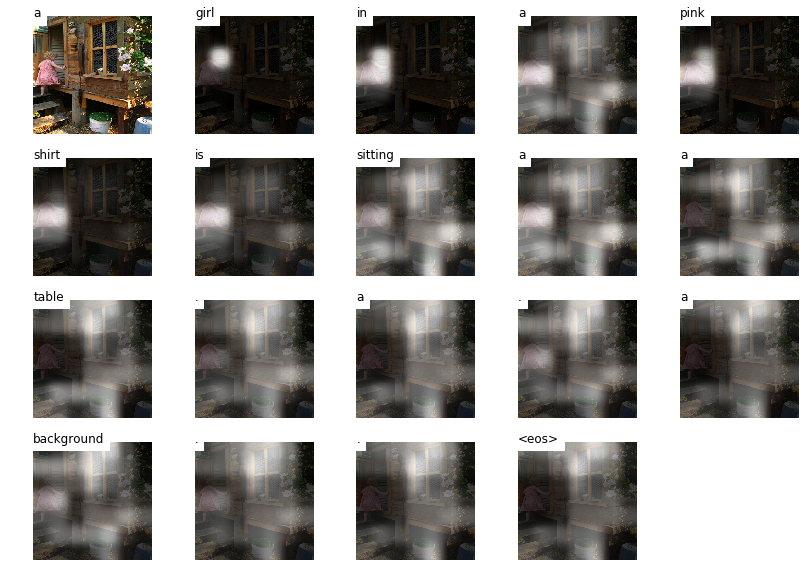

a black and is a white dog in on a mouth . a grass . <eos>
----------------------------------------------------------------------------------------------------


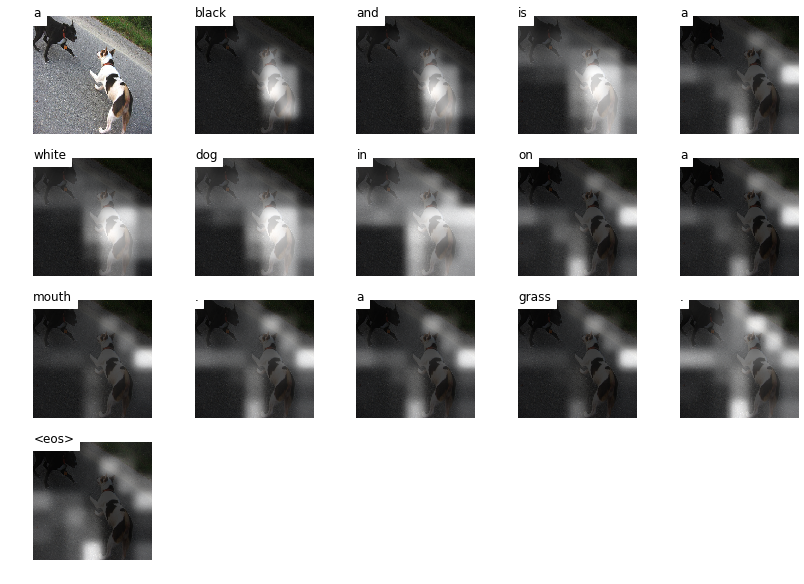

a is playing girl in a in on a of a red . . <eos>
----------------------------------------------------------------------------------------------------


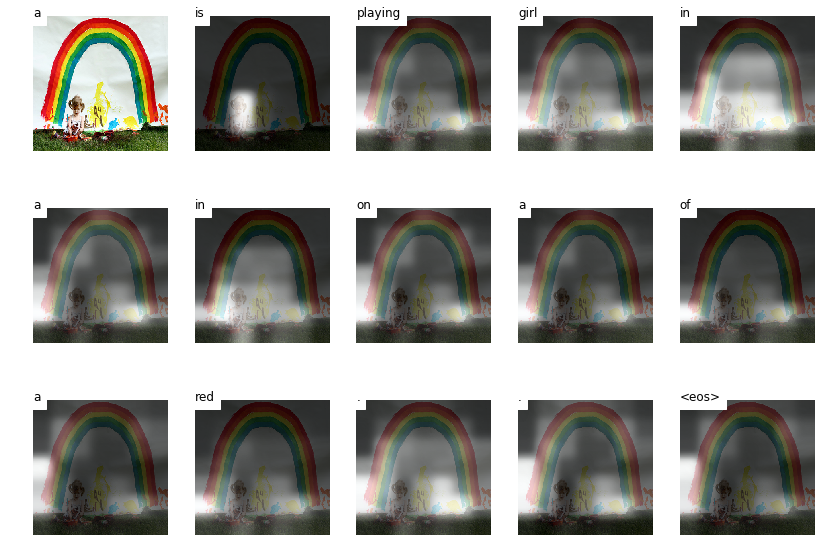

a and on a . a . a . on a .
----------------------------------------------------------------------------------------------------


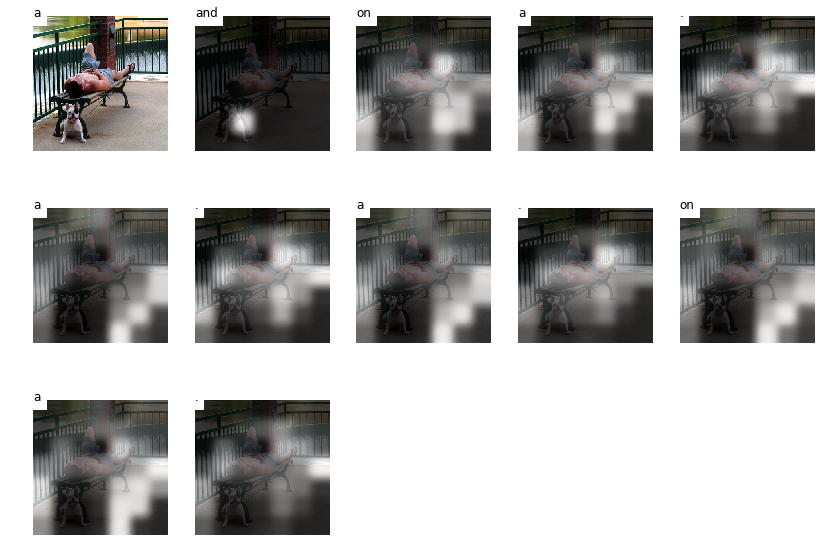

a man in a and standing a hat . . . . <eos>
----------------------------------------------------------------------------------------------------


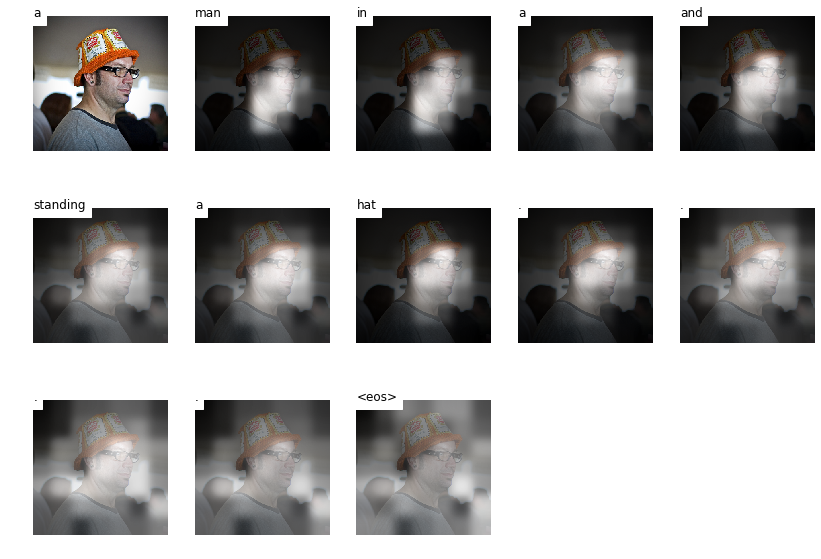

a boy boy in a a air shirt . a air . <eos>
----------------------------------------------------------------------------------------------------


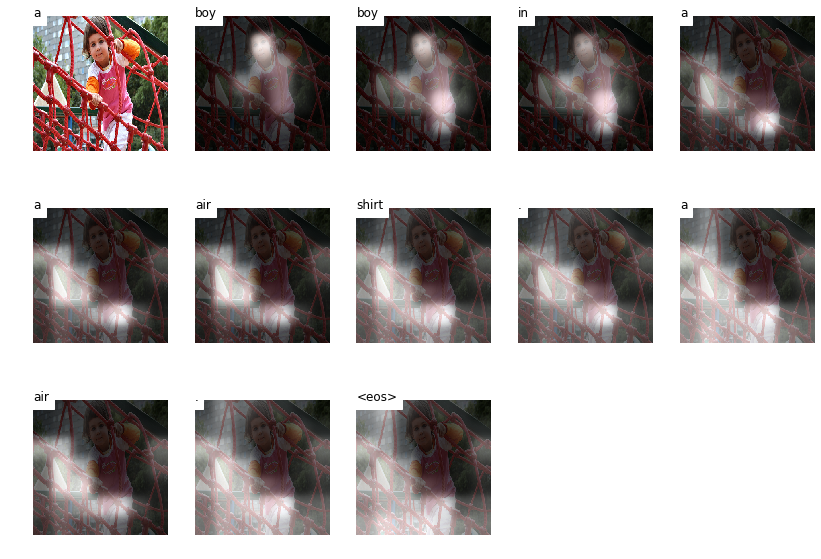

a dog dog and running on the grass . <eos>
----------------------------------------------------------------------------------------------------


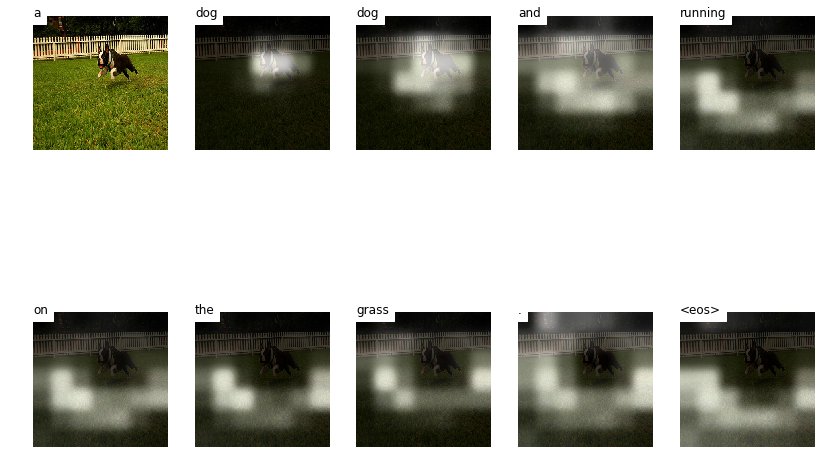

a dog is through a white ball . the water . a water . <eos>
----------------------------------------------------------------------------------------------------


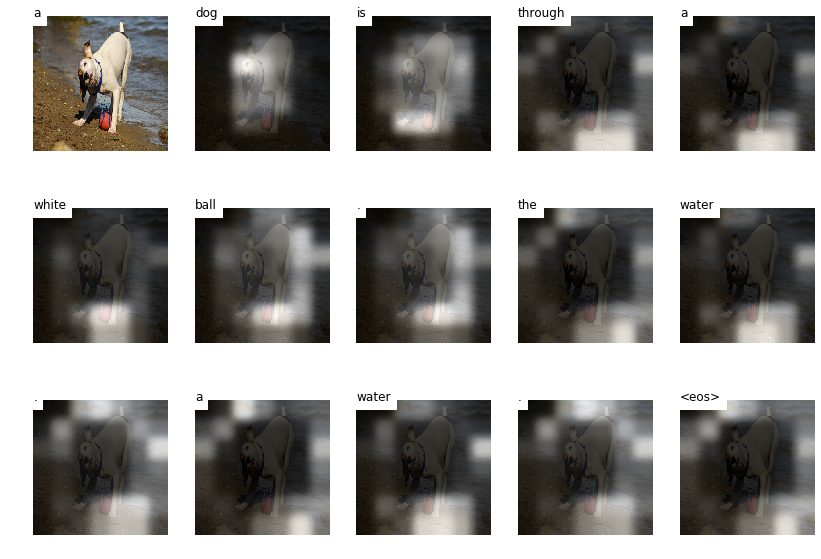

a young in on a of a wall . . the background . <eos>
----------------------------------------------------------------------------------------------------


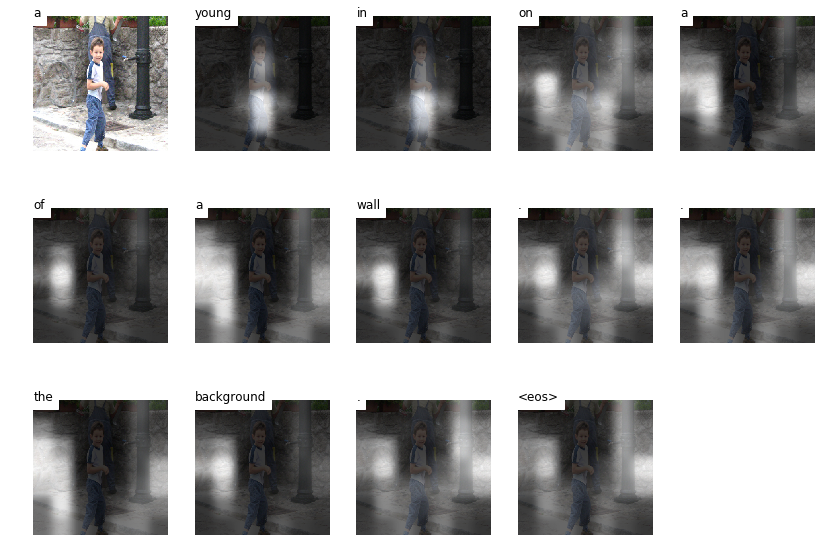

a dog dog is running in a large ball . <eos>
----------------------------------------------------------------------------------------------------


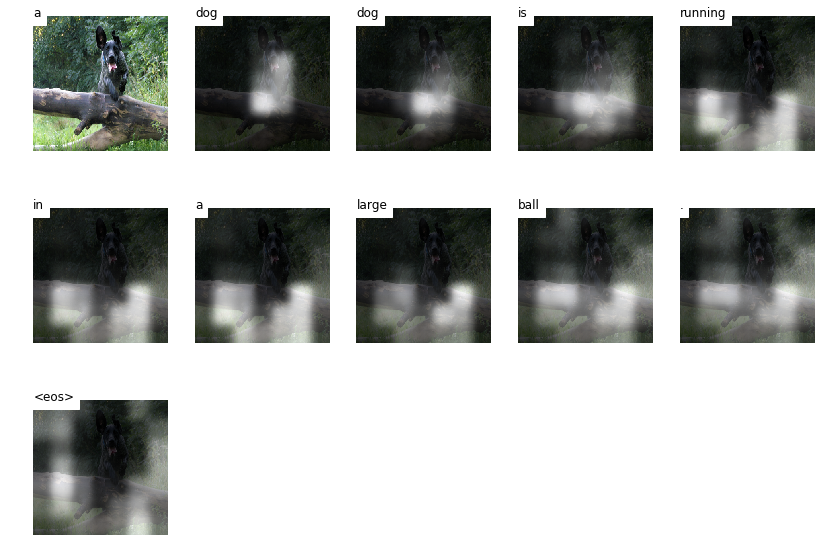

a white dog white dog is running in the snow . . . <eos>
----------------------------------------------------------------------------------------------------


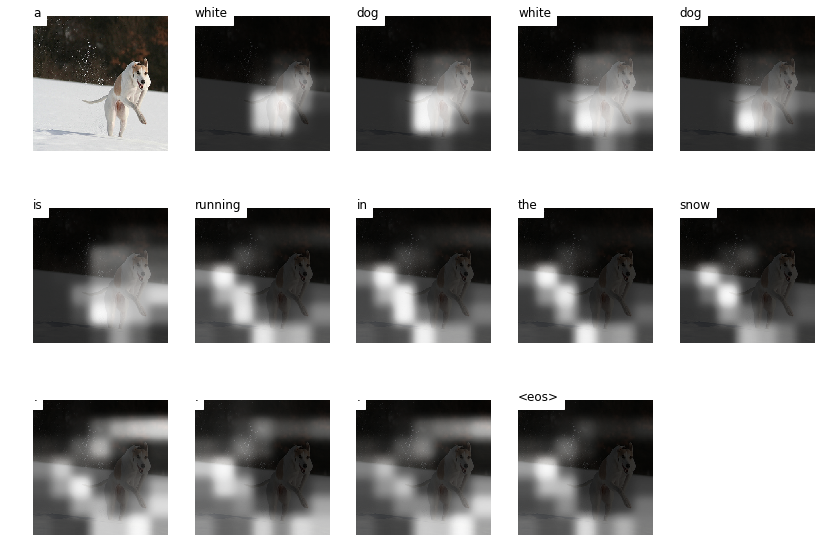

a man in a and on a . . . . the snow . <eos>
----------------------------------------------------------------------------------------------------


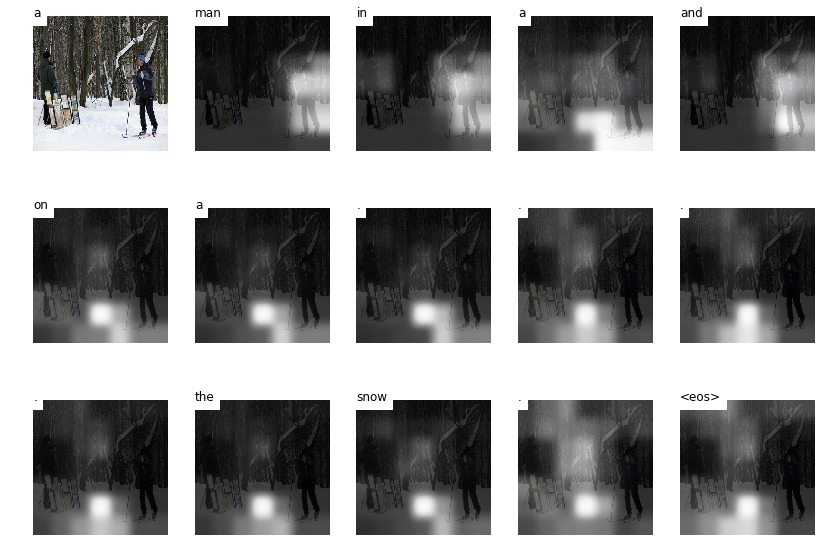

a man man a is is a rock . <eos>
----------------------------------------------------------------------------------------------------


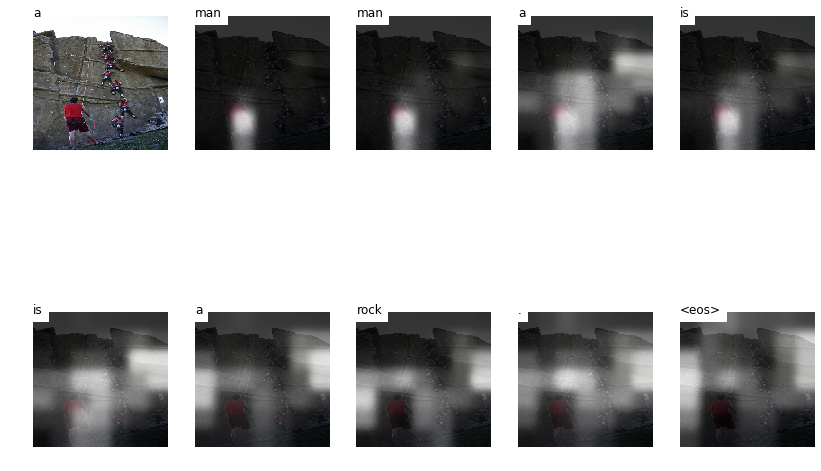

a brown dog is a grass . a grassy . a field . <eos>
----------------------------------------------------------------------------------------------------


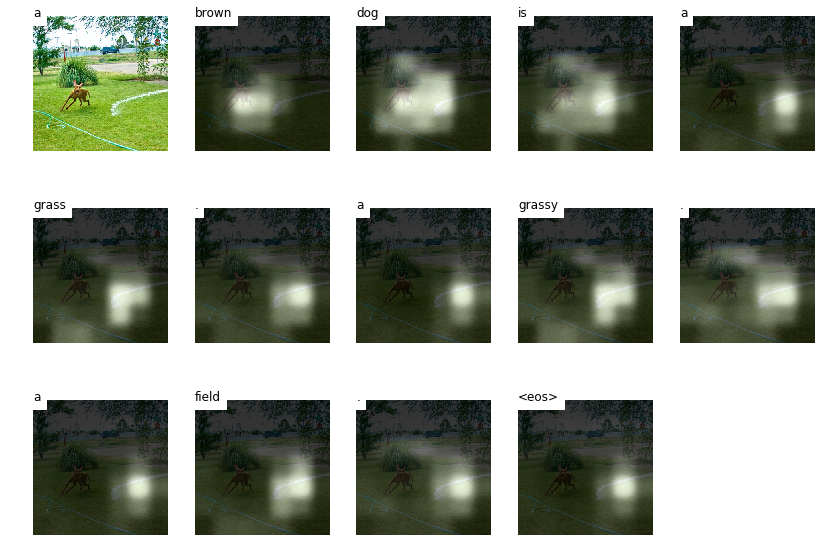

a white dog is running to a a ball ball . . the grass . <eos>
----------------------------------------------------------------------------------------------------


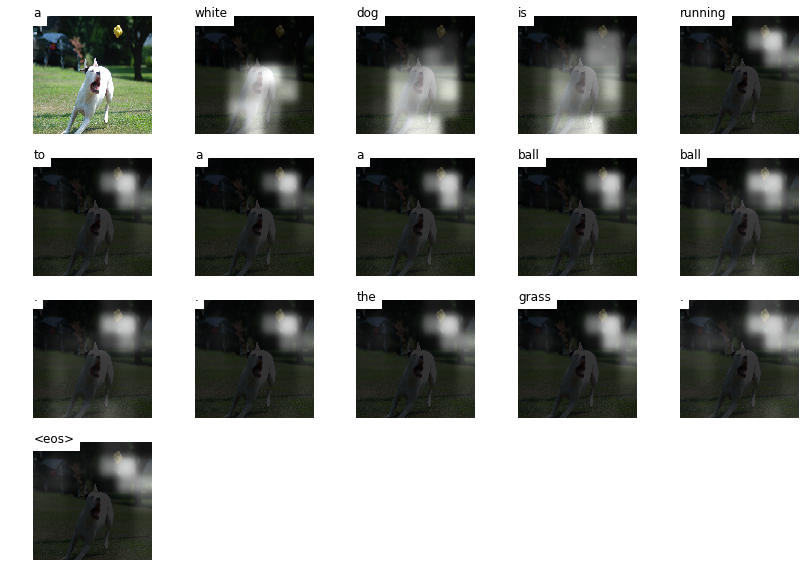

a white dog white dog is in a a field ball . <eos>
----------------------------------------------------------------------------------------------------


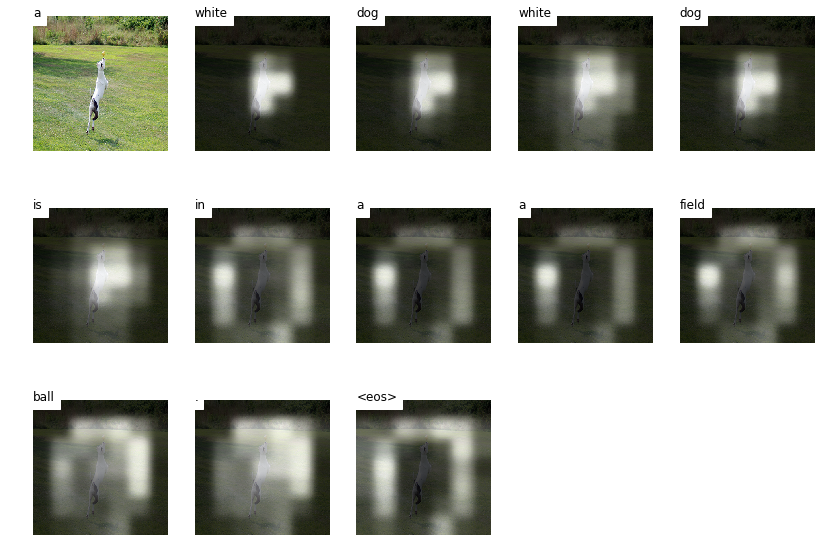

a man boy is a black shirt is in the . a water . a water of a . <eos>
----------------------------------------------------------------------------------------------------


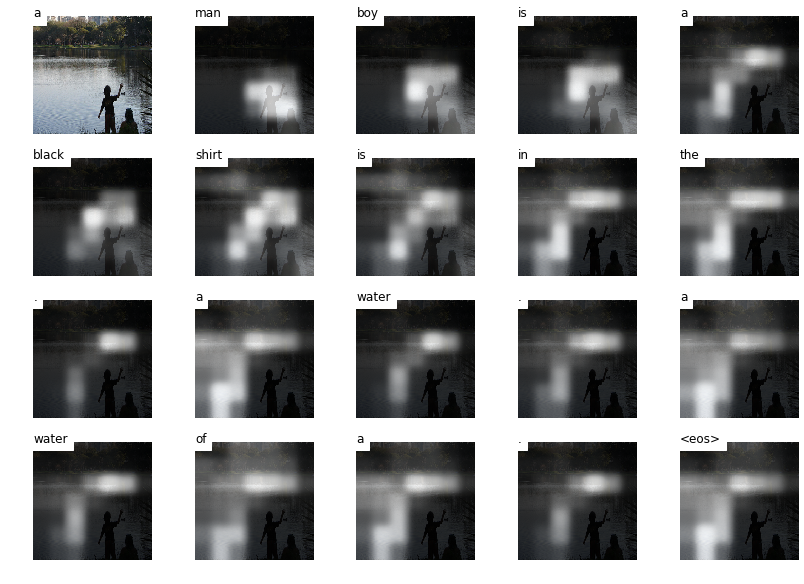

a man in a in a a picture . a camera of a man of a . <eos>
----------------------------------------------------------------------------------------------------


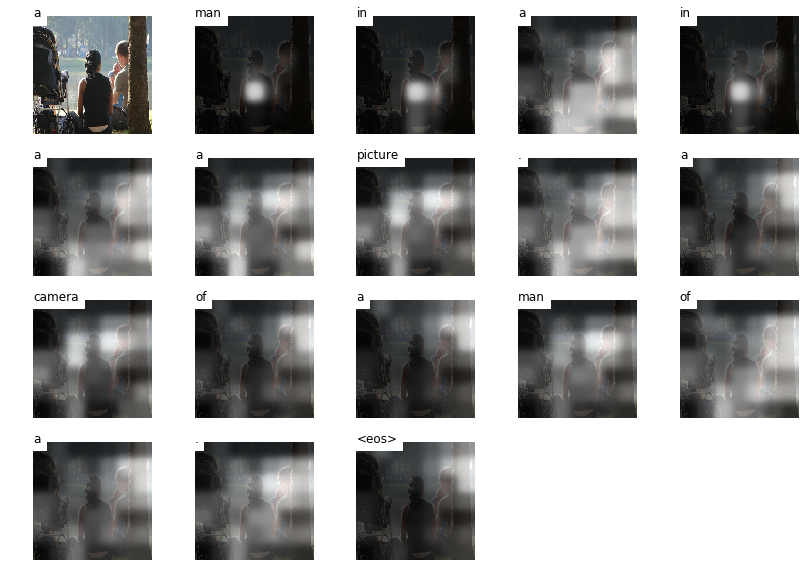

a black dog is a water water the water . <eos>
----------------------------------------------------------------------------------------------------


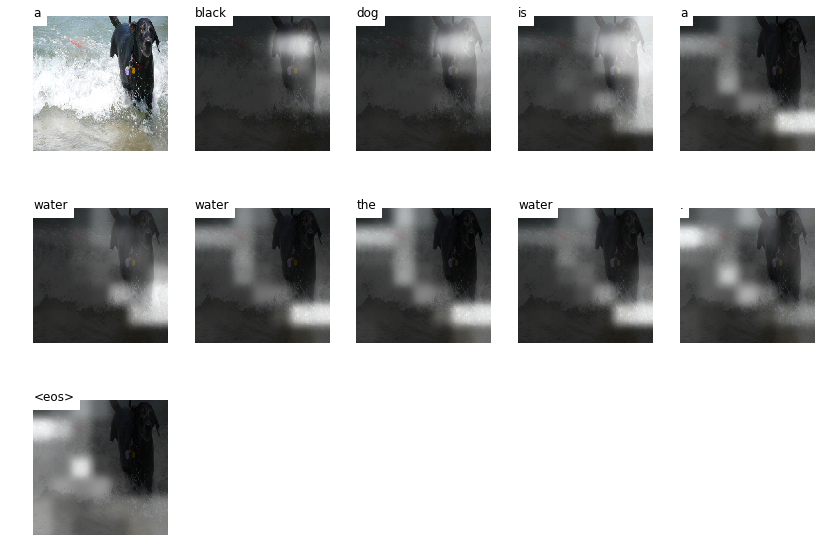

a man in standing a the air . . a red . <eos>
----------------------------------------------------------------------------------------------------


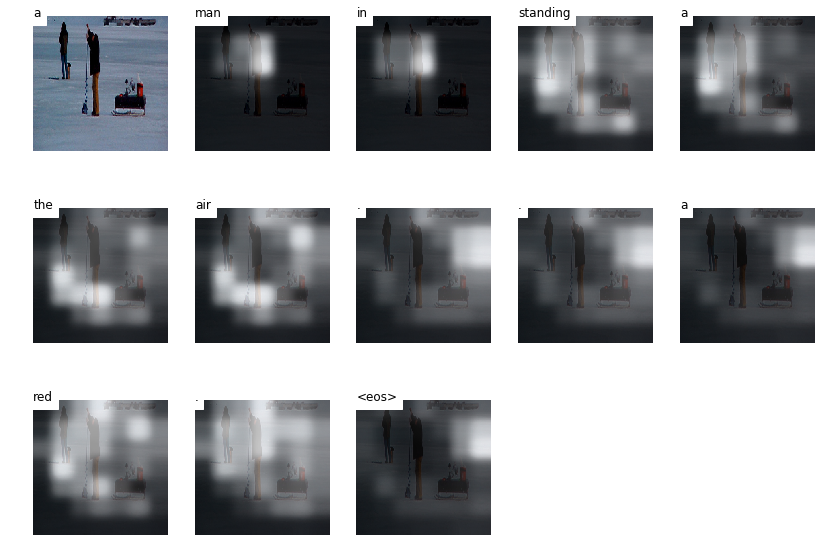

In [171]:
encoder.eval()
decoder.eval()

for i in range(20):
    image_path = os.path.join('./data/Flicker8k_Dataset/', dataset.test_ids[i])
    batch = dataset._getitem_by_img_id(dataset.test_ids[i])
    
    # unpack batch
    encoder_out = batch[0].to(device)
    encoded_captions = batch[1][0].to(device)
    caption_lengths = batch[1][1].to(device)

    predictions, encoded_captions, decode_lengths, alphas, sort_ind = decoder(
        encoder_out.unsqueeze(0), encoded_captions.unsqueeze(0), caption_lengths.unsqueeze(0)
    )
    text = pred2text(predictions[0].detach().numpy())
    print('='*100 + '\n' + text + '\n' + '-'*100)
    visualize_att(image_path, text, alphas[0].detach().numpy(), smooth=True)

In [172]:
%%time
n_epochs = 15
lr = 0.00001

total_loss = 0
decoder.train()
for epoch in range(n_epochs):
    for i, batch in enumerate(tqdm(dataloader)):
        # unpack batch
        encoder_out = batch[0].to(device)
        encoded_captions = batch[1][0].to(device)
        caption_lengths = batch[1][1].to(device)
        
        # forward
        predictions, encoded_captions, decode_lengths, alphas, sort_ind = decoder(
            encoder_out, encoded_captions, caption_lengths
        )
        
        # Since we decoded starting with <bos>, the targets are all words after <bos>, up to <eos>
        targets = encoded_captions[:, 1:]

        # Remove timesteps that we didn't decode at, or are pads
        # pack_padded_sequence is an easy trick to do this
        predictions, _ = pack_padded_sequence(predictions, decode_lengths, batch_first=True)
        targets, _ = pack_padded_sequence(targets, decode_lengths, batch_first=True)
        loss = criterion(predictions, targets)
        
        # optimize
        optimizer.zero_grad()
        loss.backward()
        
        # clip gradients using nn.utils.clip_grad_norm_ by `grad_clip` value
        nn.utils.clip_grad_norm_(decoder.parameters(), grad_clip)
        
        optimizer.step()
        total_loss += loss.item()

        if i % 10 == 0 and i != 0:
            total_loss = total_loss / 10
            print("[%d][loss:%5.2f][pp:%5.2f]" % (i, total_loss, np.exp(total_loss)))
            total_loss = 0

[10][loss: 3.68][pp:39.84]
[20][loss: 3.40][pp:29.93]
[30][loss: 3.33][pp:27.99]
[40][loss: 3.45][pp:31.62]
[50][loss: 3.37][pp:29.20]
[60][loss: 3.38][pp:29.35]
[70][loss: 3.31][pp:27.35]
[80][loss: 3.32][pp:27.63]
[90][loss: 3.33][pp:28.03]
[100][loss: 3.34][pp:28.25]
[110][loss: 3.26][pp:26.08]
[120][loss: 3.40][pp:29.93]
[130][loss: 3.42][pp:30.57]
[140][loss: 3.32][pp:27.77]
[150][loss: 3.36][pp:28.73]
[160][loss: 3.44][pp:31.07]
[170][loss: 3.28][pp:26.57]
[180][loss: 3.31][pp:27.49]
[190][loss: 3.35][pp:28.48]
[200][loss: 3.29][pp:26.82]
[210][loss: 3.31][pp:27.45]
[220][loss: 3.35][pp:28.53]
[230][loss: 3.23][pp:25.32]
[240][loss: 3.41][pp:30.15]
[250][loss: 3.26][pp:26.17]


[10][loss: 4.23][pp:69.04]
[20][loss: 3.34][pp:28.15]
[30][loss: 3.28][pp:26.45]
[40][loss: 3.18][pp:24.07]
[50][loss: 3.36][pp:28.69]
[60][loss: 3.36][pp:28.89]
[70][loss: 3.27][pp:26.39]
[80][loss: 3.37][pp:29.04]
[90][loss: 3.37][pp:29.11]
[100][loss: 3.31][pp:27.28]
[110][loss: 3.25][pp:25.69]
[120][loss: 3.26][pp:26.14]
[130][loss: 3.33][pp:27.82]
[140][loss: 3.38][pp:29.50]
[150][loss: 3.35][pp:28.59]
[160][loss: 3.34][pp:28.10]
[170][loss: 3.25][pp:25.69]
[180][loss: 3.26][pp:26.04]
[190][loss: 3.29][pp:26.82]
[200][loss: 3.29][pp:26.74]
[210][loss: 3.23][pp:25.22]
[220][loss: 3.24][pp:25.65]
[230][loss: 3.40][pp:29.90]
[240][loss: 3.35][pp:28.62]
[250][loss: 3.31][pp:27.52]


[10][loss: 4.27][pp:71.37]
[20][loss: 3.30][pp:27.09]
[30][loss: 3.27][pp:26.26]
[40][loss: 3.24][pp:25.54]
[50][loss: 3.23][pp:25.36]
[60][loss: 3.25][pp:25.78]
[70][loss: 3.34][pp:28.36]
[80][loss: 3.38][pp:29.32]
[90][loss: 3.33][pp:28.00]
[100][loss: 3.26][pp:26.10]
[110][loss: 3.32][pp:27.67]
[120][loss: 3.26][pp:26.09]
[130][loss: 3.26][pp:26.09]
[140][loss: 3.28][pp:26.59]
[150][loss: 3.25][pp:25.84]
[160][loss: 3.33][pp:27.80]
[170][loss: 3.30][pp:26.98]
[180][loss: 3.31][pp:27.35]
[190][loss: 3.29][pp:26.78]
[200][loss: 3.26][pp:26.04]
[210][loss: 3.26][pp:26.02]
[220][loss: 3.29][pp:26.80]
[230][loss: 3.27][pp:26.22]
[240][loss: 3.33][pp:27.96]
[250][loss: 3.31][pp:27.28]


[10][loss: 4.19][pp:65.71]
[20][loss: 3.20][pp:24.64]
[30][loss: 3.20][pp:24.64]
[40][loss: 3.31][pp:27.42]
[50][loss: 3.28][pp:26.57]
[60][loss: 3.30][pp:27.05]
[70][loss: 3.14][pp:23.05]
[80][loss: 3.29][pp:26.78]
[90][loss: 3.30][pp:26.99]
[100][loss: 3.26][pp:26.09]
[110][loss: 3.20][pp:24.50]
[120][loss: 3.23][pp:25.34]
[130][loss: 3.29][pp:26.95]
[140][loss: 3.32][pp:27.59]
[150][loss: 3.30][pp:27.20]
[160][loss: 3.29][pp:26.84]
[170][loss: 3.20][pp:24.65]
[180][loss: 3.25][pp:25.90]
[190][loss: 3.32][pp:27.78]
[200][loss: 3.18][pp:24.05]
[210][loss: 3.18][pp:24.03]
[220][loss: 3.31][pp:27.41]
[230][loss: 3.26][pp:26.05]
[240][loss: 3.25][pp:25.77]
[250][loss: 3.16][pp:23.57]


[10][loss: 4.31][pp:74.11]
[20][loss: 3.14][pp:23.14]
[30][loss: 3.21][pp:24.67]
[40][loss: 3.23][pp:25.27]
[50][loss: 3.27][pp:26.39]
[60][loss: 3.44][pp:31.33]
[70][loss: 3.26][pp:25.95]
[80][loss: 3.22][pp:24.99]
[90][loss: 3.28][pp:26.62]
[100][loss: 3.18][pp:24.14]
[110][loss: 3.18][pp:24.01]
[120][loss: 3.20][pp:24.49]
[130][loss: 3.20][pp:24.64]
[140][loss: 3.25][pp:25.67]
[150][loss: 3.28][pp:26.52]
[160][loss: 3.22][pp:25.00]
[170][loss: 3.25][pp:25.67]
[180][loss: 3.22][pp:25.08]
[190][loss: 3.19][pp:24.23]
[200][loss: 3.26][pp:26.06]
[210][loss: 3.22][pp:24.91]
[220][loss: 3.14][pp:23.17]
[230][loss: 3.18][pp:23.93]
[240][loss: 3.20][pp:24.51]
[250][loss: 3.26][pp:26.12]


[10][loss: 4.16][pp:64.17]
[20][loss: 3.32][pp:27.55]
[30][loss: 3.23][pp:25.22]
[40][loss: 3.21][pp:24.89]
[50][loss: 3.25][pp:25.70]
[60][loss: 3.18][pp:24.10]
[70][loss: 3.20][pp:24.62]
[80][loss: 3.20][pp:24.53]
[90][loss: 3.10][pp:22.24]
[100][loss: 3.16][pp:23.57]
[110][loss: 3.23][pp:25.26]
[120][loss: 3.13][pp:22.85]
[130][loss: 3.19][pp:24.40]
[140][loss: 3.22][pp:24.97]
[150][loss: 3.22][pp:25.12]
[160][loss: 3.32][pp:27.60]
[170][loss: 3.16][pp:23.66]
[180][loss: 3.17][pp:23.74]
[190][loss: 3.19][pp:24.27]
[200][loss: 3.10][pp:22.27]
[210][loss: 3.13][pp:22.81]
[220][loss: 3.13][pp:22.98]
[230][loss: 3.16][pp:23.51]
[240][loss: 3.18][pp:23.96]
[250][loss: 3.24][pp:25.60]


[10][loss: 4.01][pp:54.98]
[20][loss: 3.23][pp:25.39]
[30][loss: 3.23][pp:25.22]
[40][loss: 3.15][pp:23.42]
[50][loss: 3.26][pp:26.15]
[60][loss: 3.18][pp:24.11]
[70][loss: 3.13][pp:22.92]
[80][loss: 3.22][pp:25.06]
[90][loss: 3.17][pp:23.73]
[100][loss: 3.22][pp:25.02]
[110][loss: 3.14][pp:23.16]
[120][loss: 3.24][pp:25.59]
[130][loss: 3.30][pp:26.99]
[140][loss: 3.11][pp:22.34]
[150][loss: 3.23][pp:25.26]
[160][loss: 3.23][pp:25.30]
[170][loss: 3.24][pp:25.45]
[180][loss: 3.20][pp:24.44]
[190][loss: 3.18][pp:24.07]
[200][loss: 3.17][pp:23.71]
[210][loss: 3.18][pp:24.10]
[220][loss: 3.12][pp:22.56]
[230][loss: 3.12][pp:22.65]
[240][loss: 3.22][pp:25.08]
[250][loss: 3.22][pp:24.91]


[10][loss: 4.12][pp:61.76]
[20][loss: 3.17][pp:23.88]
[30][loss: 3.17][pp:23.71]
[40][loss: 3.13][pp:22.94]
[50][loss: 3.16][pp:23.47]
[60][loss: 3.11][pp:22.40]
[70][loss: 3.14][pp:23.12]
[80][loss: 3.14][pp:23.05]
[90][loss: 3.19][pp:24.34]
[100][loss: 3.18][pp:24.09]
[110][loss: 3.06][pp:21.25]
[120][loss: 3.19][pp:24.31]
[130][loss: 3.14][pp:23.06]
[140][loss: 3.17][pp:23.90]
[150][loss: 3.11][pp:22.49]
[160][loss: 3.23][pp:25.25]
[170][loss: 3.18][pp:24.08]
[180][loss: 3.30][pp:27.17]
[190][loss: 3.16][pp:23.54]
[200][loss: 3.22][pp:24.99]
[210][loss: 3.19][pp:24.21]
[220][loss: 3.14][pp:23.14]
[230][loss: 3.15][pp:23.40]
[240][loss: 3.16][pp:23.50]
[250][loss: 3.08][pp:21.66]


[10][loss: 4.20][pp:66.63]
[20][loss: 3.12][pp:22.54]
[30][loss: 3.12][pp:22.70]
[40][loss: 3.09][pp:21.97]
[50][loss: 3.18][pp:24.04]
[60][loss: 3.20][pp:24.64]
[70][loss: 3.29][pp:26.76]
[80][loss: 3.09][pp:21.93]
[90][loss: 3.14][pp:23.14]
[100][loss: 3.26][pp:25.95]
[110][loss: 3.18][pp:23.94]
[120][loss: 3.13][pp:22.96]
[130][loss: 3.14][pp:23.02]
[140][loss: 3.07][pp:21.45]
[150][loss: 3.08][pp:21.69]
[160][loss: 3.13][pp:22.91]
[170][loss: 3.21][pp:24.81]
[180][loss: 3.16][pp:23.52]
[190][loss: 3.26][pp:26.15]
[200][loss: 3.12][pp:22.64]
[210][loss: 3.16][pp:23.53]
[220][loss: 3.16][pp:23.49]
[230][loss: 3.13][pp:22.82]
[240][loss: 3.10][pp:22.21]
[250][loss: 3.20][pp:24.64]


[10][loss: 4.06][pp:58.04]
[20][loss: 3.11][pp:22.31]
[30][loss: 3.14][pp:23.03]
[40][loss: 3.14][pp:23.07]
[50][loss: 3.08][pp:21.73]
[60][loss: 3.18][pp:24.10]
[70][loss: 3.13][pp:22.91]
[80][loss: 3.04][pp:20.96]
[90][loss: 3.11][pp:22.37]
[100][loss: 3.16][pp:23.57]
[110][loss: 3.09][pp:21.94]
[120][loss: 3.15][pp:23.42]
[130][loss: 3.07][pp:21.63]
[140][loss: 3.14][pp:23.11]
[150][loss: 3.10][pp:22.22]
[160][loss: 3.12][pp:22.71]
[170][loss: 3.14][pp:23.05]
[180][loss: 3.10][pp:22.18]
[190][loss: 3.07][pp:21.52]
[200][loss: 3.14][pp:23.03]
[210][loss: 3.16][pp:23.61]
[220][loss: 3.19][pp:24.41]
[230][loss: 3.08][pp:21.81]
[240][loss: 3.06][pp:21.34]
[250][loss: 3.13][pp:22.80]


[10][loss: 4.03][pp:56.06]
[20][loss: 3.06][pp:21.42]
[30][loss: 3.10][pp:22.19]
[40][loss: 3.01][pp:20.37]
[50][loss: 3.07][pp:21.48]
[60][loss: 3.06][pp:21.37]
[70][loss: 3.11][pp:22.33]
[80][loss: 3.06][pp:21.26]
[90][loss: 3.08][pp:21.70]
[100][loss: 3.23][pp:25.32]
[110][loss: 3.09][pp:21.88]
[120][loss: 3.12][pp:22.67]
[130][loss: 3.11][pp:22.40]
[140][loss: 3.14][pp:23.17]
[150][loss: 3.07][pp:21.53]
[160][loss: 3.03][pp:20.69]
[170][loss: 3.12][pp:22.71]
[180][loss: 3.00][pp:20.05]
[190][loss: 3.14][pp:23.02]
[200][loss: 3.01][pp:20.20]
[210][loss: 3.14][pp:23.11]
[220][loss: 3.06][pp:21.27]
[230][loss: 3.10][pp:22.18]
[240][loss: 3.18][pp:24.06]
[250][loss: 3.12][pp:22.70]


[10][loss: 3.98][pp:53.58]
[20][loss: 3.05][pp:21.13]
[30][loss: 3.12][pp:22.69]
[40][loss: 3.09][pp:21.99]
[50][loss: 3.05][pp:21.10]
[60][loss: 3.05][pp:21.03]
[70][loss: 3.17][pp:23.82]
[80][loss: 3.15][pp:23.22]
[90][loss: 3.04][pp:20.93]
[100][loss: 3.05][pp:21.17]
[110][loss: 3.18][pp:24.14]
[120][loss: 3.02][pp:20.41]
[130][loss: 3.01][pp:20.30]
[140][loss: 3.09][pp:21.97]
[150][loss: 3.17][pp:23.87]
[160][loss: 3.13][pp:22.86]
[170][loss: 3.12][pp:22.63]
[180][loss: 3.08][pp:21.70]
[190][loss: 3.08][pp:21.76]
[200][loss: 3.08][pp:21.81]
[210][loss: 3.12][pp:22.76]
[220][loss: 3.05][pp:21.16]
[230][loss: 3.14][pp:23.09]
[240][loss: 3.12][pp:22.74]
[250][loss: 2.97][pp:19.49]


[10][loss: 3.93][pp:51.10]
[20][loss: 3.06][pp:21.37]
[30][loss: 3.08][pp:21.81]
[40][loss: 2.96][pp:19.24]
[50][loss: 3.22][pp:25.03]
[60][loss: 3.01][pp:20.39]
[70][loss: 3.07][pp:21.55]
[80][loss: 3.04][pp:20.95]
[90][loss: 3.06][pp:21.33]
[100][loss: 3.07][pp:21.57]
[110][loss: 3.01][pp:20.19]
[120][loss: 3.05][pp:21.03]
[130][loss: 3.06][pp:21.38]
[140][loss: 3.11][pp:22.47]
[150][loss: 3.08][pp:21.77]
[160][loss: 3.10][pp:22.31]
[170][loss: 3.11][pp:22.40]
[180][loss: 3.08][pp:21.67]
[190][loss: 3.05][pp:21.13]
[200][loss: 3.09][pp:21.95]
[210][loss: 3.11][pp:22.40]
[220][loss: 3.05][pp:21.05]
[230][loss: 3.05][pp:21.12]
[240][loss: 3.04][pp:20.96]
[250][loss: 3.03][pp:20.78]


[10][loss: 3.98][pp:53.47]
[20][loss: 3.02][pp:20.44]
[30][loss: 2.98][pp:19.62]
[40][loss: 3.01][pp:20.20]
[50][loss: 3.05][pp:21.10]
[60][loss: 3.02][pp:20.46]
[70][loss: 2.96][pp:19.24]
[80][loss: 2.97][pp:19.44]
[90][loss: 3.15][pp:23.34]
[100][loss: 3.03][pp:20.76]
[110][loss: 3.03][pp:20.71]
[120][loss: 2.93][pp:18.82]
[130][loss: 3.09][pp:21.97]
[140][loss: 3.02][pp:20.48]
[150][loss: 2.98][pp:19.64]
[160][loss: 3.08][pp:21.78]
[170][loss: 3.13][pp:22.76]
[180][loss: 3.11][pp:22.45]
[190][loss: 3.04][pp:20.97]
[200][loss: 3.06][pp:21.34]
[210][loss: 3.07][pp:21.45]
[220][loss: 2.98][pp:19.66]
[230][loss: 2.96][pp:19.22]
[240][loss: 3.07][pp:21.63]
[250][loss: 2.98][pp:19.67]


[10][loss: 3.97][pp:53.17]
[20][loss: 3.06][pp:21.30]
[30][loss: 3.05][pp:21.04]
[40][loss: 3.04][pp:20.80]
[50][loss: 3.01][pp:20.30]
[60][loss: 3.02][pp:20.56]
[70][loss: 3.05][pp:21.03]
[80][loss: 3.01][pp:20.25]
[90][loss: 3.01][pp:20.23]
[100][loss: 3.10][pp:22.23]
[110][loss: 2.96][pp:19.27]
[120][loss: 3.06][pp:21.30]
[130][loss: 3.01][pp:20.36]
[140][loss: 2.98][pp:19.69]
[150][loss: 3.07][pp:21.63]
[160][loss: 3.04][pp:20.81]
[170][loss: 2.96][pp:19.32]
[180][loss: 2.95][pp:19.10]
[190][loss: 2.99][pp:19.98]
[200][loss: 2.95][pp:19.05]
[210][loss: 3.08][pp:21.79]
[220][loss: 2.97][pp:19.42]
[230][loss: 3.03][pp:20.68]
[240][loss: 3.00][pp:20.10]
[250][loss: 3.01][pp:20.24]
CPU times: user 6h 51min 27s, sys: 1h 6min 27s, total: 7h 57min 55s
Wall time: 4h 52min 53s


a girl in a pink dress is sitting a a table of a . front background . . <eos>
----------------------------------------------------------------------------------------------------


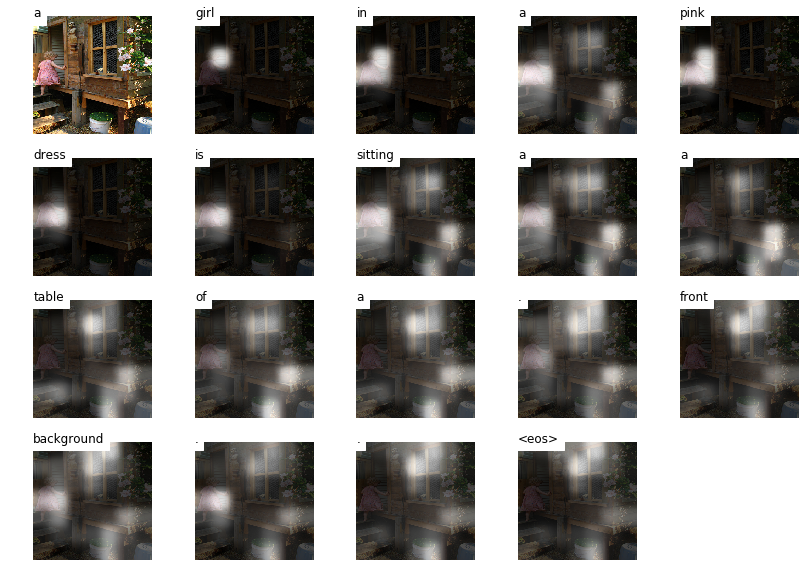

two black and is a black dog is a dog is running on the other . the background . <eos>
----------------------------------------------------------------------------------------------------


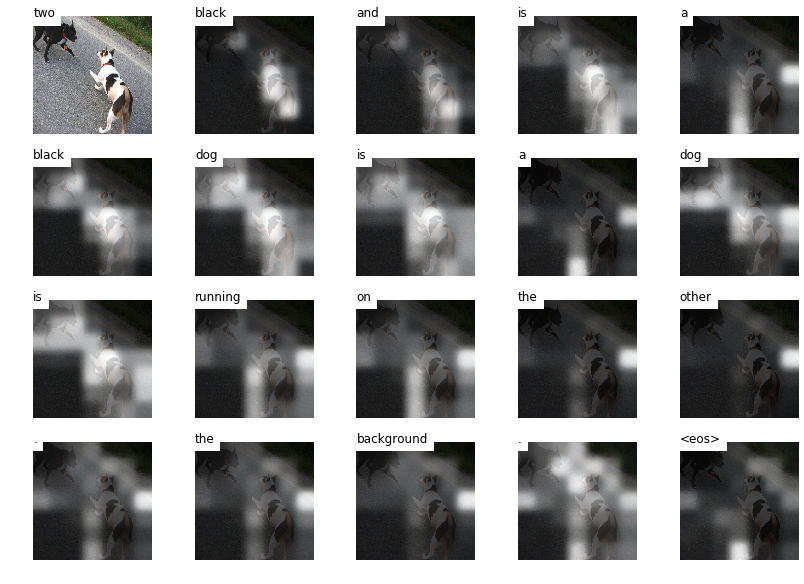

a is playing girl in a in on a of a red . . <eos>
----------------------------------------------------------------------------------------------------


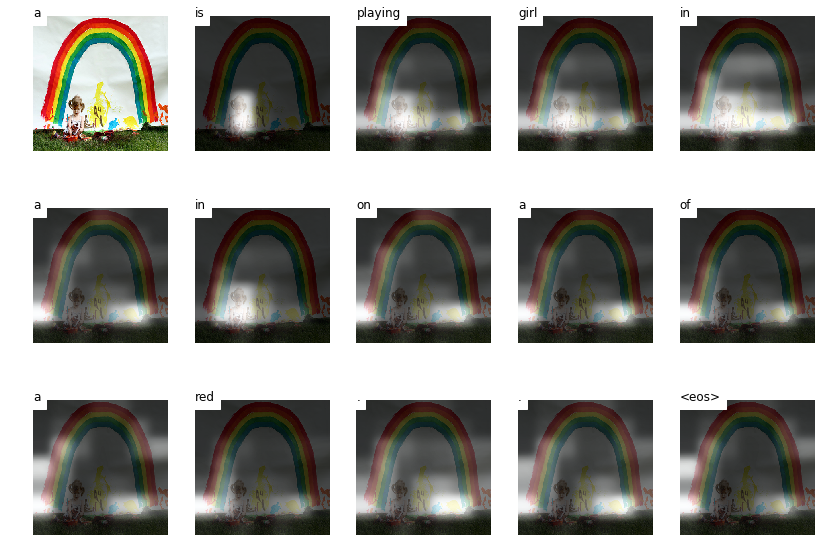

a dog dog is on a blue . . a dog . <eos>
----------------------------------------------------------------------------------------------------


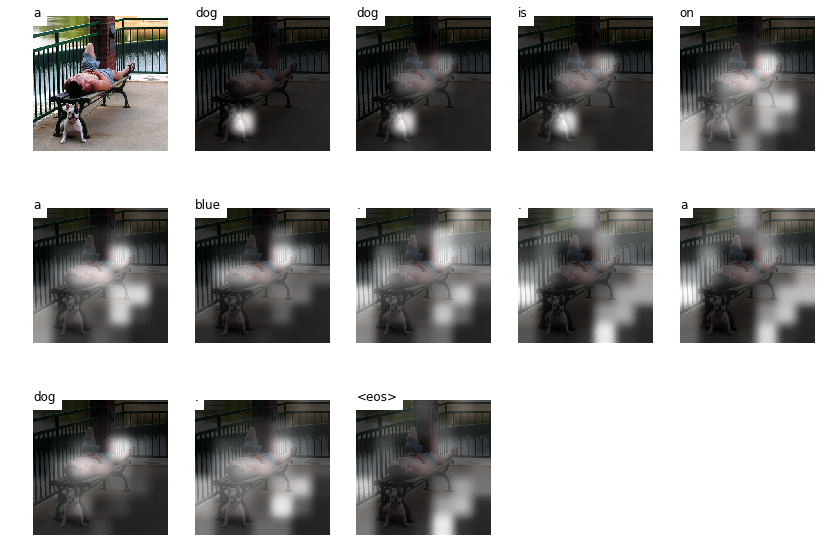

a man with a hat and holding a and a hat hat . <eos>
----------------------------------------------------------------------------------------------------


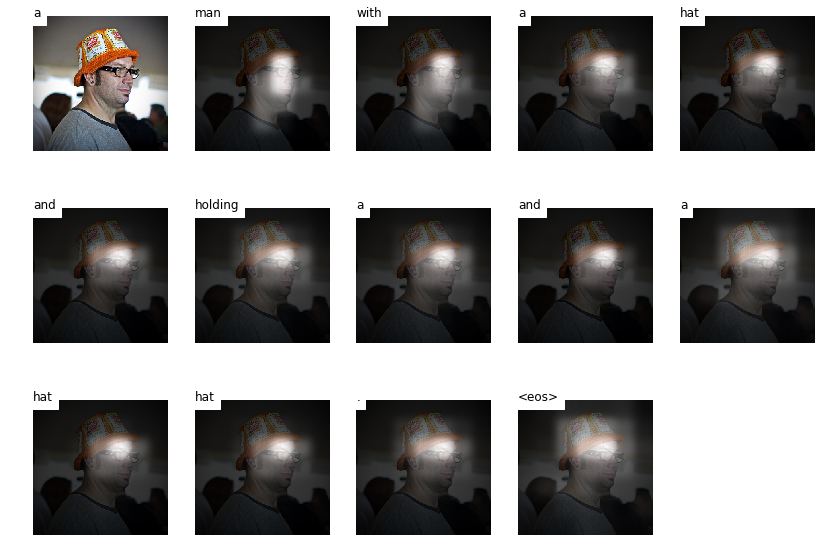

a young boy in a a swing swing . a red . <eos>
----------------------------------------------------------------------------------------------------


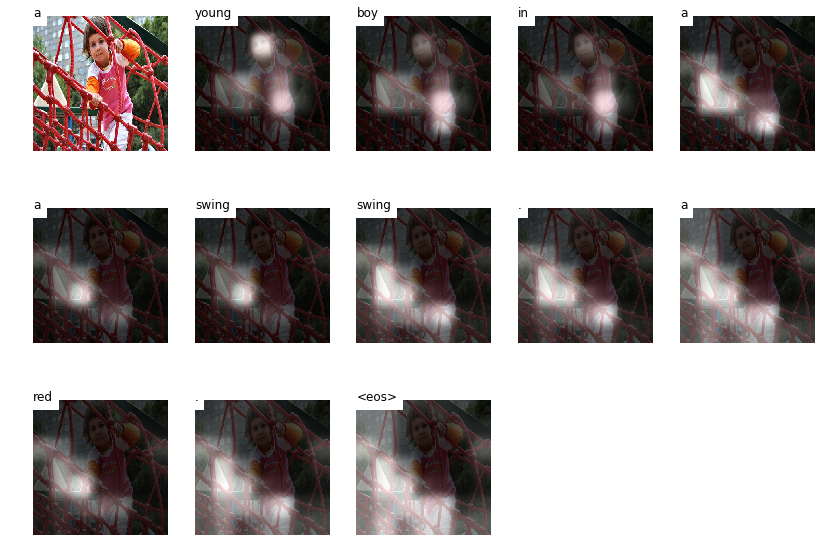

a dog dog and running through a grass grass . the of a field dog . <eos>
----------------------------------------------------------------------------------------------------


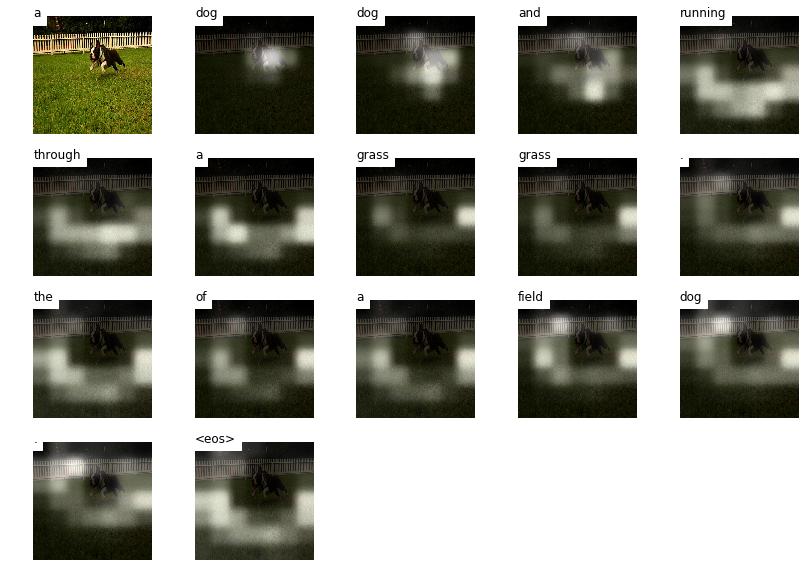

a dog is with a white ball in a sand . a beach . <eos>
----------------------------------------------------------------------------------------------------


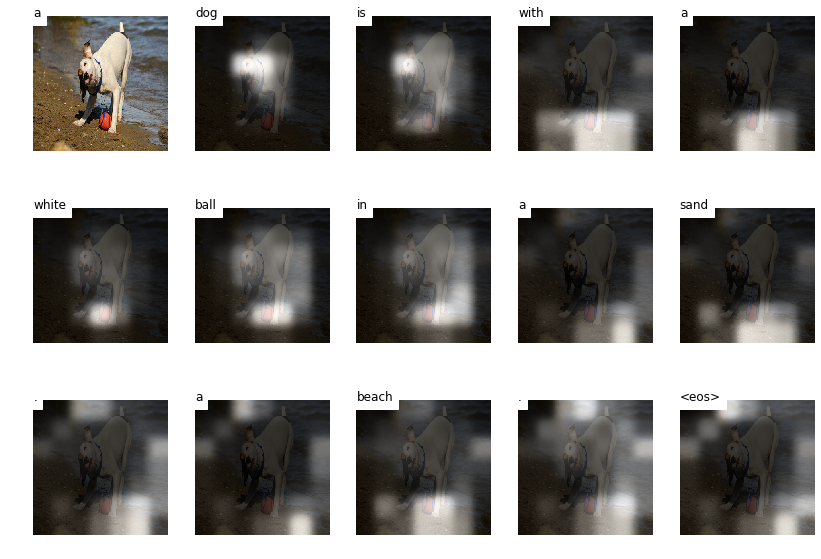

a boy in a shirt and a shirt and a of a . . a in a . a . <eos>
----------------------------------------------------------------------------------------------------


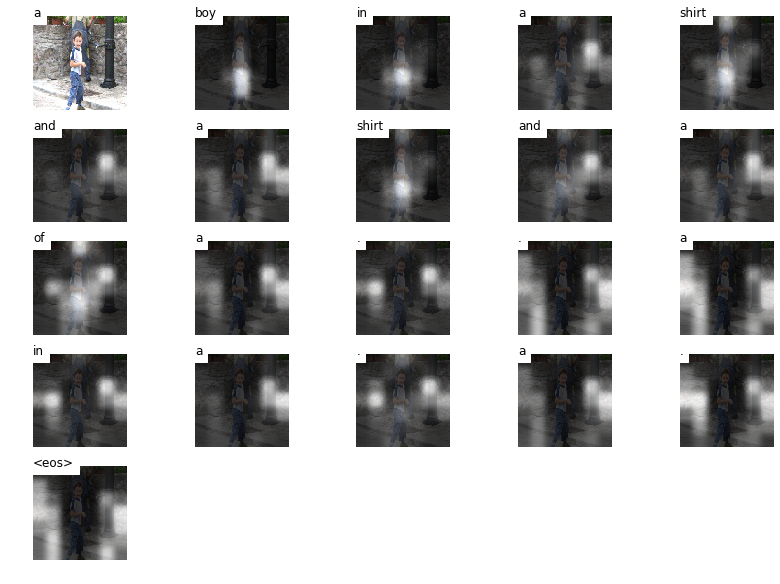

a dog dog is running on a tree tree . <eos>
----------------------------------------------------------------------------------------------------


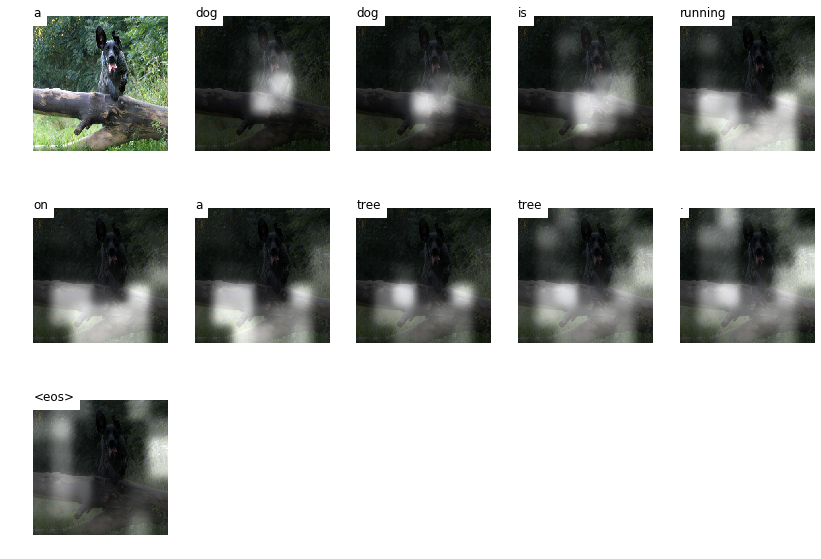

a white dog white dog is running through the snow . . . <eos>
----------------------------------------------------------------------------------------------------


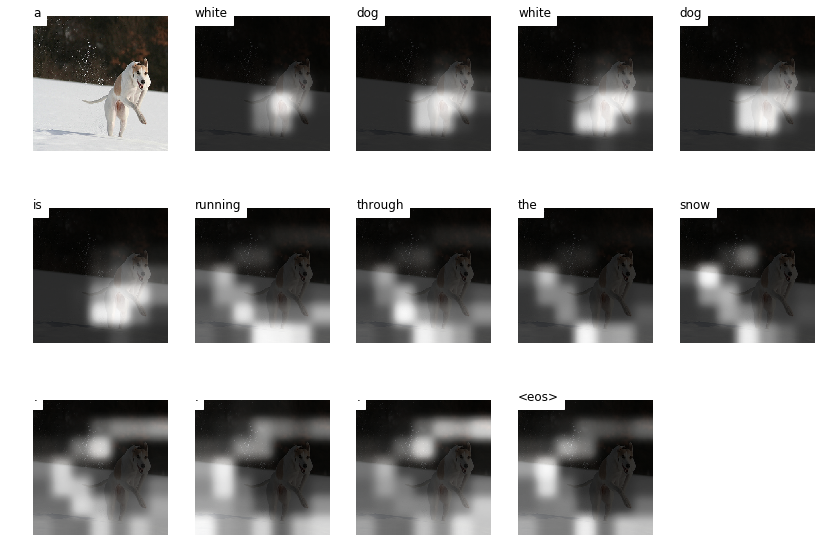

a group in a and on a . . . . the snow . <eos>
----------------------------------------------------------------------------------------------------


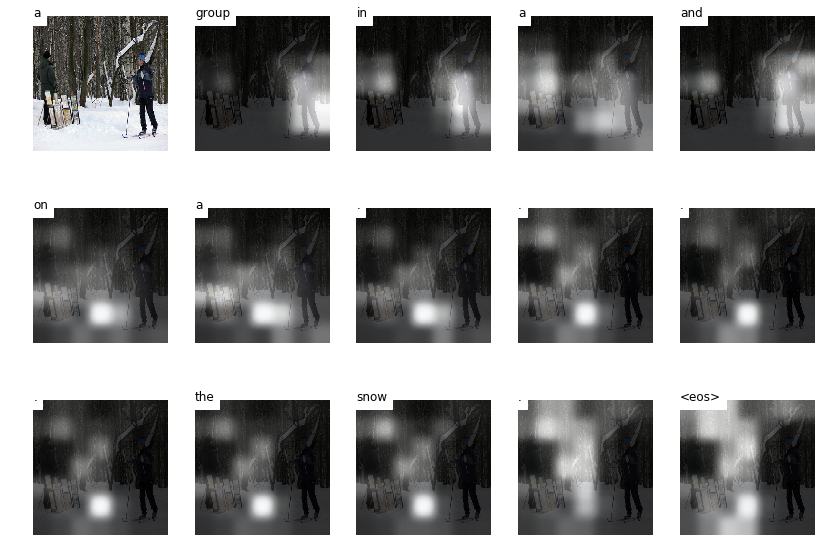

a man man a man is a rock . <eos>
----------------------------------------------------------------------------------------------------


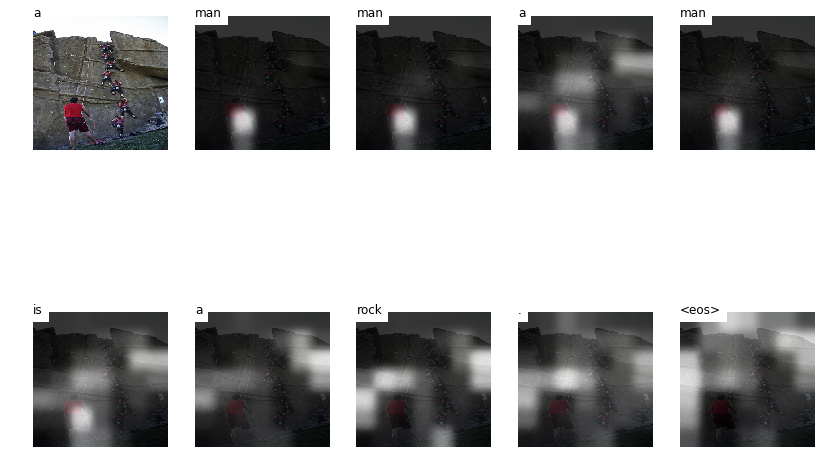

a dog dog is a ball in a tennis . a grassy . <eos>
----------------------------------------------------------------------------------------------------


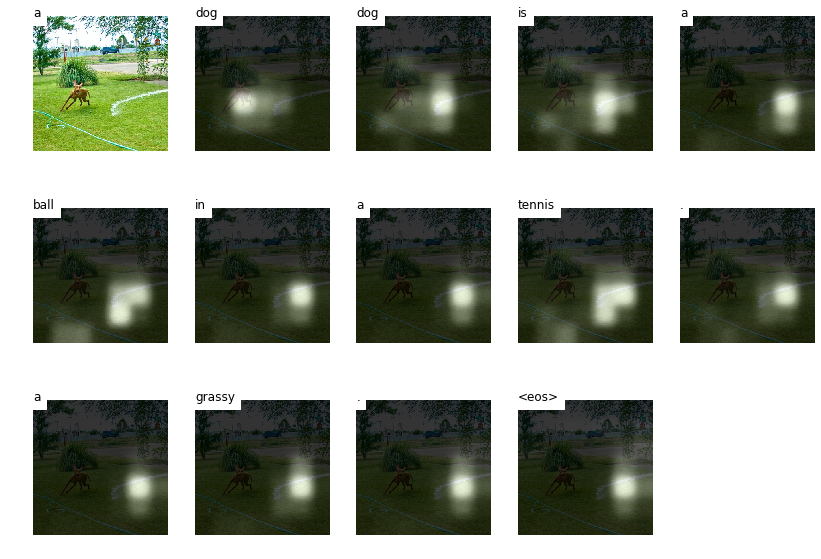

a white is to catch a ball ball in the red . a . . <eos>
----------------------------------------------------------------------------------------------------


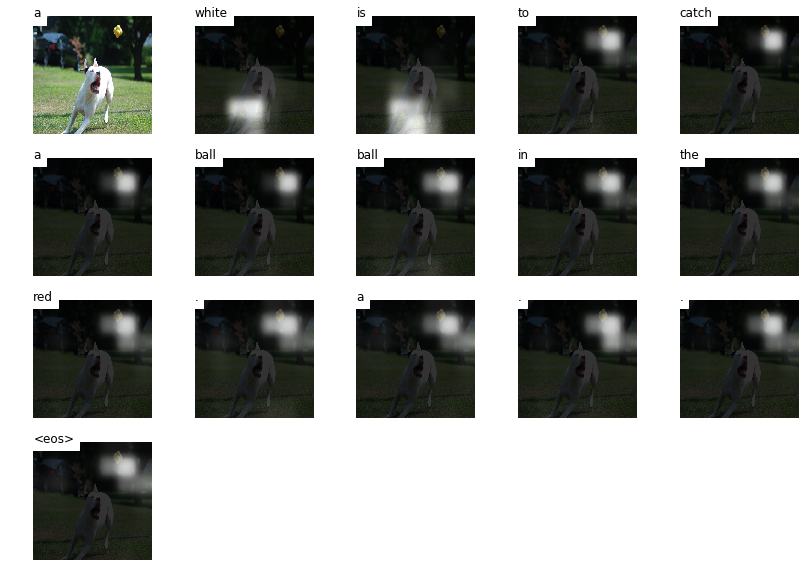

a white dog is running in the field field . a white shirt . <eos>
----------------------------------------------------------------------------------------------------


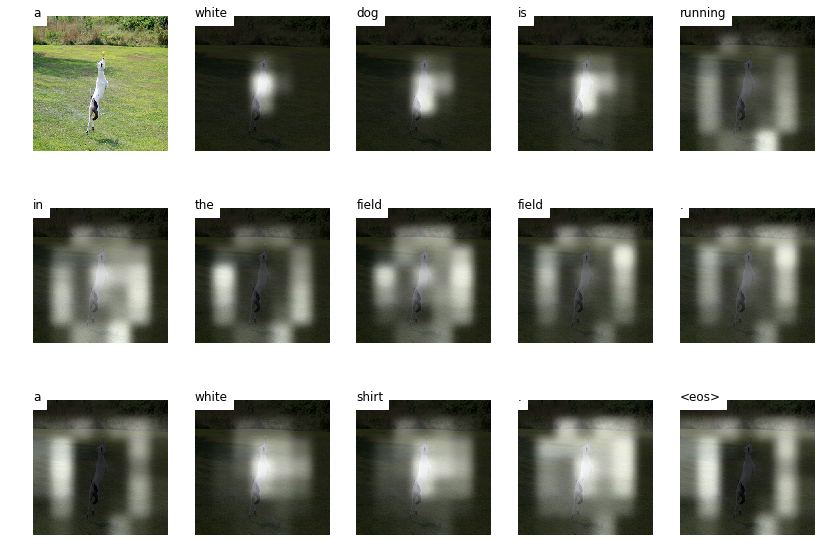

a man is a boy in jumping a . of the lake lake . <eos>
----------------------------------------------------------------------------------------------------


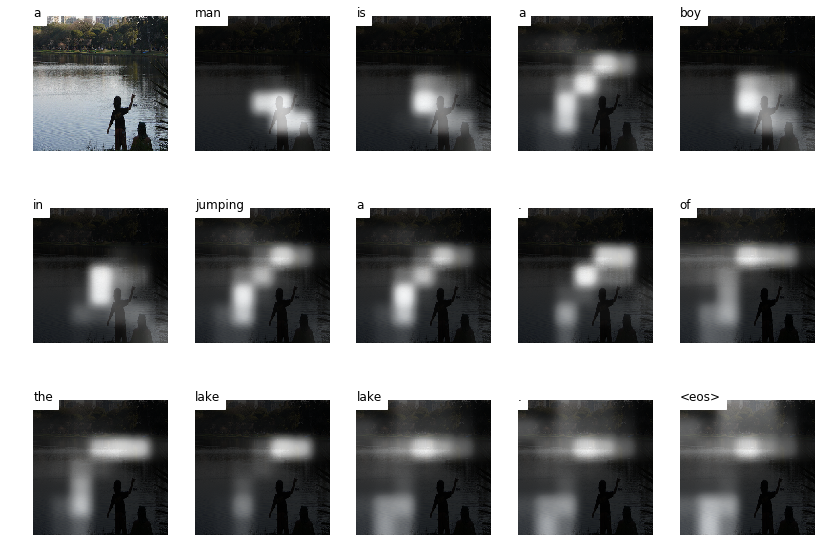

a man of a people people on on a picture . a man . <eos>
----------------------------------------------------------------------------------------------------


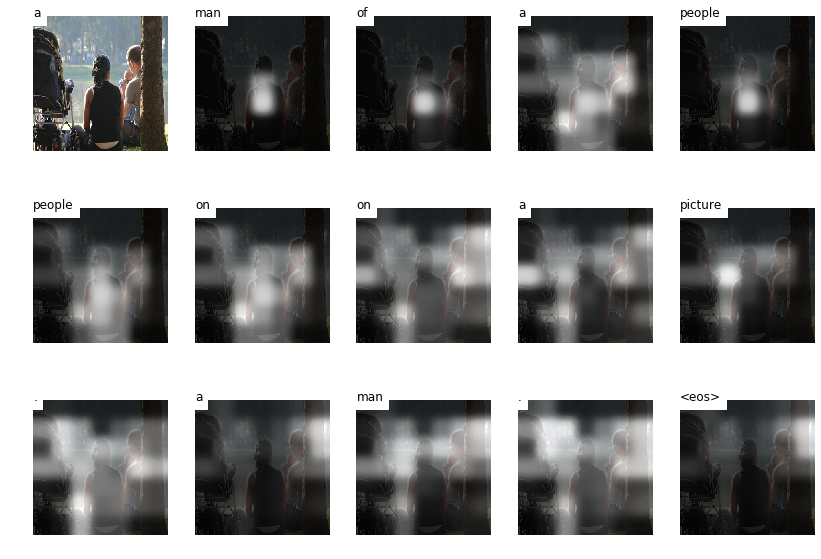

a dog running black dog in in the water . <eos>
----------------------------------------------------------------------------------------------------


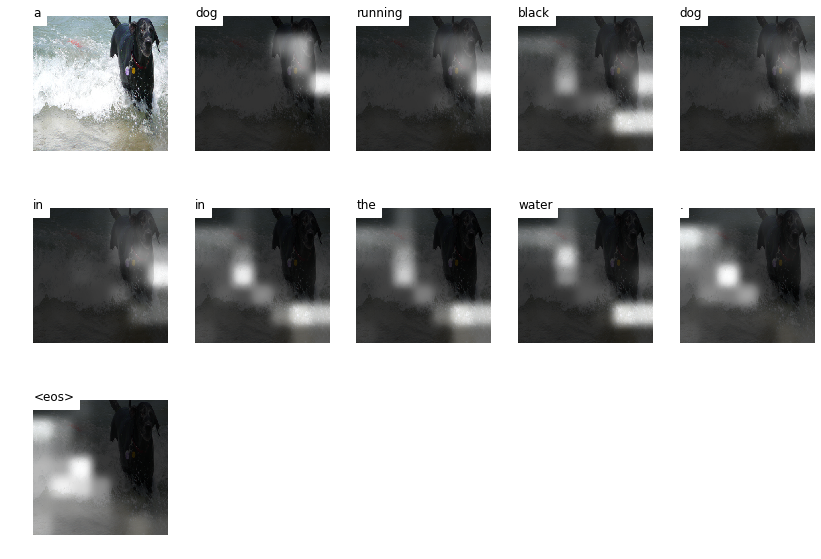

a woman is a black is on red . the background . <eos>
----------------------------------------------------------------------------------------------------


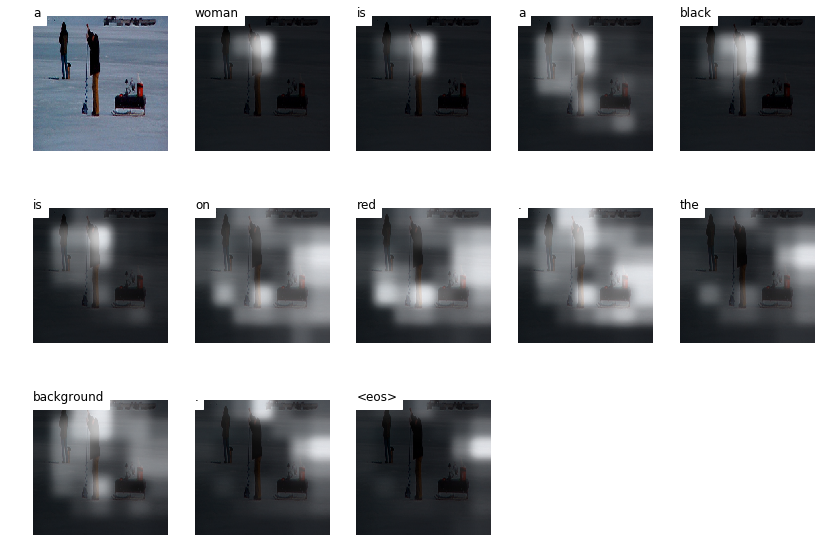

In [173]:
encoder.eval()
decoder.eval()

for i in range(20):
    image_path = os.path.join('./data/Flicker8k_Dataset/', dataset.test_ids[i])
    batch = dataset._getitem_by_img_id(dataset.test_ids[i])
    
    # unpack batch
    encoder_out = batch[0].to(device)
    encoded_captions = batch[1][0].to(device)
    caption_lengths = batch[1][1].to(device)

    predictions, encoded_captions, decode_lengths, alphas, sort_ind = decoder(
        encoder_out.unsqueeze(0), encoded_captions.unsqueeze(0), caption_lengths.unsqueeze(0)
    )
    text = pred2text(predictions[0].detach().numpy())
    print('='*100 + '\n' + text + '\n' + '-'*100)
    visualize_att(image_path, text, alphas[0].detach().numpy(), smooth=True)

# Переписал реализацию Attention и Decoder слоев

**Цель:** чтобы Decoder обрабатывал по одному слову за раз

Нужно чтобы механизм предсказания вынести в отдельный слой. Так можно обучить один декодер и применять разные стратегии предсказания описания к картинке(например, beam search).

In [222]:
class Attention(nn.Module):
    """
    Attention Network.
    """

    def __init__(self, encoder_dim, decoder_dim, attention_dim):
        """
        :param encoder_dim: feature size of encoded images
        :param decoder_dim: size of decoder's RNN
        :param attention_dim: size of the attention network
        """
        super(Attention, self).__init__()
        self.encoder_att = nn.Linear(encoder_dim, attention_dim)  # linear layer to transform encoded image
        self.decoder_att = nn.Linear(decoder_dim, attention_dim)  # linear layer to transform decoder's output
        self.full_att = nn.Linear(attention_dim, 1)  # linear layer to calculate values to be softmax-ed
        self.relu = nn.ReLU()
        self.softmax = nn.Softmax(dim=1)  # softmax layer to calculate weights

    def forward(self, encoder_out, decoder_hidden):
        """
        Forward propagation.
        :param encoder_out: encoded images, a tensor of dimension (batch_size, num_pixels, encoder_dim)
        :param decoder_hidden: previous decoder output, a tensor of dimension (batch_size, decoder_dim)
        :return: attention weighted encoding, weights
        """
        att1 = self.encoder_att(encoder_out)  # (batch_size, num_pixels, attention_dim)
        att2 = self.decoder_att(decoder_hidden).transpose(1, 0)  # (batch_size, 1, attention_dim)
        att = self.full_att(self.relu(att1 + att2)).squeeze(2)  # (batch_size, num_pixels)
        alpha = self.softmax(att)  # (batch_size, num_pixels)
        attention_weighted_encoding = (encoder_out * alpha.unsqueeze(2)).sum(dim=1)  # (batch_size, encoder_dim)

        return attention_weighted_encoding, alpha

In [361]:
class DecoderWithAttention(nn.Module):
    """
    Decoder.
    """

    def __init__(self, attention_dim, embed_dim, decoder_dim, vocab_size, encoder_dim=2048, dropout=0.5):
        """
        :param attention_dim: size of attention network
        :param embed_dim: embedding size
        :param decoder_dim: size of decoder's RNN
        :param vocab_size: size of vocabulary
        :param encoder_dim: feature size of encoded images
        :param dropout: dropout
        """
        super(DecoderWithAttention, self).__init__()

        self.encoder_dim = encoder_dim
        self.attention_dim = attention_dim
        self.embed_dim = embed_dim
        self.decoder_dim = decoder_dim
        self.vocab_size = vocab_size
        self.dropout = dropout

        self.attention = Attention(encoder_dim, decoder_dim, attention_dim)  # attention network

        self.embedding = nn.Embedding(vocab_size, embed_dim)  # embedding layer
        self.dropout = nn.Dropout(self.dropout, inplace=True)
        self.decode_step = nn.LSTM(embed_dim + encoder_dim, decoder_dim, bias=True) # decoding LSTM
        self.init_h = nn.Linear(encoder_dim, decoder_dim)  # linear layer to find initial hidden state of LSTMCell
        self.init_c = nn.Linear(encoder_dim, decoder_dim)  # linear layer to find initial cell state of LSTMCell
        self.out = nn.Linear(encoder_dim + decoder_dim, vocab_size)  # linear layer to find scores over vocabulary


    def init_hidden_state(self, encoder_out):
        """
        Creates the initial hidden and cell states for the decoder's LSTM based on the encoded images.
        :param encoder_out: encoded images, a tensor of dimension (batch_size, num_pixels, encoder_dim)
        :return: hidden state, cell state
        """
        mean_encoder_out = encoder_out.mean(dim=1)
        h = self.init_h(mean_encoder_out).unsqueeze(0)  # (1, b, decoder_dim)
        c = self.init_c(mean_encoder_out).unsqueeze(0)  # (1, b, decoder_dim)
        return h, c

    
    def forward(self, input, encoder_out, last_hidden=None, last_ceil=None):
        """Decodes with attention token by token

        Args:
            input (torch tensor of shape (b,)): input token
            encoder_out: (torch tensor of shape (b, enc_img_size, enc_img_size, enc_dim)): encoded images
            last_hidden (torch tensor of shape (1, b, h)): last hidden
            last_ceil (torch tensor of shape (1, b, h)): last ceil
        
        Returns:
            output (torch tensor of shape (b, vocab_size)): ouput token distribution
            alpha (torch tensor of shape (b, num_pixels)): attention weights
            last_hidden (torch tensor of shape (1, b, h)): last hidden
            last_ceil (torch tensor of shape (1, b, h)): last ceil
        """

        batch_size = encoder_out.size(0)
        encoder_dim = encoder_out.size(-1)
        vocab_size = self.vocab_size
        
        # get the embedding of the current input word (last output word)
        embedded = self.embedding(input).unsqueeze(0)  # (1, b, embed_dim)
        embedded = self.dropout(embedded)

        # flatten image
        encoder_out = encoder_out.view(batch_size, -1, encoder_dim)  # (b, num_pixels, encoder_dim)
        num_pixels = encoder_out.size(1)
        
        if last_hidden is None or last_ceil is None:
            # Initialize LSTM state
            last_hidden, last_ceil = self.init_hidden_state(encoder_out)  # (1, batch_size, decoder_dim)
        
        # calculate attention weights and apply to encoder outputs
        # attention_weighted_encoding = (b, encoder_dim)
        # alpha = (b, num_pixels)
        attention_weighted_encoding, alpha = self.attention(encoder_out, last_hidden)
        
        # combine embedded input word and attended context, run through RNN
        rnn_input = torch.cat([embedded, attention_weighted_encoding.unsqueeze(0)], 2)
        output, (last_hidden, last_ceil) = self.decode_step(rnn_input, (last_hidden, last_ceil)) ## forward recurrent unit 
        output = output.squeeze(0)  # (1,B,N) -> (B,N)
        
        output = self.out(torch.cat([output, attention_weighted_encoding], 1)) # (B, vocab_size)
        output = F.log_softmax(output, dim=1) # (B, vocab_size)

        return output, alpha, last_hidden, last_ceil

### Жадная стратегия генерации описания

In [362]:
class Img2Seq(nn.Module):
    def __init__(self, decoder):#, encoder):
        super().__init__()
#         self.encoder = encoder
        self.decoder = decoder

    def forward(self, encoder_out, bos_token, max_len):
        """Image-to-sequence inference

        Args:
            encoder_out: (torch tensor of shape (b, enc_img_size, enc_img_size, enc_dim)): encoded images
        
        Returns:
            outputs (torch tensor of shape (max_len, b, vocab_size)): ouput token distribution
            alphas (torch tensor of shape (max_len, b, num_pixels)): attention weights
        """
        device = encoder_out.device
        batch_size = encoder_out.shape[0]
        vocab_size = self.decoder.vocab_size
        encoder_dim = encoder_out.shape[3]
        assert encoder_out.shape[1] == encoder_out.shape[2]
        num_pixels = encoder_out.shape[1] * encoder_out.shape[2]
        
        outputs = torch.zeros(max_len, batch_size, vocab_size).to(device)
        alphas = torch.ones(max_len, batch_size, num_pixels).to(device)

        hidden = None
        ceil = None
        output = torch.full((batch_size,), bos_token, dtype=torch.long).to(device) # (b, )
        
        for t in range(1, max_len):
            # output = (b, vocab_size)
            # alpha = (b, num_pixels)
            # hidden = (1, b, h)
            # ceil = (1, b, h)
            output, alpha, hidden, ceil = self.decoder(output, encoder_out, hidden, ceil) ## apply decoder
            outputs[t] = output
            alphas[t] = alpha
            
            top1 = output.data.max(1)[1]
            output = top1.to(device) # (b, )
            
        return outputs, alphas

#### Будем переводить текст в тензоры индексов

In [259]:
def target_transform(target):
    text = np.random.choice(target)
    return torch.from_numpy(text2idx(text))

In [260]:
def transform(x):
    return torch.from_numpy(x)#.permute(0, 2, 3, 1)

In [261]:
features_path = 'data/features'
batch_size = 32

dataset = FeaturesFlickr(
    root=os.path.join(data_dir, 'Flicker8k_Dataset'),
    ann_file=os.path.join(data_dir, 'Flickr8k_text', 'Flickr8k.token.txt'),
    features_path=features_path,
    transform=transform,
    target_transform=target_transform,
)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=2)

In [262]:
for batch in dataloader:
    features, target = batch[0]
    print(target)
    print(features)
    break

ValueError: too many values to unpack (expected 2)

In [ ]:
batch[0].shape

In [263]:
batch[1].shape

torch.Size([32, 40])

# Train loop

In [363]:
# Model parameters
vocab_size = len(word2idx)
emb_dim = 256  # dimension of word embeddings
attention_dim = 256  # dimension of attention linear layers
decoder_dim = 256  # dimension of decoder RNN
dropout = 0.2
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # sets device for model and PyTorch tensors

Model

In [364]:
encoder = make_encoder().to(device)
decoder = DecoderWithAttention(
    attention_dim=attention_dim,
    embed_dim=emb_dim,
    decoder_dim=decoder_dim,
    vocab_size=vocab_size,
    dropout=dropout,
).to(device)
img2seq = Img2Seq(decoder).to(device)

bos_token = word2idx['<bos>']
eos_token = word2idx['<eos>']
pad_token = word2idx['<pad>']

In [274]:
def plot_pred(encoder_out, image_path, model=img2seq):
#     encoder_out = batch[0].to(device)

    outputs, alphas = model(encoder_out.unsqueeze(0), bos_token, max_len)
    text = pred2text(outputs.squeeze(1).detach().numpy())
    print('='*100 + '\n' + text + '\n' + '-'*100)
    visualize_att(image_path, text, alphas.squeeze(1).detach().numpy(), smooth=True)

In [365]:
%%time

n_epochs = 20
lr = 0.0001
grad_clip = 10.0

optimizer = optim.Adam(img2seq.parameters(), lr=lr)

total_loss = 0
decoder.train()
for epoch in tqdm(range(n_epochs)):
    for i, batch in enumerate(tqdm(dataloader)):
        # unpack batch
        encoder_out = batch[0].to(device) # (b, enc_img_size, enc_img_size, enc_dim)
        encoded_captions = batch[1].to(device).transpose(1, 0).contiguous() # (max_len, b)
        
        
        # apply model
        # outputs = (max_len, b, vocab_size)
        # alpha = (max_len, b, num_pixels)
        outputs, alphas = img2seq(encoder_out, bos_token, max_len)
        
        # calculate nll loss
        # 1) don't take into account first token (it's always <sos>)
        # 2) don't take into account pad token (ignore_index argument)
        loss = F.nll_loss(outputs[1:].view(-1, vocab_size), encoded_captions[1:].view(-1), ignore_index=pad_token)
        
        # optimize
        optimizer.zero_grad()
        loss.backward()
        
        # clip gradients using nn.utils.clip_grad_norm_ by `grad_clip` value
        nn.utils.clip_grad_norm_(decoder.parameters(), grad_clip)
        
        optimizer.step()
        total_loss += loss.item()

        if i % 10 == 0 and i != 0:
            total_loss = total_loss / 10
            print("[%d][loss:%5.2f][pp:%5.2f]" % (i, total_loss, np.exp(total_loss)))
            total_loss = 0
            
    for i in range(3):
        image_path = os.path.join('./data/Flicker8k_Dataset/', dataset.test_ids[i])
        encoder_out = dataset._getitem_by_img_id(dataset.test_ids[i])[0]
        plot_pred(encoder_out, image_path)
        print()
        

[10][loss: 9.19][pp:9824.74]
[20][loss: 6.32][pp:553.24]
[30][loss: 5.64][pp:281.35]
[40][loss: 5.62][pp:274.64]
[50][loss: 5.53][pp:252.49]
[60][loss: 5.43][pp:227.77]
[70][loss: 5.27][pp:194.36]
[80][loss: 5.23][pp:185.98]
[90][loss: 5.11][pp:165.90]
[100][loss: 5.14][pp:170.80]
[110][loss: 5.02][pp:151.69]
[120][loss: 5.08][pp:161.36]
[130][loss: 5.01][pp:150.64]
[140][loss: 4.96][pp:142.22]
[150][loss: 4.99][pp:146.30]
[160][loss: 4.98][pp:144.83]
[170][loss: 5.00][pp:147.77]
[180][loss: 4.96][pp:142.47]
[190][loss: 4.91][pp:135.20]
[200][loss: 4.93][pp:138.30]


Traceback (most recent call last):
  File "/Users/maxim/miniconda3/lib/python3.6/multiprocessing/queues.py", line 240, in _feed
    send_bytes(obj)
  File "/Users/maxim/miniconda3/lib/python3.6/multiprocessing/connection.py", line 200, in send_bytes
    self._send_bytes(m[offset:offset + size])
  File "/Users/maxim/miniconda3/lib/python3.6/multiprocessing/connection.py", line 404, in _send_bytes
    self._send(header + buf)
  File "/Users/maxim/miniconda3/lib/python3.6/multiprocessing/connection.py", line 368, in _send
    n = write(self._handle, buf)
BrokenPipeError: [Errno 32] Broken pipe
Traceback (most recent call last):
  File "/Users/maxim/miniconda3/lib/python3.6/multiprocessing/queues.py", line 240, in _feed
    send_bytes(obj)
  File "/Users/maxim/miniconda3/lib/python3.6/multiprocessing/connection.py", line 200, in send_bytes
    self._send_bytes(m[offset:offset + size])
  File "/Users/maxim/miniconda3/lib/python3.6/multiprocessing/connection.py", line 404, in _send_bytes
   

KeyboardInterrupt: 

[10][loss: 5.05][pp:155.44]
[20][loss: 4.53][pp:92.96]
[30][loss: 4.55][pp:94.82]
[40][loss: 4.62][pp:101.79]
[50][loss: 4.66][pp:105.40]
[60][loss: 4.58][pp:97.82]
[70][loss: 4.58][pp:97.57]
[80][loss: 4.56][pp:95.75]
[90][loss: 4.65][pp:104.77]
[100][loss: 4.59][pp:98.37]
[110][loss: 4.50][pp:90.32]
[120][loss: 4.55][pp:94.90]
[130][loss: 4.65][pp:104.64]
[140][loss: 4.70][pp:110.39]
[150][loss: 4.58][pp:97.40]
[160][loss: 4.58][pp:97.79]
[170][loss: 4.57][pp:96.54]
[180][loss: 4.56][pp:95.33]
[190][loss: 4.57][pp:96.76]
[200][loss: 4.62][pp:101.98]
[210][loss: 4.58][pp:97.59]
[220][loss: 4.61][pp:100.57]
[230][loss: 4.66][pp:105.86]
[240][loss: 4.64][pp:103.72]
[250][loss: 4.62][pp:101.79]
a man in a a a a a a <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
-------------------------------------------------------------------------------------------------

/Users/maxim/code/git/fintech/learning-deep-learning/dl_pytorch/lib/python3.6/site-packages/skimage/transform/_warps.py:24: UserWarning: The default multichannel argument (None) is deprecated.  Please specify either True or False explicitly.  multichannel will default to False starting with release 0.16.
  warn('The default multichannel argument (None) is deprecated.  Please '


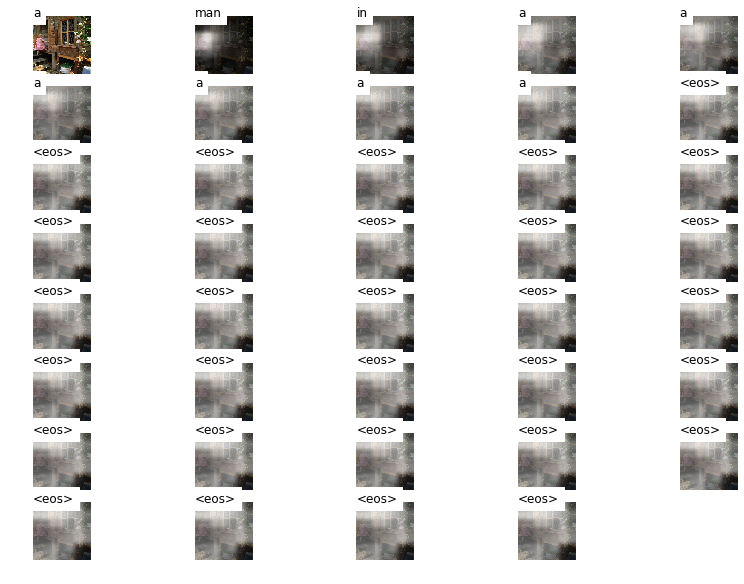


a dog dog dog a a a a . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


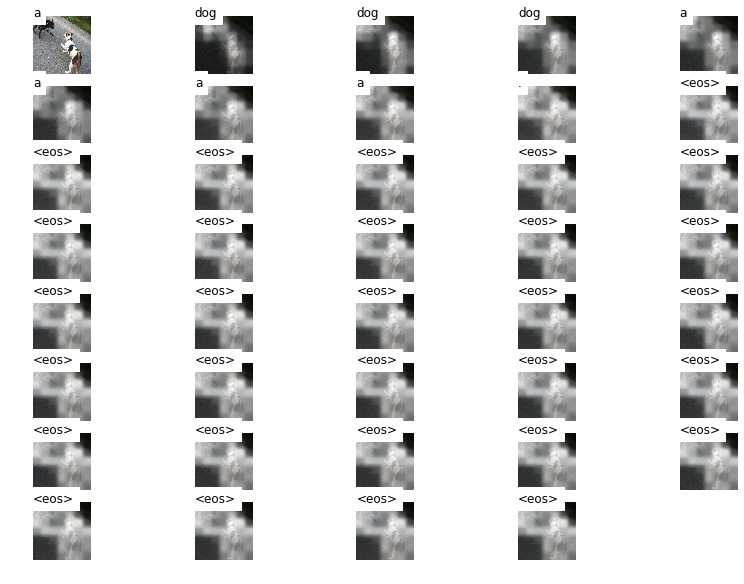


a man in a a a a a . . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


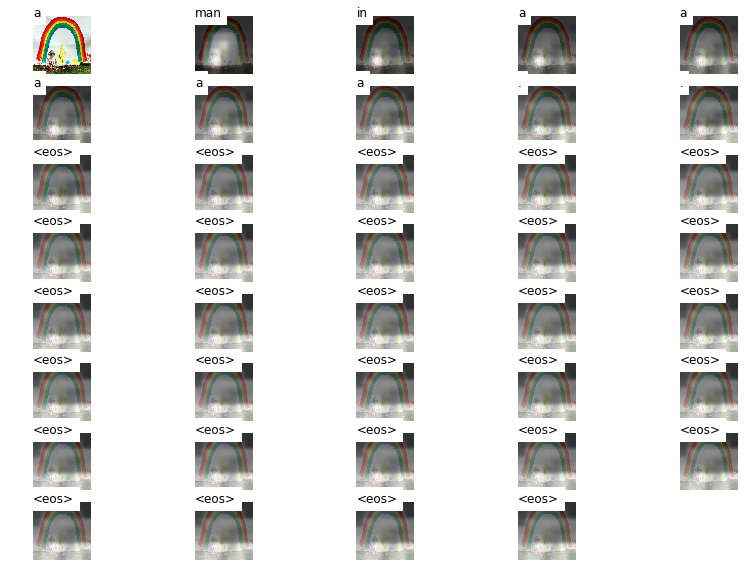

[10][loss: 6.02][pp:409.95]
[20][loss: 4.64][pp:103.83]
[30][loss: 4.64][pp:103.41]
[40][loss: 4.60][pp:99.92]
[50][loss: 4.60][pp:99.54]
[60][loss: 4.58][pp:97.17]
[70][loss: 4.59][pp:98.14]
[80][loss: 4.64][pp:103.65]
[90][loss: 4.57][pp:96.20]
[100][loss: 4.60][pp:99.12]
[110][loss: 4.57][pp:96.77]
[120][loss: 4.63][pp:102.06]
[130][loss: 4.55][pp:95.03]
[140][loss: 4.57][pp:96.75]
[150][loss: 4.60][pp:99.56]
[160][loss: 4.61][pp:100.28]
[170][loss: 4.58][pp:97.43]
[180][loss: 4.57][pp:96.74]
[190][loss: 4.54][pp:93.26]
[200][loss: 4.59][pp:98.42]
[210][loss: 4.58][pp:97.61]
[220][loss: 4.53][pp:92.80]


Traceback (most recent call last):
Traceback (most recent call last):
  File "/Users/maxim/miniconda3/lib/python3.6/multiprocessing/queues.py", line 240, in _feed
    send_bytes(obj)
  File "/Users/maxim/miniconda3/lib/python3.6/multiprocessing/connection.py", line 200, in send_bytes
    self._send_bytes(m[offset:offset + size])
  File "/Users/maxim/miniconda3/lib/python3.6/multiprocessing/connection.py", line 404, in _send_bytes
    self._send(header + buf)
  File "/Users/maxim/miniconda3/lib/python3.6/multiprocessing/connection.py", line 368, in _send
    n = write(self._handle, buf)
BrokenPipeError: [Errno 32] Broken pipe
  File "/Users/maxim/miniconda3/lib/python3.6/multiprocessing/queues.py", line 240, in _feed
    send_bytes(obj)
  File "/Users/maxim/miniconda3/lib/python3.6/multiprocessing/connection.py", line 200, in send_bytes
    self._send_bytes(m[offset:offset + size])
  File "/Users/maxim/miniconda3/lib/python3.6/multiprocessing/connection.py", line 404, in _send_bytes
   

KeyboardInterrupt: 

In [417]:
%%time

n_epochs = 20
lr = 0.00001
grad_clip = 10.0

optimizer = optim.Adam(img2seq.parameters(), lr=lr)

total_loss = 0
decoder.train()
for epoch in tqdm(range(n_epochs)):
    for i, batch in enumerate(tqdm(dataloader)):
        # unpack batch
        encoder_out = batch[0].to(device) # (b, enc_img_size, enc_img_size, enc_dim)
        encoded_captions = batch[1].to(device).transpose(1, 0).contiguous() # (max_len, b)
        
        optimizer.zero_grad()
        
        # apply model
        # outputs = (max_len, b, vocab_size)
        # alpha = (max_len, b, num_pixels)
        outputs, alphas = img2seq(encoder_out, bos_token, max_len)
        
        # calculate nll loss
        # 1) don't take into account first token (it's always <sos>)
        # 2) don't take into account pad token (ignore_index argument)
        loss = F.nll_loss(outputs[1:].view(-1, vocab_size), encoded_captions[1:].view(-1), ignore_index=pad_token)
        
        loss.backward()
        
        # clip gradients using nn.utils.clip_grad_norm_ by `grad_clip` value
        nn.utils.clip_grad_norm_(img2seq.parameters(), grad_clip)
        
        optimizer.step()
        total_loss += loss.item()

        if i % 10 == 0 and i != 0:
            total_loss = total_loss / 10
            print("[%d][loss:%5.2f][pp:%5.2f]" % (i, total_loss, np.exp(total_loss)))
            total_loss = 0
           
    for i in range(3):
        image_path = os.path.join('./data/Flicker8k_Dataset/', dataset.test_ids[i])
        encoder_out = dataset._getitem_by_img_id(dataset.test_ids[i])[0]
        plot_pred(encoder_out, image_path)
        print()
        

In [422]:
# Model parameters
vocab_size = len(word2idx)
emb_dim = 256  # dimension of word embeddings
attention_dim = 256  # dimension of attention linear layers
decoder_dim = 256  # dimension of decoder RNN
dropout = 0.2
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # sets device for model and PyTorch tensors

Model

In [425]:
encoder = make_encoder().to(device)
decoder = DecoderWithAttention(
    attention_dim=attention_dim,
    embed_dim=emb_dim,
    decoder_dim=decoder_dim,
    vocab_size=vocab_size,
    dropout=dropout,
).to(device)
img2seq = Img2Seq(decoder).to(device)

bos_token = word2idx['<bos>']
eos_token = word2idx['<eos>']
pad_token = word2idx['<pad>']

[10][loss: 7.15][pp:1271.12]
[20][loss: 5.61][pp:272.87]
[30][loss: 5.34][pp:207.63]
[40][loss: 5.22][pp:184.06]
[50][loss: 5.04][pp:154.91]
[60][loss: 5.06][pp:156.99]
[70][loss: 5.05][pp:156.21]
[80][loss: 4.95][pp:140.93]
[90][loss: 4.98][pp:145.36]
[100][loss: 4.92][pp:136.97]
[110][loss: 4.95][pp:141.08]
[120][loss: 4.86][pp:129.37]
[130][loss: 4.89][pp:133.04]
[140][loss: 4.93][pp:138.63]
[150][loss: 4.89][pp:133.05]
[160][loss: 4.91][pp:135.05]
[170][loss: 4.84][pp:126.43]
[180][loss: 4.84][pp:126.75]
[190][loss: 4.90][pp:133.79]
[200][loss: 4.81][pp:122.44]
[210][loss: 4.79][pp:120.11]
[220][loss: 4.83][pp:125.25]
[230][loss: 4.78][pp:118.67]
[240][loss: 4.79][pp:119.91]
[250][loss: 4.89][pp:132.56]
a man in a a a a a a a <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
--------------------------------------------------------------------------------------

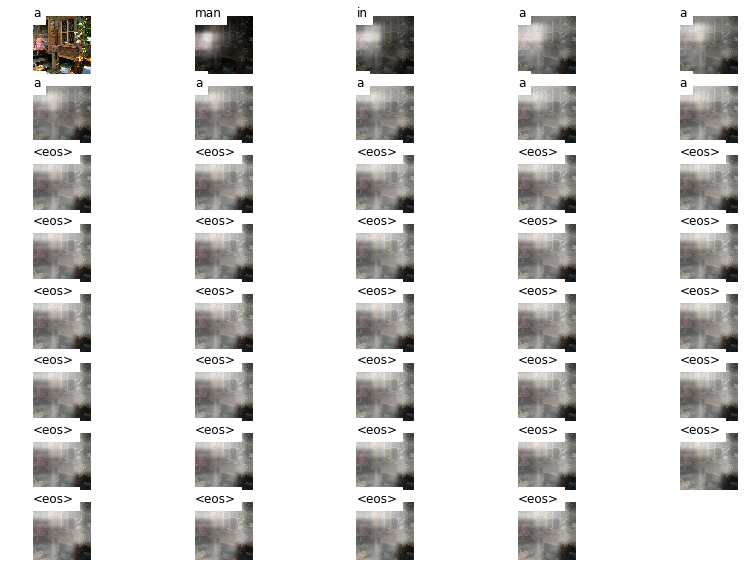


a dog dog dog a a a a . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


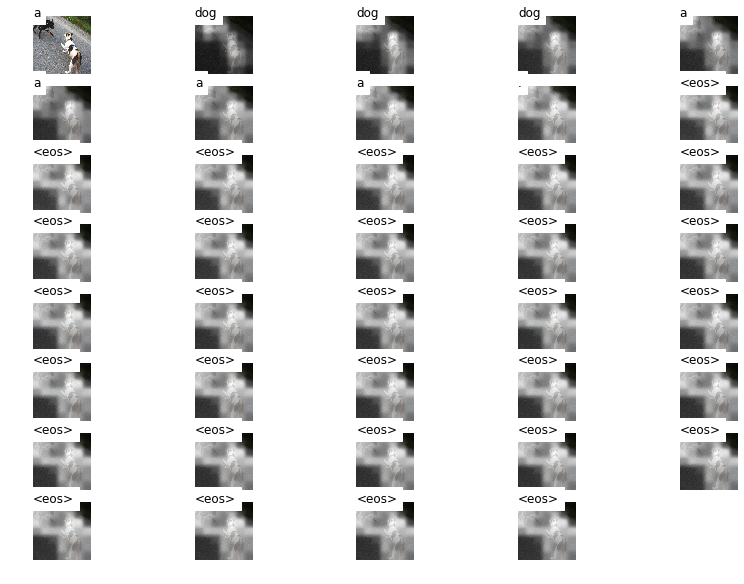


a man in a a a a a . . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


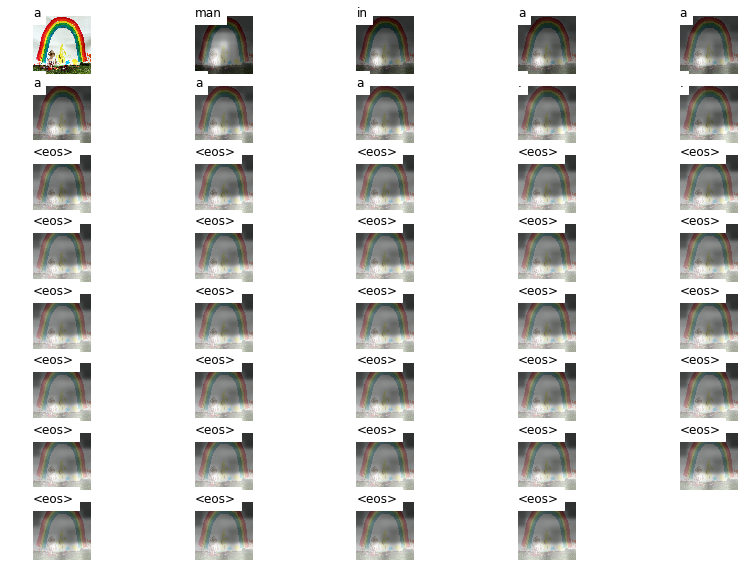

[10][loss: 6.07][pp:433.17]
[20][loss: 4.55][pp:95.09]
[30][loss: 4.60][pp:99.75]
[40][loss: 4.63][pp:102.61]
[50][loss: 4.57][pp:96.26]
[60][loss: 4.57][pp:96.33]
[70][loss: 4.57][pp:96.08]
[80][loss: 4.64][pp:103.36]
[90][loss: 4.64][pp:103.05]
[100][loss: 4.57][pp:96.30]
[110][loss: 4.56][pp:95.62]
[120][loss: 4.62][pp:101.41]
[130][loss: 4.51][pp:90.83]
[140][loss: 4.57][pp:96.94]
[150][loss: 4.59][pp:98.25]
[160][loss: 4.62][pp:101.74]
[170][loss: 4.65][pp:104.40]
[180][loss: 4.60][pp:99.21]
[190][loss: 4.58][pp:97.03]
[200][loss: 4.59][pp:98.12]
[210][loss: 4.62][pp:101.13]
[220][loss: 4.60][pp:99.04]
[230][loss: 4.62][pp:101.30]
[240][loss: 4.56][pp:95.98]
[250][loss: 4.59][pp:98.56]
a man in a a a a a a a <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


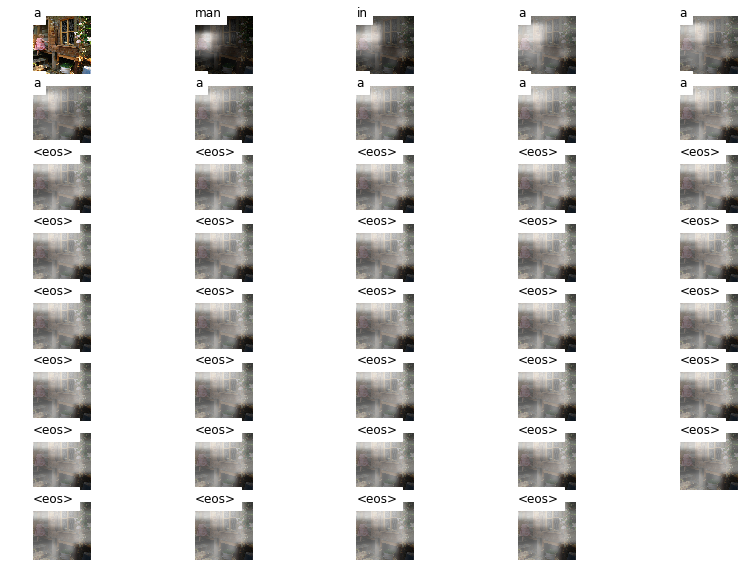


a dog dog dog a a a a . . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


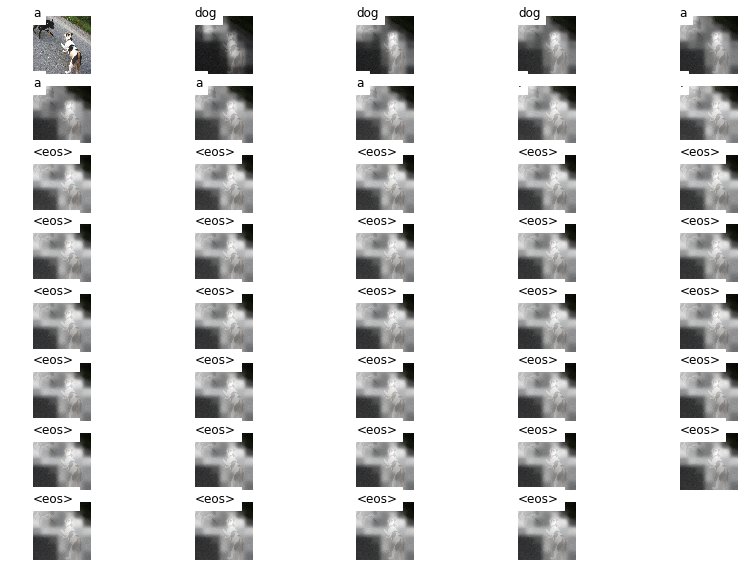


a man in a a a a a . . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


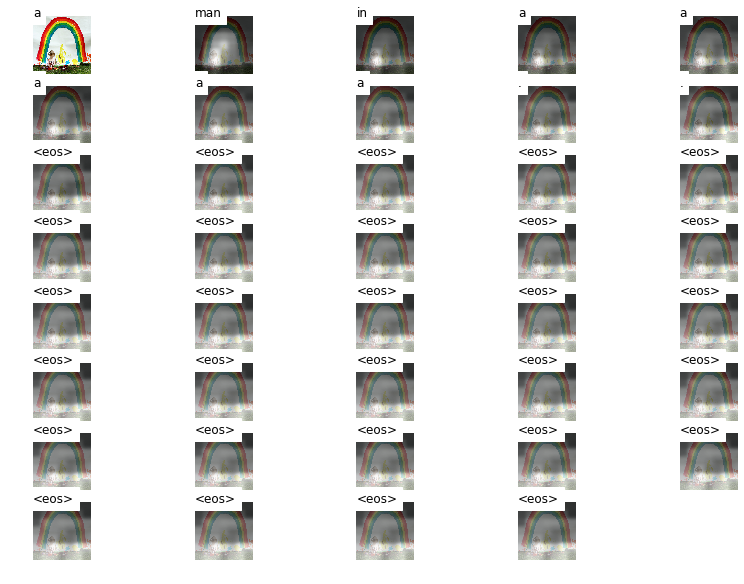

[10][loss: 5.83][pp:339.73]
[20][loss: 4.44][pp:84.47]
[30][loss: 4.46][pp:86.21]
[40][loss: 4.30][pp:73.35]
[50][loss: 4.45][pp:85.95]
[60][loss: 4.37][pp:78.91]
[70][loss: 4.35][pp:77.35]
[80][loss: 4.44][pp:84.97]
[90][loss: 4.41][pp:82.43]
[100][loss: 4.42][pp:82.77]
[110][loss: 4.41][pp:82.16]
[120][loss: 4.44][pp:84.68]
[130][loss: 4.45][pp:85.25]
[140][loss: 4.46][pp:86.91]
[150][loss: 4.48][pp:88.30]
[160][loss: 4.46][pp:86.27]
[170][loss: 4.37][pp:78.94]
[180][loss: 4.41][pp:82.31]
[190][loss: 4.50][pp:89.61]
[200][loss: 4.48][pp:88.06]
[210][loss: 4.42][pp:83.12]
[220][loss: 4.40][pp:81.24]
[230][loss: 4.39][pp:80.30]
[240][loss: 4.29][pp:73.19]
[250][loss: 4.52][pp:91.44]
a man in a a a a a a a <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


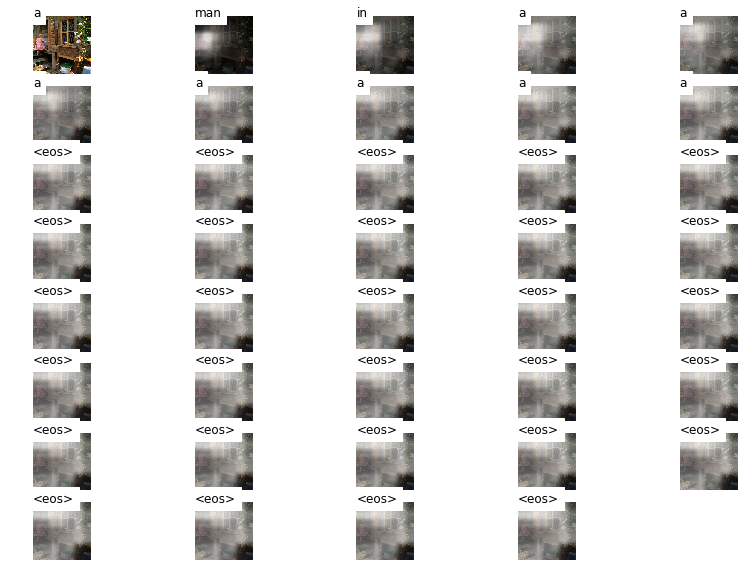


a dog dog dog a a a a . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


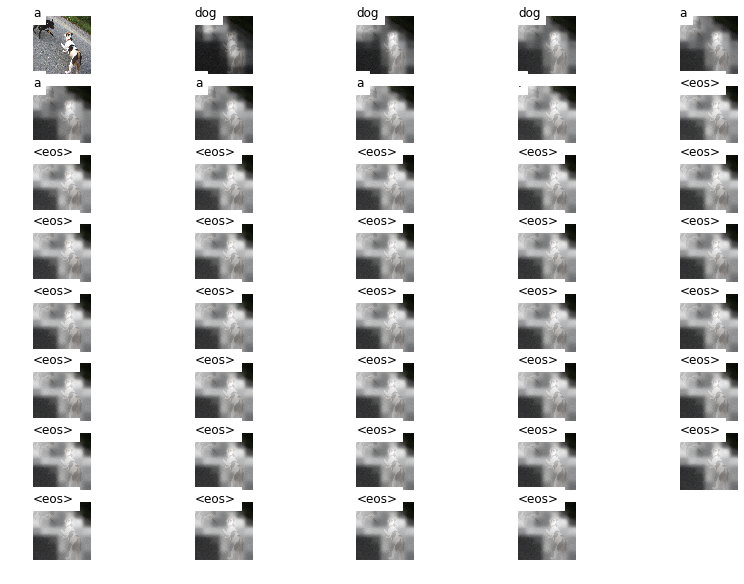


a man in a a a a a . . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


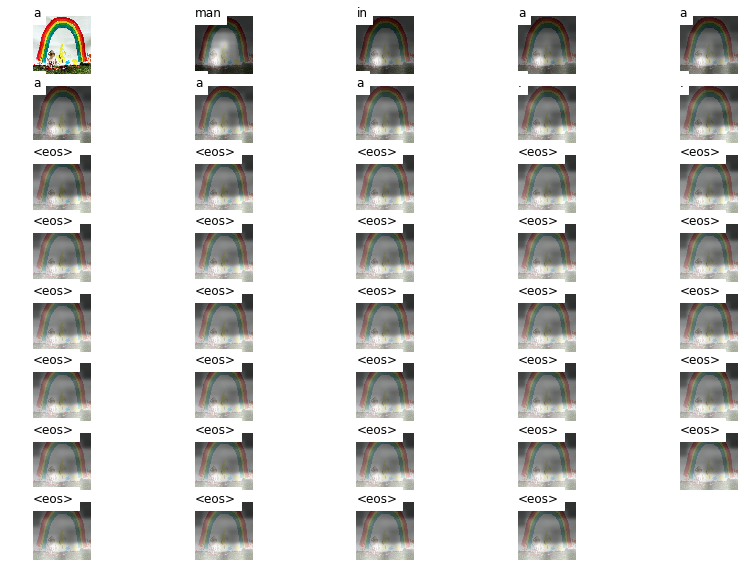

[10][loss: 5.65][pp:285.32]
[20][loss: 4.29][pp:73.16]
[30][loss: 4.31][pp:74.67]
[40][loss: 4.25][pp:69.78]
[50][loss: 4.31][pp:74.80]
[60][loss: 4.29][pp:73.31]
[70][loss: 4.36][pp:78.25]
[80][loss: 4.28][pp:72.22]
[90][loss: 4.35][pp:77.54]
[100][loss: 4.27][pp:71.50]
[110][loss: 4.27][pp:71.22]
[120][loss: 4.34][pp:76.53]
[130][loss: 4.35][pp:77.32]
[140][loss: 4.31][pp:74.42]
[150][loss: 4.27][pp:71.35]
[160][loss: 4.30][pp:73.80]
[170][loss: 4.43][pp:84.10]
[180][loss: 4.28][pp:72.50]
[190][loss: 4.24][pp:69.60]
[200][loss: 4.29][pp:73.03]
[210][loss: 4.38][pp:79.82]
[220][loss: 4.32][pp:75.09]
[230][loss: 4.29][pp:72.87]
[240][loss: 4.39][pp:80.84]
[250][loss: 4.37][pp:79.08]
a man in a a a a a a a <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


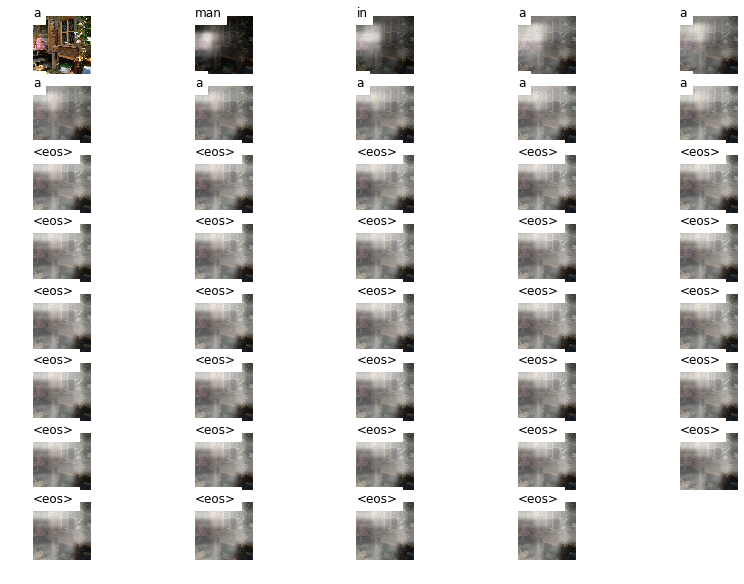


a dog dog dog a a a a . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


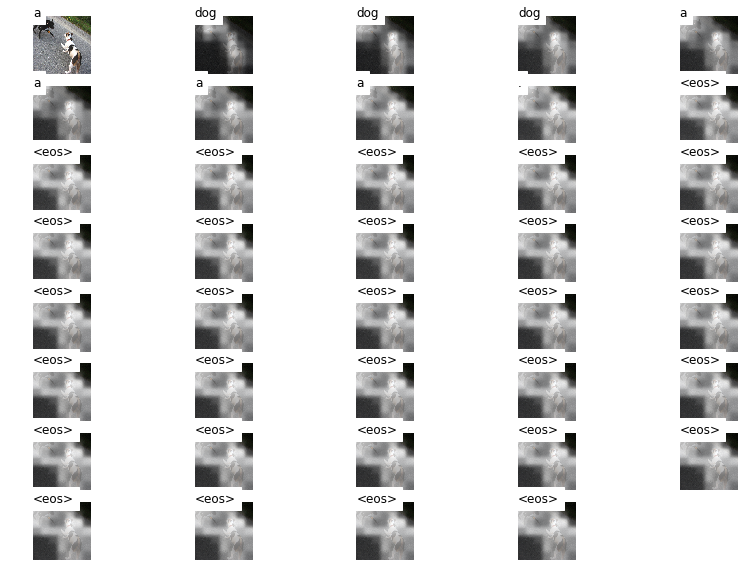


a man in a a a a a . . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


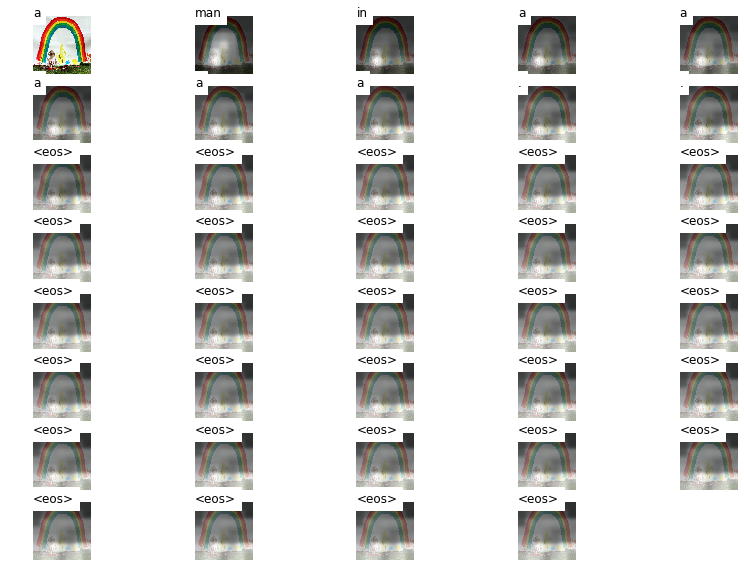

[10][loss: 5.46][pp:235.30]
[20][loss: 4.19][pp:66.09]
[30][loss: 4.23][pp:68.50]
[40][loss: 4.22][pp:68.04]
[50][loss: 4.18][pp:65.43]
[60][loss: 4.22][pp:68.02]
[70][loss: 4.23][pp:68.99]
[80][loss: 4.20][pp:66.79]
[90][loss: 4.14][pp:63.00]
[100][loss: 4.21][pp:67.25]
[110][loss: 4.24][pp:69.68]
[120][loss: 4.24][pp:69.15]
[130][loss: 4.24][pp:69.47]
[140][loss: 4.22][pp:67.85]
[150][loss: 4.23][pp:68.40]
[160][loss: 4.29][pp:73.11]
[170][loss: 4.23][pp:68.99]
[180][loss: 4.27][pp:71.45]
[190][loss: 4.25][pp:70.37]
[200][loss: 4.26][pp:70.77]
[210][loss: 4.20][pp:66.47]
[220][loss: 4.13][pp:62.45]
[230][loss: 4.28][pp:72.25]
[240][loss: 4.23][pp:68.39]
[250][loss: 4.18][pp:65.59]
a man in a a a a a a a <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


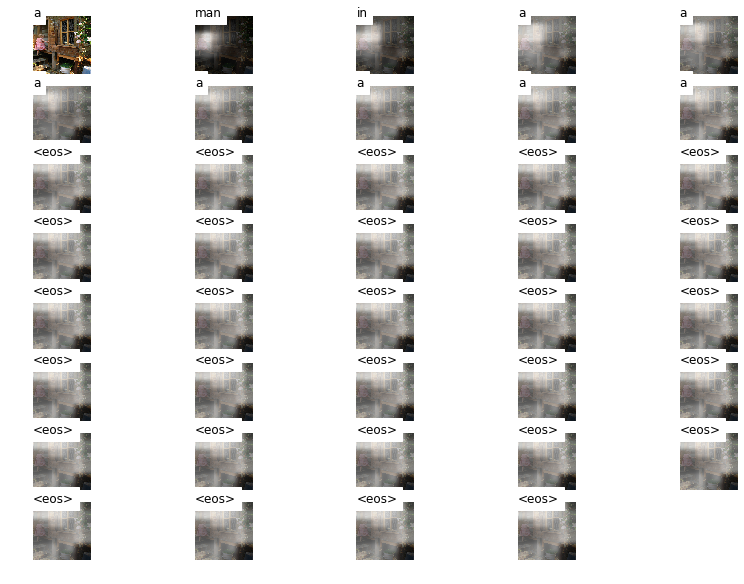


a dog dog dog a a a a . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


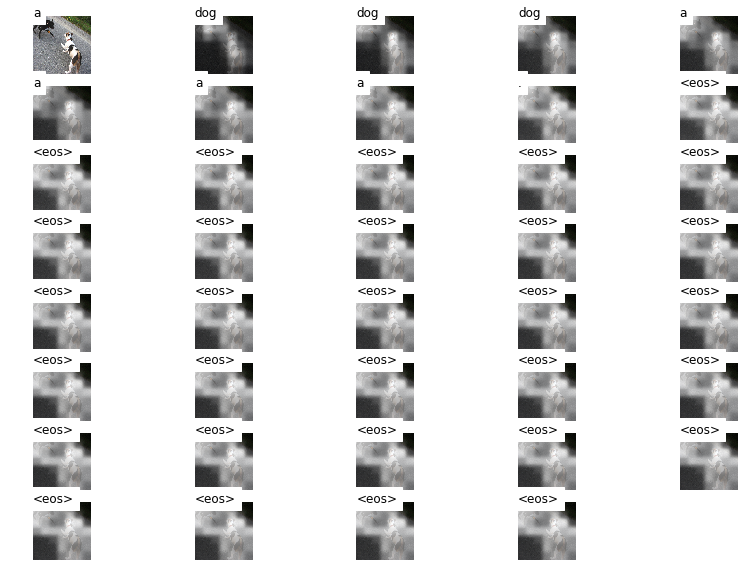


a man in a a a a a . . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


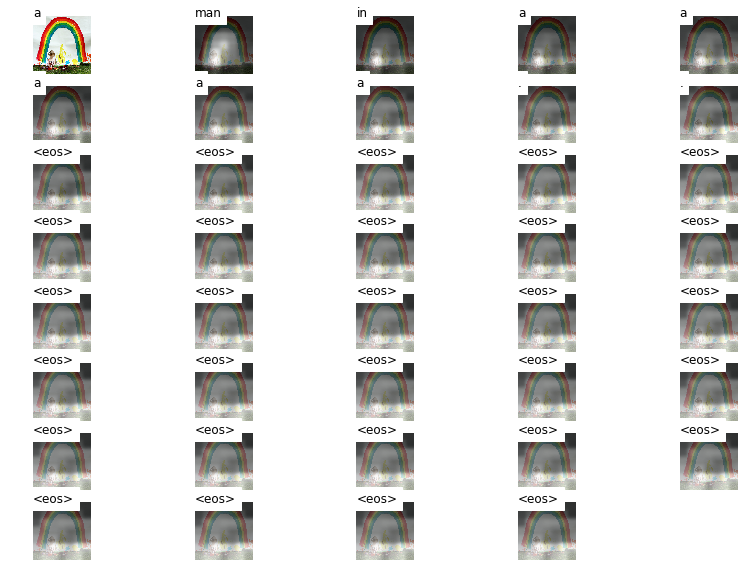

[10][loss: 5.41][pp:223.43]
[20][loss: 4.21][pp:67.47]
[30][loss: 4.19][pp:66.09]
[40][loss: 4.08][pp:59.42]
[50][loss: 4.15][pp:63.70]
[60][loss: 4.03][pp:56.30]
[70][loss: 4.31][pp:74.42]
[80][loss: 4.11][pp:61.02]
[90][loss: 4.28][pp:72.05]
[100][loss: 4.23][pp:68.77]
[110][loss: 4.14][pp:62.56]
[120][loss: 4.22][pp:68.33]
[130][loss: 4.16][pp:64.28]
[140][loss: 4.23][pp:68.57]
[150][loss: 4.25][pp:70.09]
[160][loss: 4.15][pp:63.73]
[170][loss: 4.17][pp:65.00]
[180][loss: 4.20][pp:66.82]
[190][loss: 4.14][pp:62.76]
[200][loss: 4.22][pp:68.06]
[210][loss: 4.22][pp:68.35]
[220][loss: 4.14][pp:62.62]
[230][loss: 4.22][pp:68.00]
[240][loss: 4.10][pp:60.50]
[250][loss: 4.25][pp:69.89]
a man in a a a a a a a <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


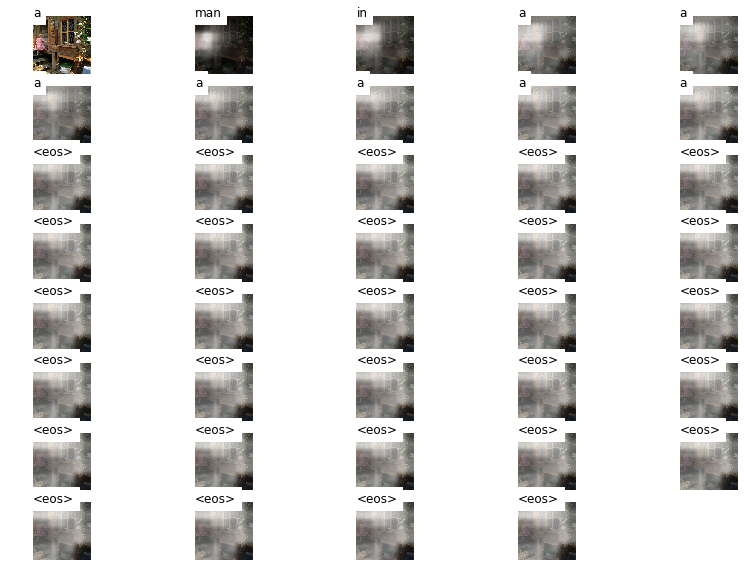


a dog dog dog a a a a . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


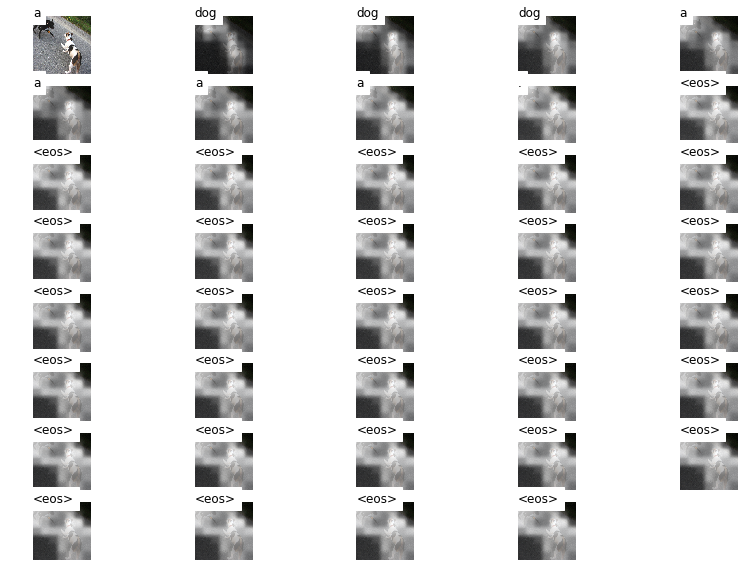


a man in a a a a a . . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


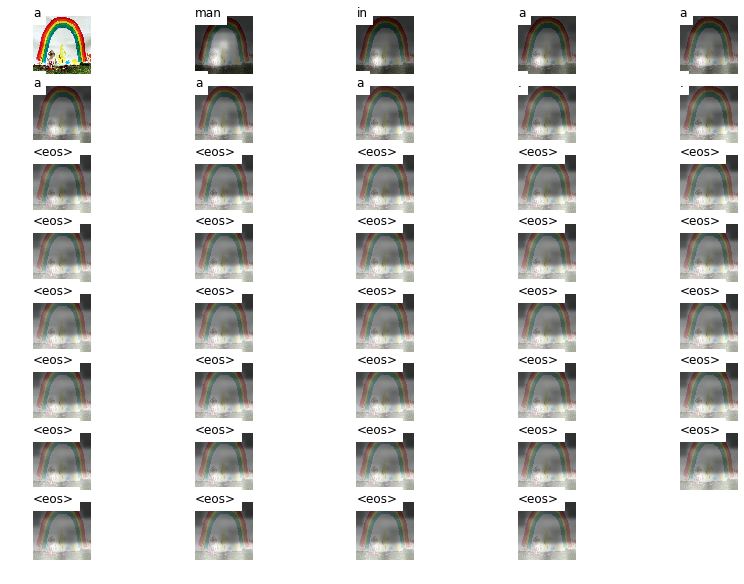

[10][loss: 5.39][pp:219.45]
[20][loss: 4.02][pp:55.73]
[30][loss: 4.13][pp:61.95]
[40][loss: 4.17][pp:64.80]
[50][loss: 4.07][pp:58.66]
[60][loss: 4.09][pp:59.55]
[70][loss: 4.08][pp:58.86]
[80][loss: 4.03][pp:56.39]
[90][loss: 4.11][pp:60.99]
[100][loss: 4.10][pp:60.23]
[110][loss: 4.10][pp:60.33]
[120][loss: 4.14][pp:62.58]
[130][loss: 4.23][pp:68.59]
[140][loss: 4.09][pp:59.83]
[150][loss: 4.13][pp:61.98]
[160][loss: 4.07][pp:58.76]
[170][loss: 4.19][pp:65.84]
[180][loss: 4.17][pp:64.88]
[190][loss: 4.16][pp:64.23]
[200][loss: 4.12][pp:61.46]
[210][loss: 4.12][pp:61.54]
[220][loss: 4.12][pp:61.52]
[230][loss: 4.12][pp:61.28]
[240][loss: 4.10][pp:60.48]
[250][loss: 4.12][pp:61.70]
a man in a a a a a a a <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


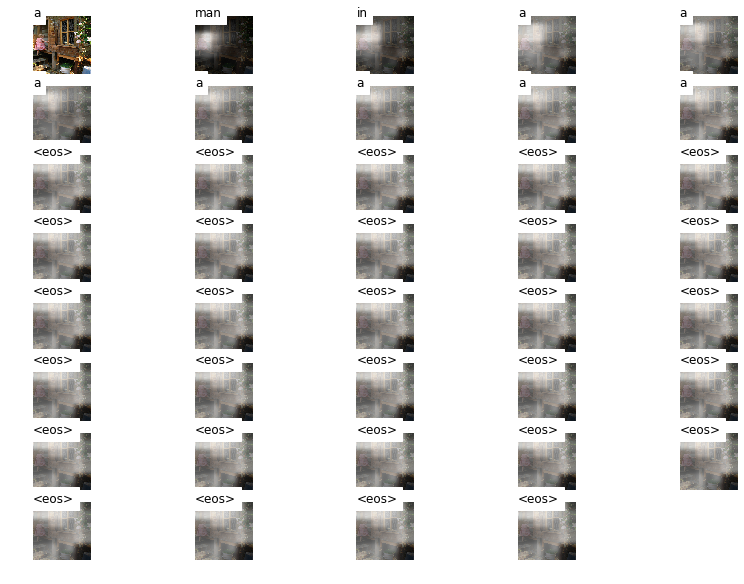


a dog dog dog a a a a . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


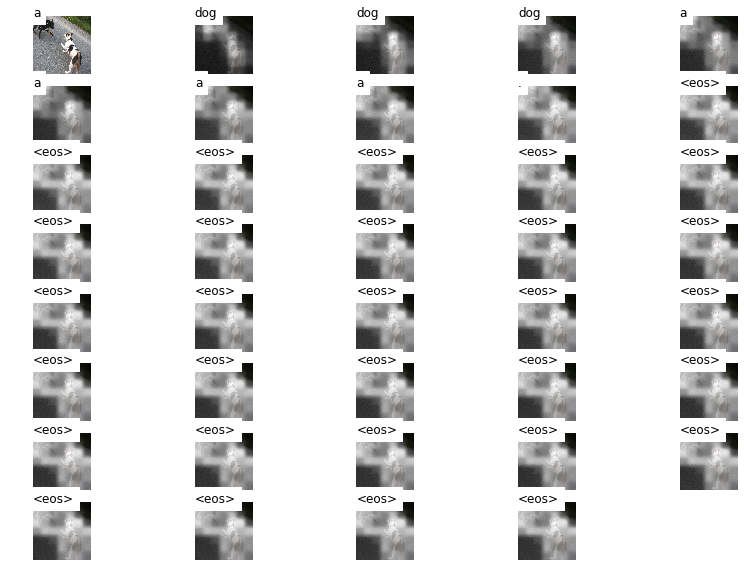


a man in a a a a a . . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


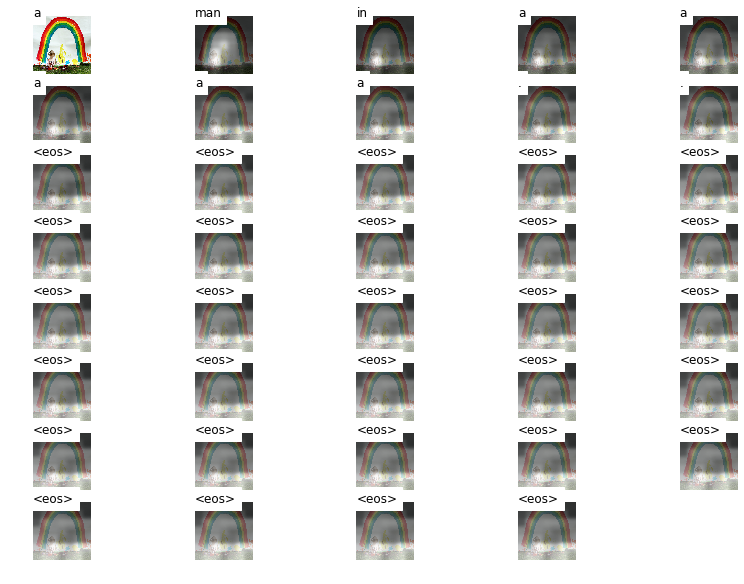

[10][loss: 5.26][pp:192.18]
[20][loss: 4.01][pp:55.08]
[30][loss: 4.01][pp:54.89]
[40][loss: 4.08][pp:59.24]
[50][loss: 4.01][pp:55.41]
[60][loss: 4.08][pp:59.35]
[70][loss: 4.03][pp:56.50]
[80][loss: 3.96][pp:52.22]
[90][loss: 4.03][pp:56.30]
[100][loss: 4.06][pp:57.96]
[110][loss: 4.08][pp:58.99]
[120][loss: 4.20][pp:66.73]
[130][loss: 4.06][pp:58.12]
[140][loss: 4.08][pp:59.31]
[150][loss: 4.05][pp:57.25]
[160][loss: 4.02][pp:55.91]
[170][loss: 4.07][pp:58.77]
[180][loss: 4.12][pp:61.69]
[190][loss: 4.08][pp:59.19]
[200][loss: 4.17][pp:64.93]
[210][loss: 4.06][pp:57.88]
[220][loss: 4.00][pp:54.75]
[230][loss: 4.08][pp:58.94]
[240][loss: 4.09][pp:59.65]
[250][loss: 3.97][pp:52.77]
a man in a a a a a a a <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


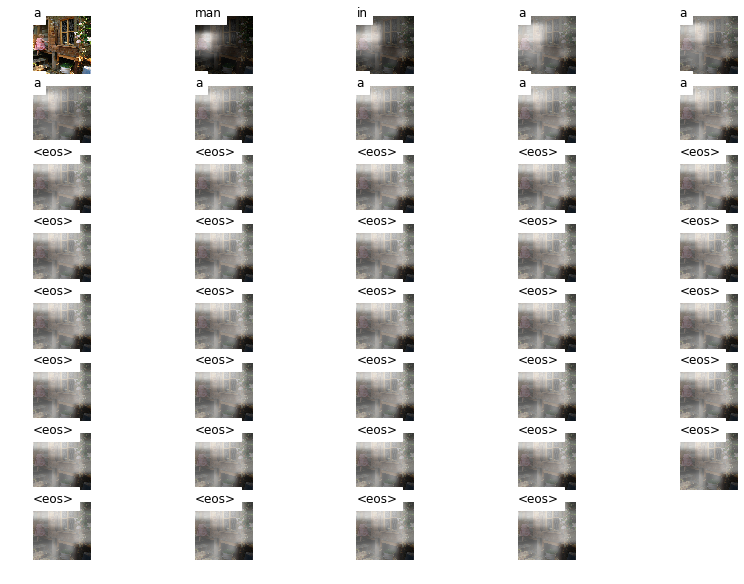


a dog dog dog a a a a . . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


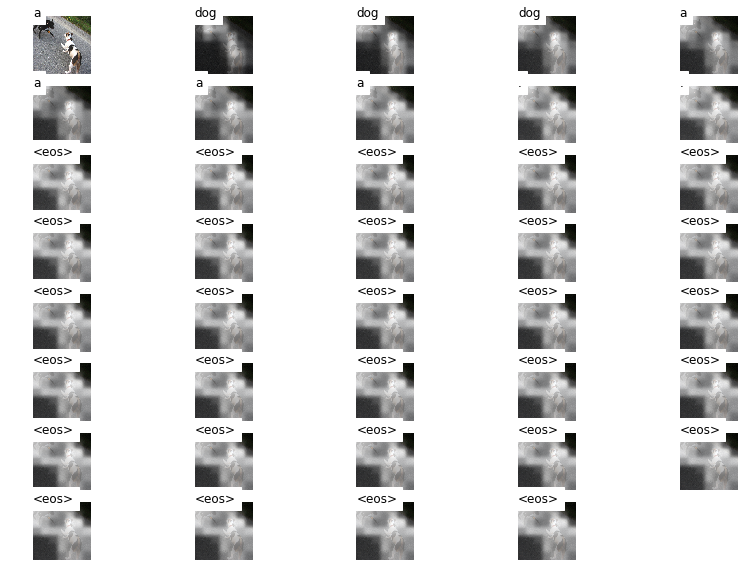


a man in a a a a a . . <eos> . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


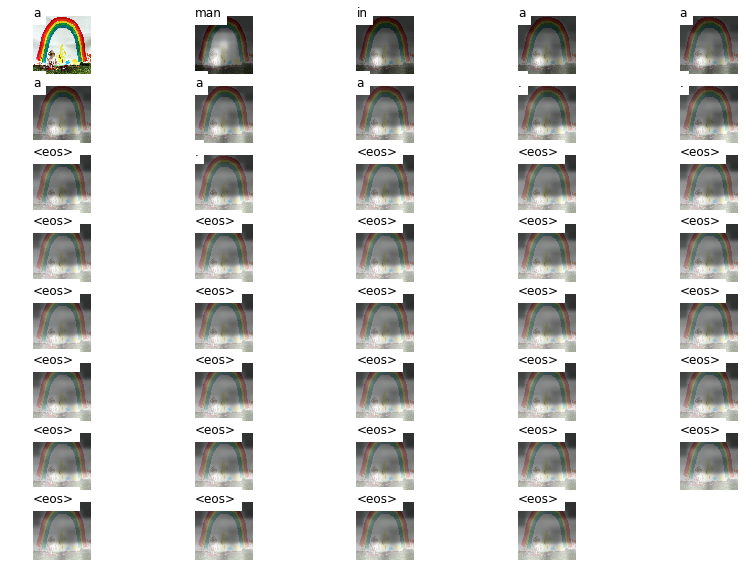

[10][loss: 5.27][pp:193.93]
[20][loss: 4.07][pp:58.39]
[30][loss: 3.99][pp:54.01]
[40][loss: 3.97][pp:53.03]
[50][loss: 4.01][pp:55.09]
[60][loss: 3.96][pp:52.49]
[70][loss: 4.01][pp:55.26]
[80][loss: 4.05][pp:57.50]
[90][loss: 4.09][pp:60.03]
[100][loss: 4.04][pp:56.82]
[110][loss: 3.98][pp:53.31]
[120][loss: 4.00][pp:54.61]
[130][loss: 4.03][pp:56.25]
[140][loss: 4.01][pp:55.16]
[150][loss: 3.99][pp:54.19]
[160][loss: 4.03][pp:56.28]
[170][loss: 4.05][pp:57.60]
[180][loss: 3.97][pp:52.79]
[190][loss: 4.04][pp:56.81]
[200][loss: 4.08][pp:59.41]
[210][loss: 4.04][pp:56.61]
[220][loss: 4.05][pp:57.62]
[230][loss: 4.07][pp:58.84]
[240][loss: 3.99][pp:53.82]
[250][loss: 4.04][pp:56.96]
a man in a a a a a a a <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


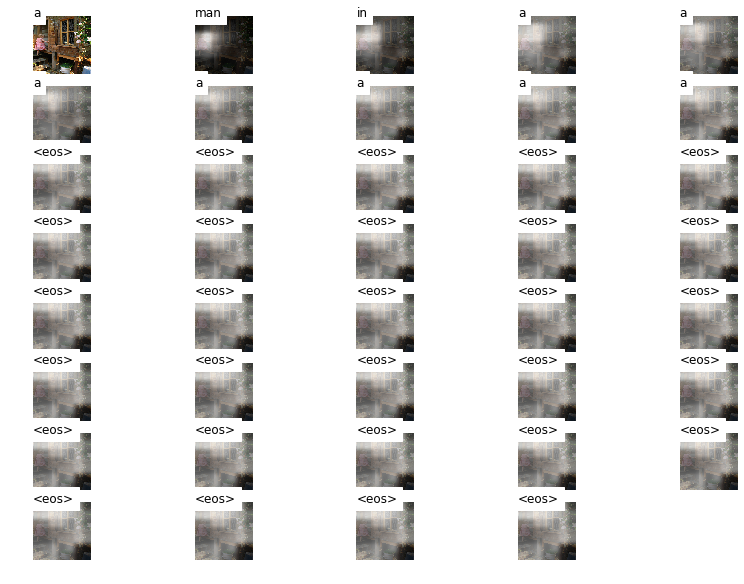


a dog dog dog a a a a . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


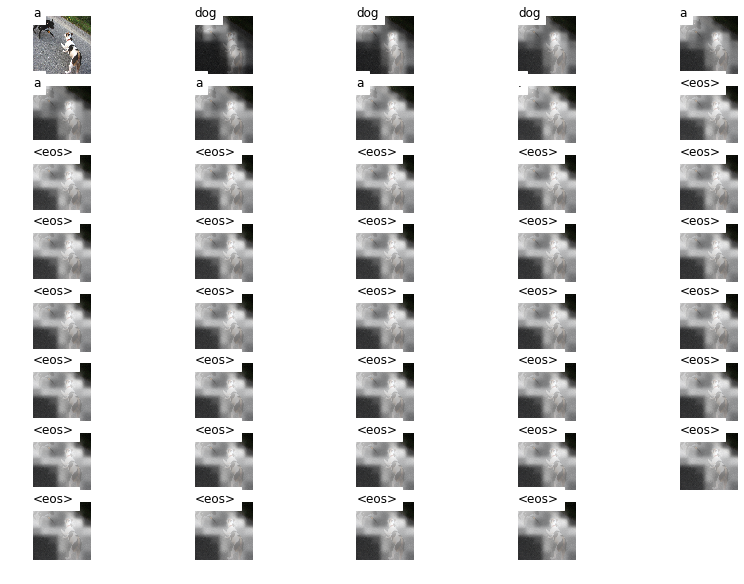


a man in a a a a a . . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


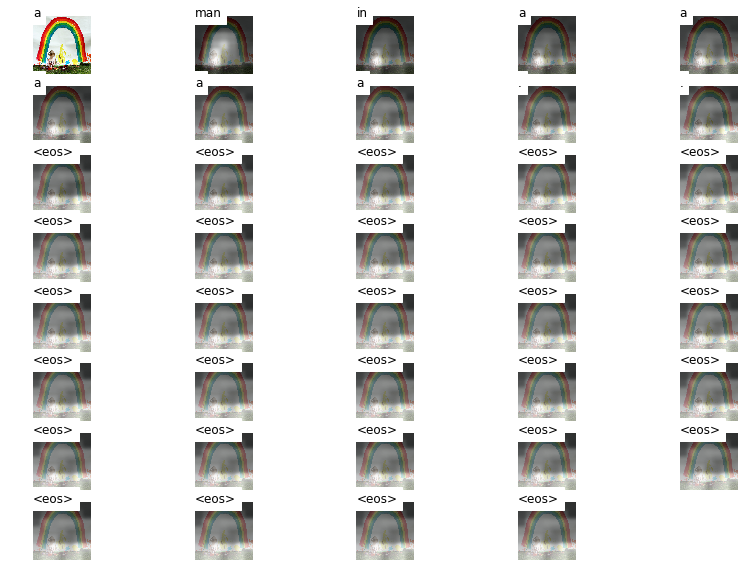

[10][loss: 5.22][pp:184.13]
[20][loss: 3.97][pp:53.24]
[30][loss: 3.93][pp:50.71]
[40][loss: 3.91][pp:50.08]
[50][loss: 3.88][pp:48.42]
[60][loss: 3.99][pp:54.31]
[70][loss: 3.97][pp:52.96]
[80][loss: 3.95][pp:51.68]
[90][loss: 3.92][pp:50.17]
[100][loss: 3.90][pp:49.48]
[110][loss: 3.86][pp:47.43]
[120][loss: 4.01][pp:55.05]
[130][loss: 3.98][pp:53.36]
[140][loss: 4.08][pp:59.42]
[150][loss: 3.87][pp:47.99]
[160][loss: 3.97][pp:53.19]
[170][loss: 3.97][pp:53.12]
[180][loss: 4.04][pp:56.67]
[190][loss: 3.89][pp:48.72]
[200][loss: 3.99][pp:54.27]
[210][loss: 4.02][pp:55.74]
[220][loss: 3.88][pp:48.39]
[230][loss: 3.94][pp:51.42]
[240][loss: 4.08][pp:59.25]
[250][loss: 3.95][pp:51.85]
a man in a a a a a a <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


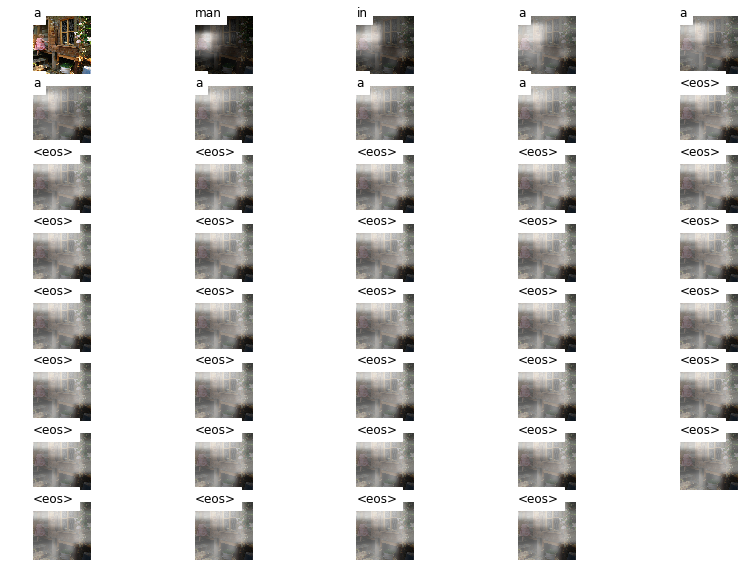


a dog dog dog a a a a . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


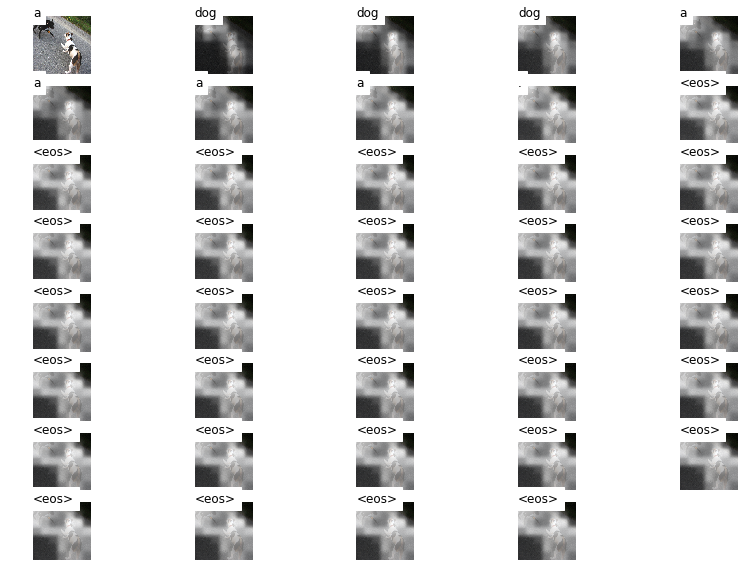


a man in a a a a a . . <eos> . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


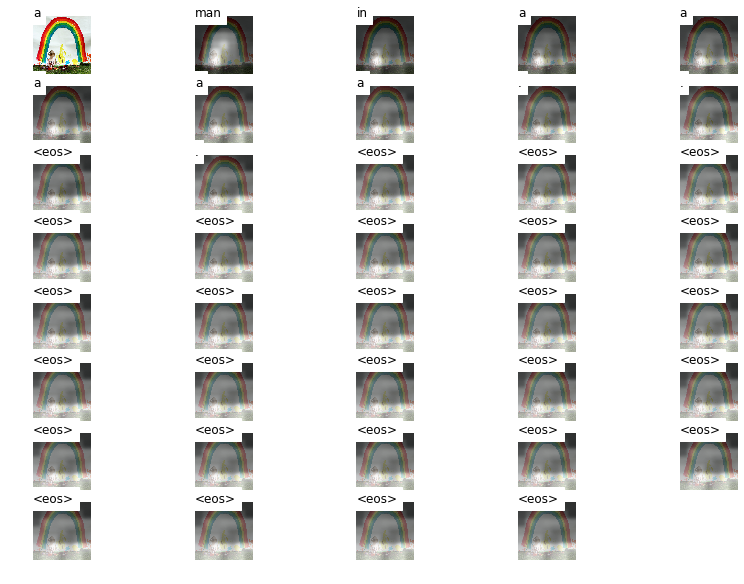

[10][loss: 5.22][pp:185.81]
[20][loss: 3.87][pp:47.76]
[30][loss: 3.98][pp:53.60]
[40][loss: 3.91][pp:49.92]
[50][loss: 3.93][pp:51.05]
[60][loss: 3.92][pp:50.27]
[70][loss: 3.98][pp:53.30]
[80][loss: 3.91][pp:49.98]
[90][loss: 4.00][pp:54.48]
[100][loss: 3.95][pp:51.99]
[110][loss: 3.93][pp:51.12]
[120][loss: 3.99][pp:54.16]
[130][loss: 3.98][pp:53.45]
[140][loss: 3.99][pp:54.15]
[150][loss: 3.93][pp:51.16]
[160][loss: 3.94][pp:51.35]
[170][loss: 3.98][pp:53.70]
[180][loss: 3.98][pp:53.69]
[190][loss: 3.95][pp:51.90]
[200][loss: 3.94][pp:51.64]
[210][loss: 3.95][pp:52.09]
[220][loss: 4.02][pp:55.90]
[230][loss: 3.89][pp:48.77]
[240][loss: 4.01][pp:55.20]
[250][loss: 4.00][pp:54.61]
a man in a a a a a a <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


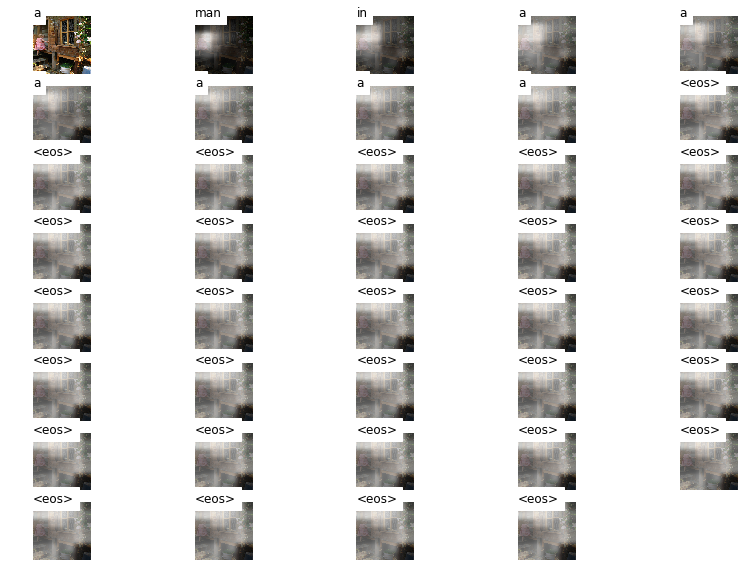


a dog dog dog a a a a . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


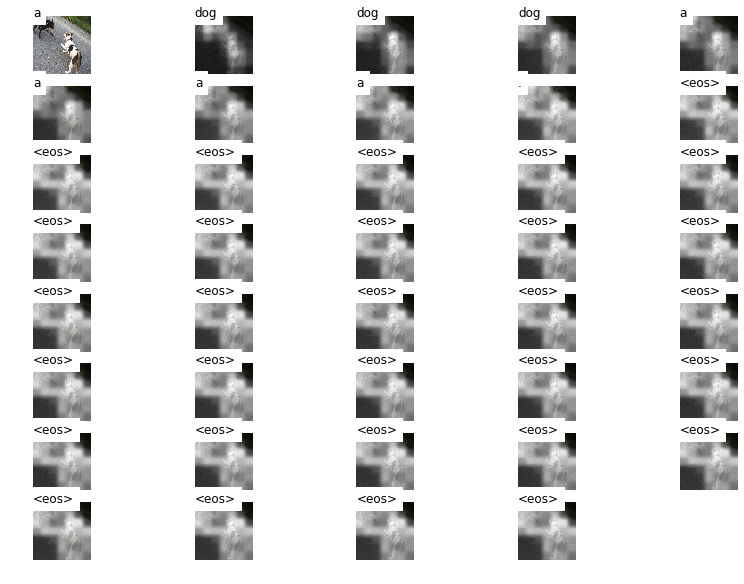


a man in a a a a a . . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


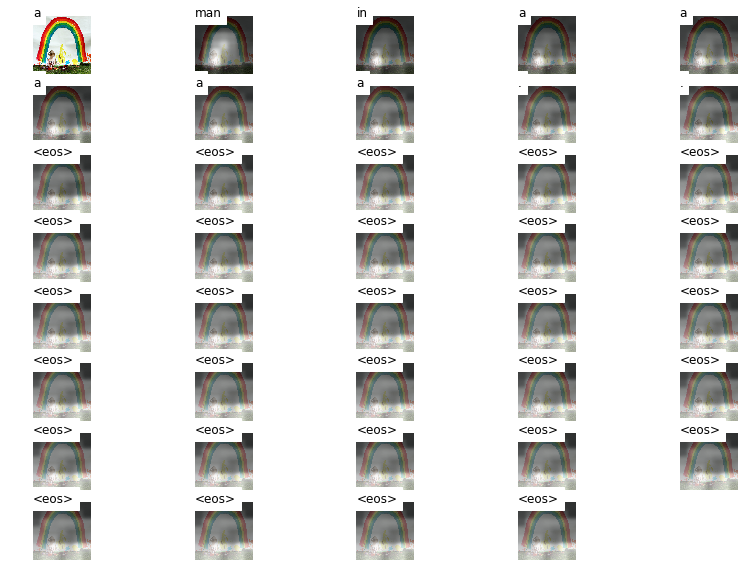

[10][loss: 4.99][pp:146.32]
[20][loss: 3.89][pp:48.77]
[30][loss: 3.97][pp:53.07]
[40][loss: 3.86][pp:47.46]
[50][loss: 3.88][pp:48.29]
[60][loss: 3.96][pp:52.65]
[70][loss: 3.89][pp:49.15]
[80][loss: 3.94][pp:51.42]
[90][loss: 3.94][pp:51.21]


Traceback (most recent call last):
Traceback (most recent call last):
  File "/Users/maxim/miniconda3/lib/python3.6/multiprocessing/queues.py", line 240, in _feed
    send_bytes(obj)
  File "/Users/maxim/miniconda3/lib/python3.6/multiprocessing/connection.py", line 200, in send_bytes
    self._send_bytes(m[offset:offset + size])
  File "/Users/maxim/miniconda3/lib/python3.6/multiprocessing/connection.py", line 404, in _send_bytes
    self._send(header + buf)
  File "/Users/maxim/miniconda3/lib/python3.6/multiprocessing/connection.py", line 368, in _send
    n = write(self._handle, buf)
BrokenPipeError: [Errno 32] Broken pipe
  File "/Users/maxim/miniconda3/lib/python3.6/multiprocessing/queues.py", line 240, in _feed
    send_bytes(obj)
  File "/Users/maxim/miniconda3/lib/python3.6/multiprocessing/connection.py", line 200, in send_bytes
    self._send_bytes(m[offset:offset + size])
  File "/Users/maxim/miniconda3/lib/python3.6/multiprocessing/connection.py", line 404, in _send_bytes
   

KeyboardInterrupt: 

In [426]:
%%time

n_epochs = 20
lr = 1e-3
grad_clip = 10.0

optimizer = optim.Adam(img2seq.parameters(), lr=lr)

total_loss = 0
decoder.train()
for epoch in tqdm(range(n_epochs)):
    for i, batch in enumerate(tqdm(dataloader)):
        # unpack batch
        encoder_out = batch[0].to(device) # (b, enc_img_size, enc_img_size, enc_dim)
        encoded_captions = batch[1].to(device).transpose(1, 0).contiguous() # (max_len, b)
        
        optimizer.zero_grad()
        
        # apply model
        # outputs = (max_len, b, vocab_size)
        # alpha = (max_len, b, num_pixels)
        outputs, alphas = img2seq(encoder_out, bos_token, max_len)
        
        # calculate nll loss
        # 1) don't take into account first token (it's always <sos>)
        # 2) don't take into account pad token (ignore_index argument)
        loss = F.nll_loss(outputs[1:].view(-1, vocab_size), encoded_captions[1:].view(-1), ignore_index=pad_token)
        
        loss.backward()
        
        # clip gradients using nn.utils.clip_grad_norm_ by `grad_clip` value
        nn.utils.clip_grad_norm_(img2seq.parameters(), grad_clip)
        
        optimizer.step()
        total_loss += loss.item()

        if i % 10 == 0 and i != 0:
            total_loss = total_loss / 10
            print("[%d][loss:%5.2f][pp:%5.2f]" % (i, total_loss, np.exp(total_loss)))
            total_loss = 0
           
    for i in range(3):
        image_path = os.path.join('./data/Flicker8k_Dataset/', dataset.test_ids[i])
        encoder_out = dataset._getitem_by_img_id(dataset.test_ids[i])[0]
        plot_pred(encoder_out, image_path)
        print()
        

[10][loss: 4.27][pp:71.43]
[20][loss: 3.87][pp:48.14]
[30][loss: 3.86][pp:47.29]
[40][loss: 3.80][pp:44.90]
[50][loss: 3.94][pp:51.17]
[60][loss: 3.85][pp:47.15]
[70][loss: 3.78][pp:43.89]
[80][loss: 3.73][pp:41.69]
[90][loss: 3.90][pp:49.44]
[100][loss: 3.85][pp:46.91]
[110][loss: 3.89][pp:48.96]
[120][loss: 3.85][pp:47.05]
[130][loss: 3.73][pp:41.78]
[140][loss: 3.84][pp:46.30]
[150][loss: 3.83][pp:46.22]
[160][loss: 3.68][pp:39.53]
[170][loss: 3.77][pp:43.22]
[180][loss: 3.81][pp:45.09]
[190][loss: 3.77][pp:43.59]
[200][loss: 3.75][pp:42.48]
[210][loss: 3.81][pp:44.99]
[220][loss: 3.75][pp:42.71]
[230][loss: 3.87][pp:48.13]
[240][loss: 3.82][pp:45.57]
[250][loss: 3.76][pp:42.91]
a man in a a a a a a <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


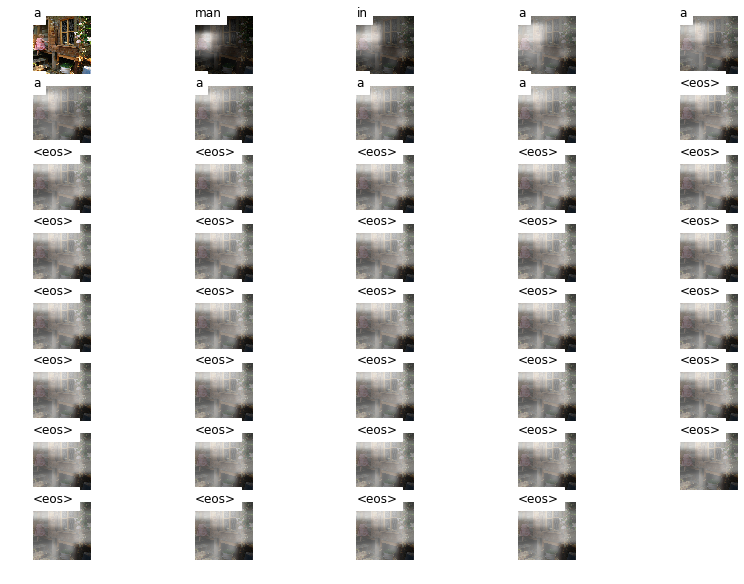


a dog dog dog a a a a . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


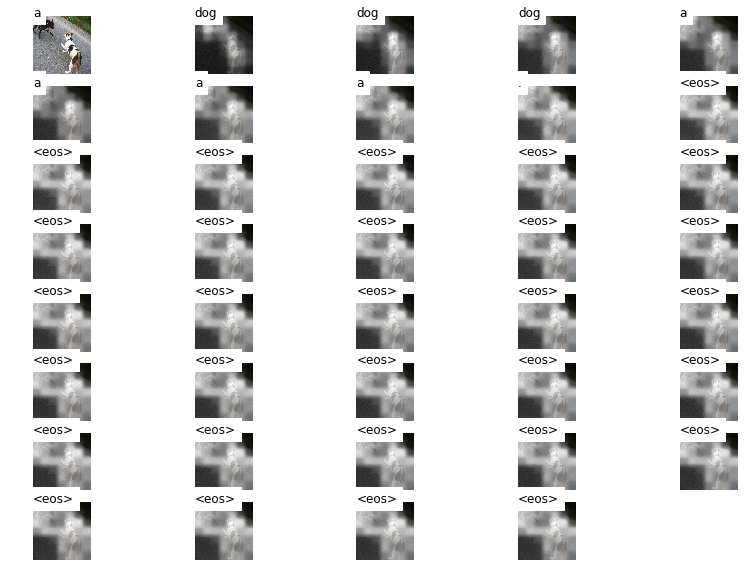


a man in a a a a a . . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


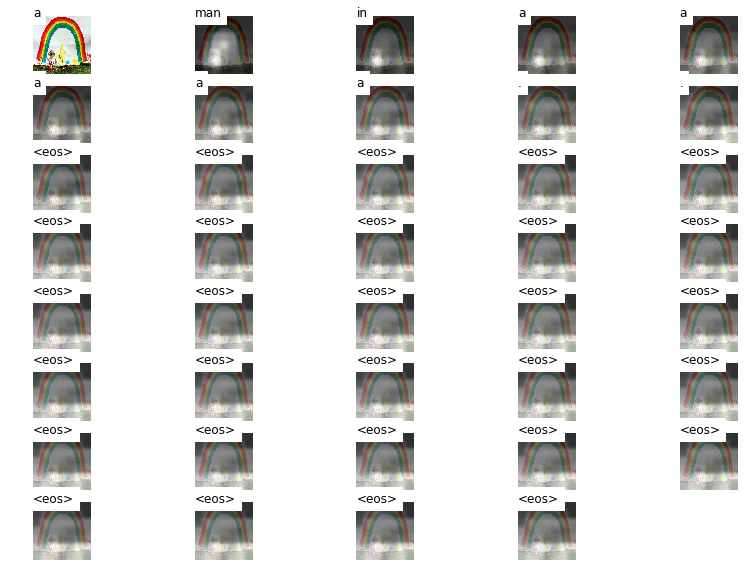

[10][loss: 4.82][pp:124.17]
[20][loss: 3.71][pp:41.02]
[30][loss: 3.76][pp:42.79]
[40][loss: 3.78][pp:43.60]
[50][loss: 3.76][pp:43.15]
[60][loss: 3.80][pp:44.52]
[70][loss: 3.74][pp:42.20]
[80][loss: 3.72][pp:41.23]
[90][loss: 3.79][pp:44.24]
[100][loss: 3.74][pp:42.26]
[110][loss: 3.77][pp:43.55]
[120][loss: 3.73][pp:41.85]
[130][loss: 3.73][pp:41.61]
[140][loss: 3.74][pp:42.23]
[150][loss: 3.84][pp:46.34]
[160][loss: 3.74][pp:41.94]
[170][loss: 3.77][pp:43.43]
[180][loss: 3.79][pp:44.19]
[190][loss: 3.76][pp:42.89]
[200][loss: 3.82][pp:45.45]
[210][loss: 3.78][pp:43.92]
[220][loss: 3.76][pp:43.00]
[230][loss: 3.81][pp:45.33]
[240][loss: 3.76][pp:42.90]
[250][loss: 3.84][pp:46.64]
a man in a a a a a a <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


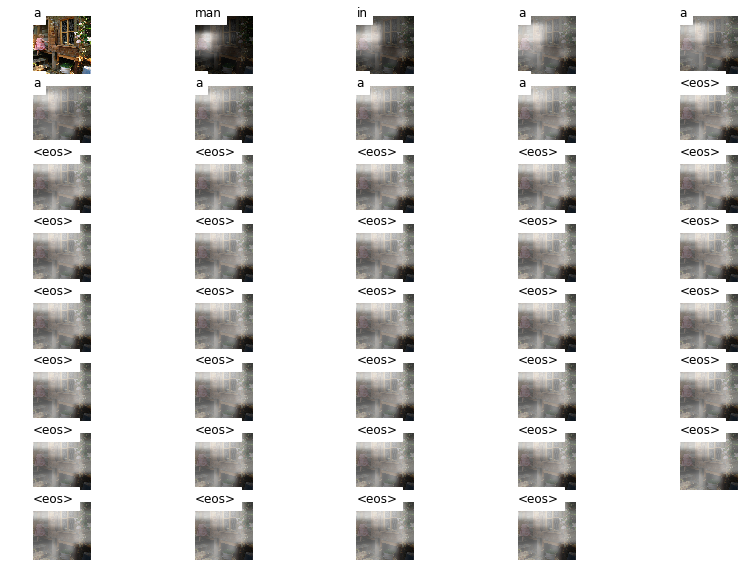


a dog dog dog a a a a . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


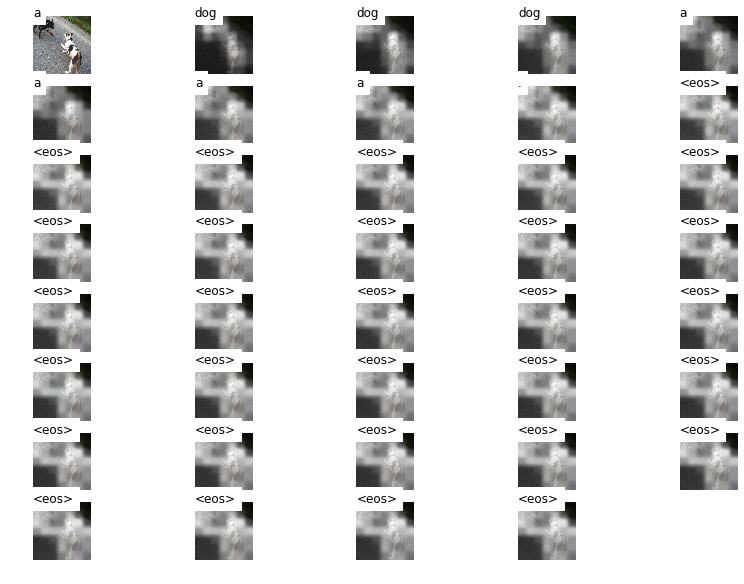


a man in a a a a a . . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


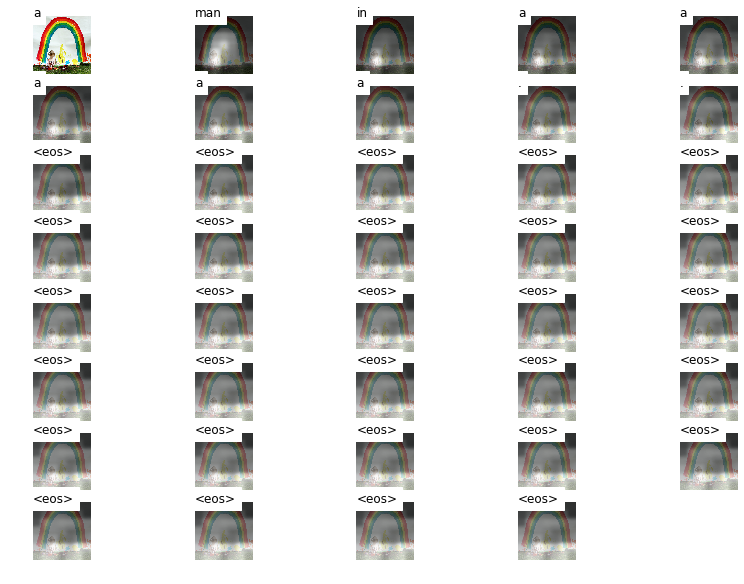

[10][loss: 4.84][pp:125.87]
[20][loss: 3.72][pp:41.12]
[30][loss: 3.67][pp:39.42]
[40][loss: 3.70][pp:40.59]
[50][loss: 3.73][pp:41.62]
[60][loss: 3.69][pp:40.12]
[70][loss: 3.70][pp:40.45]
[80][loss: 3.75][pp:42.33]
[90][loss: 3.67][pp:39.20]
[100][loss: 3.71][pp:40.76]
[110][loss: 3.72][pp:41.17]
[120][loss: 3.78][pp:43.63]
[130][loss: 3.68][pp:39.65]
[140][loss: 3.72][pp:41.26]
[150][loss: 3.72][pp:41.19]
[160][loss: 3.74][pp:41.95]
[170][loss: 3.67][pp:39.20]
[180][loss: 3.76][pp:42.76]
[190][loss: 3.72][pp:41.16]
[200][loss: 3.69][pp:40.20]
[210][loss: 3.69][pp:39.98]
[220][loss: 3.66][pp:38.96]
[230][loss: 3.73][pp:41.62]
[240][loss: 3.70][pp:40.52]
[250][loss: 3.67][pp:39.36]
a man in a a a a a a a <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


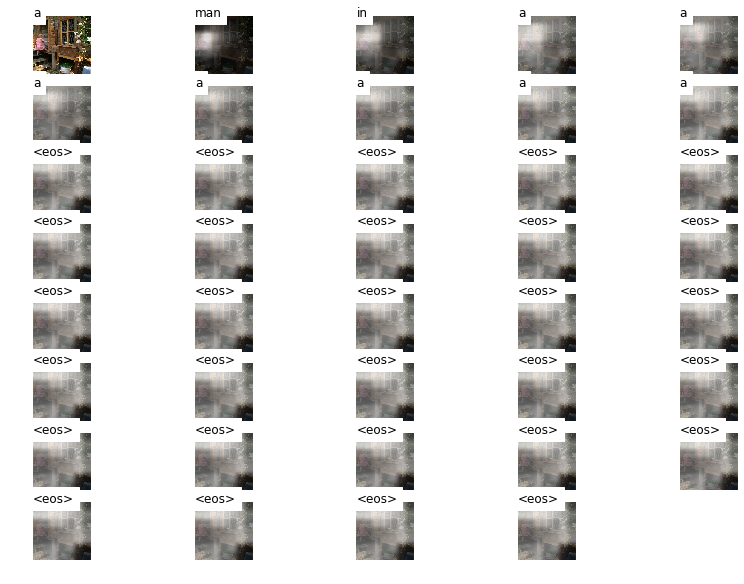


a dog dog dog a a a a . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


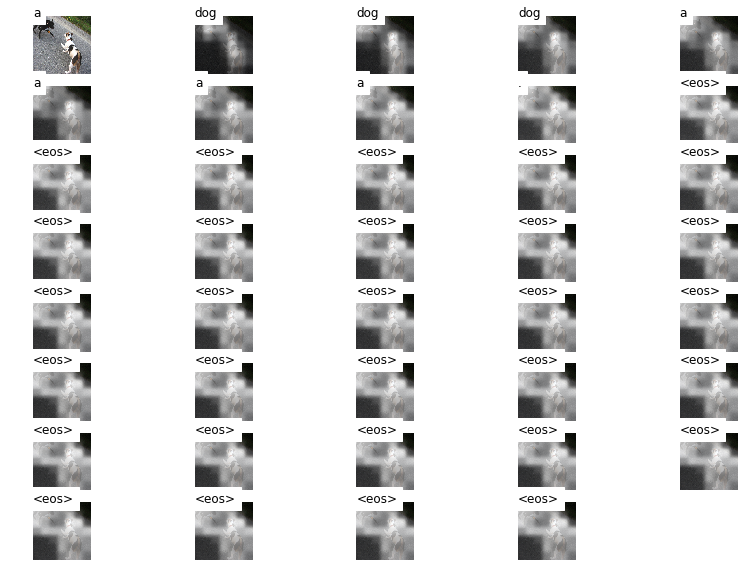


a man in a a a a a . . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


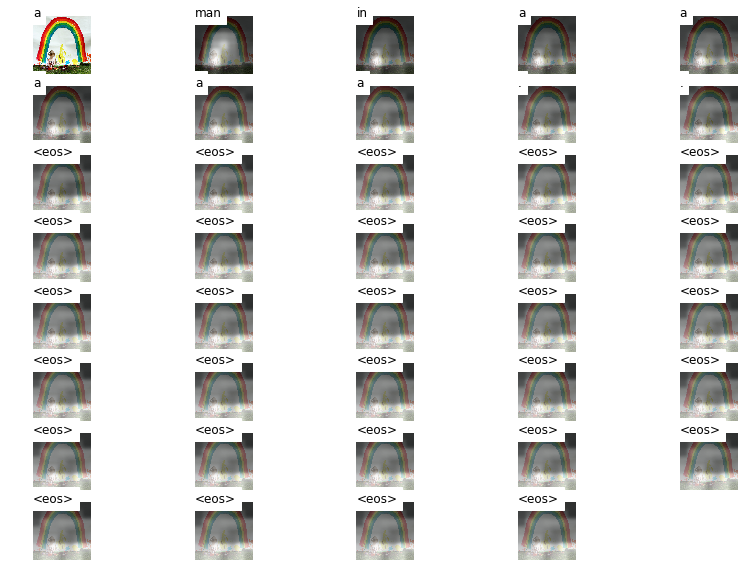

[10][loss: 4.85][pp:127.69]
[20][loss: 3.62][pp:37.30]
[30][loss: 3.66][pp:38.83]
[40][loss: 3.68][pp:39.75]
[50][loss: 3.65][pp:38.57]
[60][loss: 3.65][pp:38.51]
[70][loss: 3.61][pp:36.88]
[80][loss: 3.70][pp:40.29]
[90][loss: 3.70][pp:40.37]
[100][loss: 3.69][pp:40.09]
[110][loss: 3.61][pp:36.87]
[120][loss: 3.60][pp:36.51]
[130][loss: 3.68][pp:39.58]
[140][loss: 3.76][pp:42.89]
[150][loss: 3.78][pp:43.60]
[160][loss: 3.70][pp:40.38]
[170][loss: 3.70][pp:40.35]
[180][loss: 3.61][pp:37.03]
[190][loss: 3.64][pp:38.06]
[200][loss: 3.57][pp:35.44]
[210][loss: 3.69][pp:39.85]
[220][loss: 3.72][pp:41.38]
[230][loss: 3.64][pp:38.11]
[240][loss: 3.61][pp:36.91]
[250][loss: 3.70][pp:40.44]
a man in a a a a a a a <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


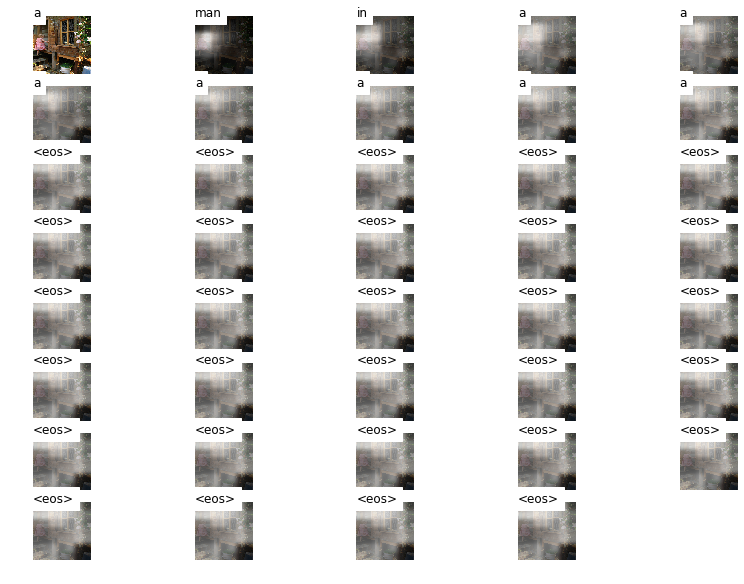


a dog dog dog a a a a . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


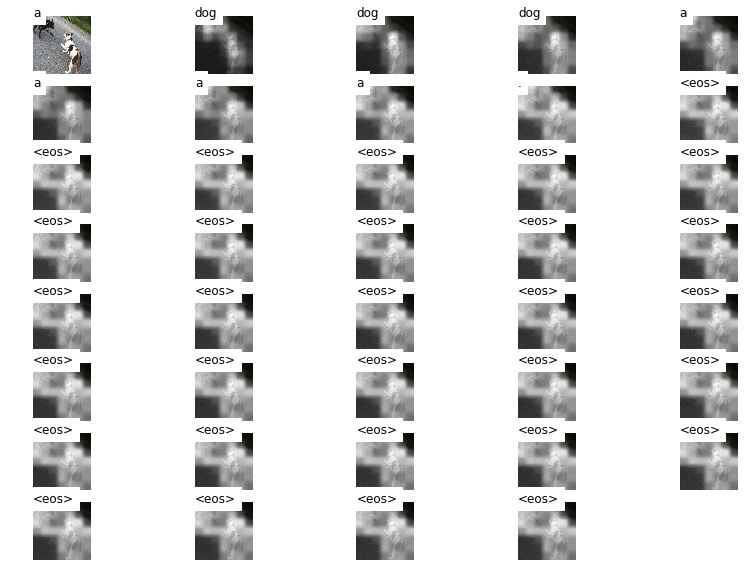


a man in a a a a a . . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


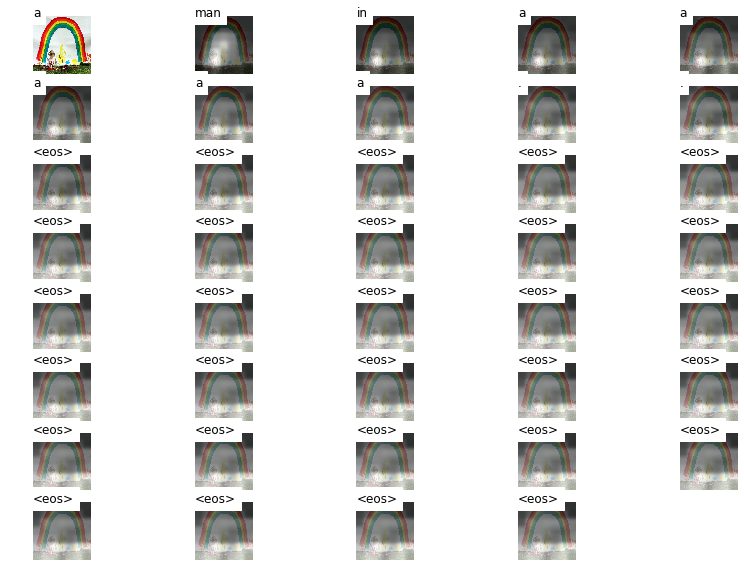

[10][loss: 4.73][pp:113.27]
[20][loss: 3.70][pp:40.44]
[30][loss: 3.62][pp:37.46]
[40][loss: 3.59][pp:36.37]
[50][loss: 3.62][pp:37.46]
[60][loss: 3.59][pp:36.11]
[70][loss: 3.58][pp:35.80]
[80][loss: 3.63][pp:37.53]
[90][loss: 3.65][pp:38.45]
[100][loss: 3.66][pp:38.98]
[110][loss: 3.62][pp:37.18]
[120][loss: 3.56][pp:35.24]
[130][loss: 3.66][pp:38.71]
[140][loss: 3.68][pp:39.48]
[150][loss: 3.62][pp:37.39]
[160][loss: 3.63][pp:37.53]
[170][loss: 3.70][pp:40.33]
[180][loss: 3.70][pp:40.59]
[190][loss: 3.60][pp:36.47]
[200][loss: 3.72][pp:41.20]
[210][loss: 3.62][pp:37.18]
[220][loss: 3.68][pp:39.52]
[230][loss: 3.68][pp:39.68]
[240][loss: 3.65][pp:38.61]
[250][loss: 3.57][pp:35.67]
a man in a a a a a a <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


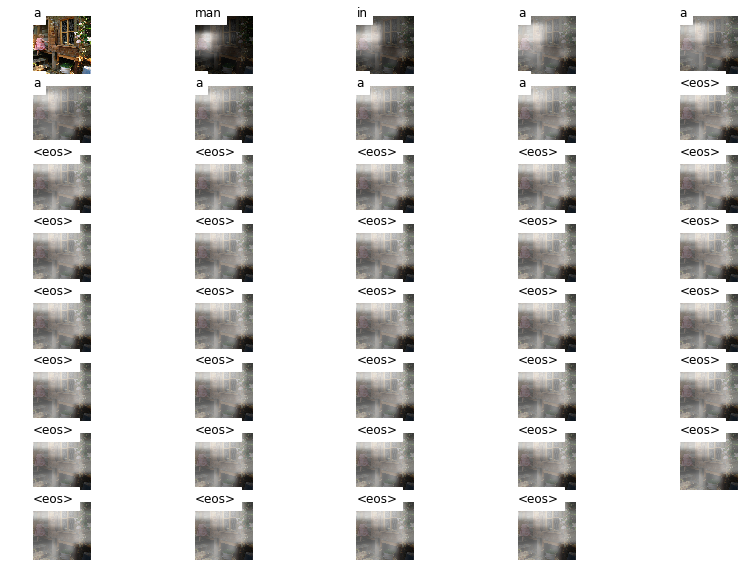


a dog dog dog a a a a . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


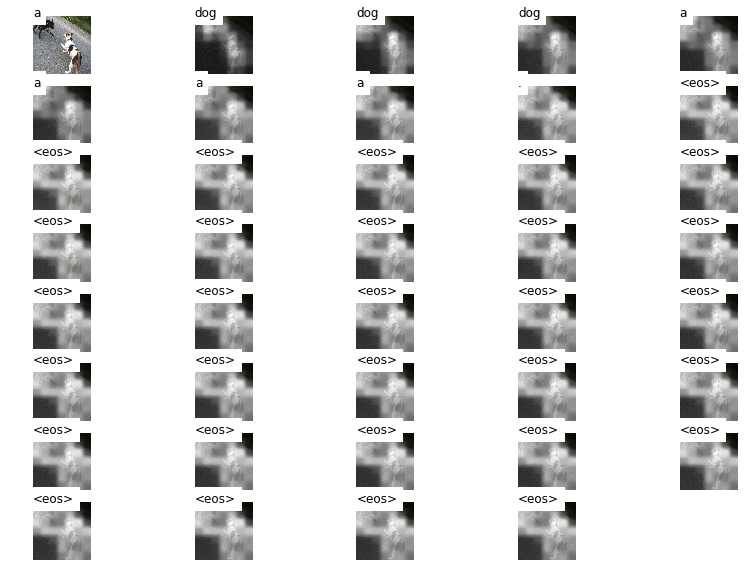


a man in a a a a a . . <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos> <eos>
----------------------------------------------------------------------------------------------------


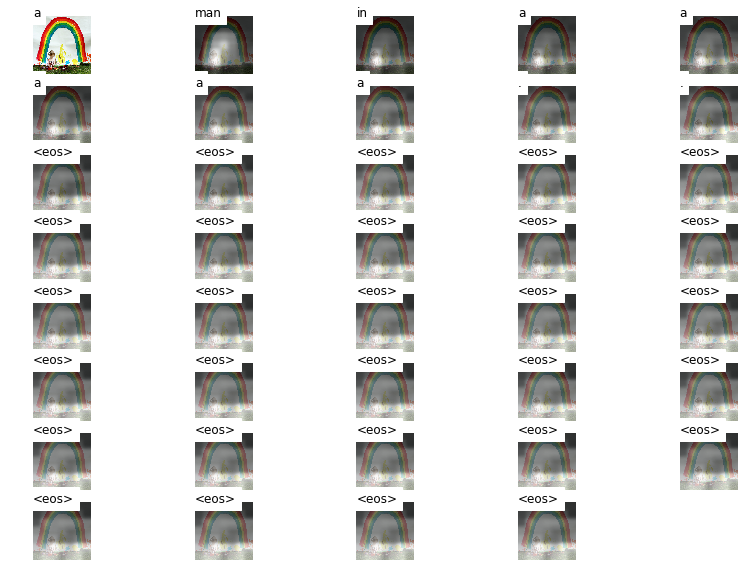

[10][loss: 4.65][pp:104.08]
[20][loss: 3.64][pp:37.91]
[30][loss: 3.55][pp:34.73]
[40][loss: 3.64][pp:37.96]
[50][loss: 3.65][pp:38.29]
[60][loss: 3.64][pp:38.18]
[70][loss: 3.58][pp:35.91]
[80][loss: 3.62][pp:37.29]
[90][loss: 3.56][pp:35.31]


Traceback (most recent call last):
Traceback (most recent call last):
  File "/Users/maxim/miniconda3/lib/python3.6/multiprocessing/queues.py", line 240, in _feed
    send_bytes(obj)
  File "/Users/maxim/miniconda3/lib/python3.6/multiprocessing/connection.py", line 200, in send_bytes
    self._send_bytes(m[offset:offset + size])
  File "/Users/maxim/miniconda3/lib/python3.6/multiprocessing/connection.py", line 404, in _send_bytes
    self._send(header + buf)
  File "/Users/maxim/miniconda3/lib/python3.6/multiprocessing/connection.py", line 368, in _send
    n = write(self._handle, buf)
BrokenPipeError: [Errno 32] Broken pipe
  File "/Users/maxim/miniconda3/lib/python3.6/multiprocessing/queues.py", line 240, in _feed
    send_bytes(obj)
  File "/Users/maxim/miniconda3/lib/python3.6/multiprocessing/connection.py", line 200, in send_bytes
    self._send_bytes(m[offset:offset + size])
  File "/Users/maxim/miniconda3/lib/python3.6/multiprocessing/connection.py", line 404, in _send_bytes
   

KeyboardInterrupt: 

In [431]:
%%time

n_epochs = 20
lr = 2e-4
grad_clip = 10.0

optimizer = optim.Adam(img2seq.parameters(), lr=lr)

total_loss = 0
decoder.train()
for epoch in tqdm(range(n_epochs)):
    for i, batch in enumerate(tqdm(dataloader)):
        # unpack batch
        encoder_out = batch[0].to(device) # (b, enc_img_size, enc_img_size, enc_dim)
        encoded_captions = batch[1].to(device).transpose(1, 0).contiguous() # (max_len, b)
        
        optimizer.zero_grad()
        
        # apply model
        # outputs = (max_len, b, vocab_size)
        # alpha = (max_len, b, num_pixels)
        outputs, alphas = img2seq(encoder_out, bos_token, max_len)
        
        # calculate nll loss
        # 1) don't take into account first token (it's always <sos>)
        # 2) don't take into account pad token (ignore_index argument)
        loss = F.nll_loss(outputs[1:].view(-1, vocab_size), encoded_captions[1:].view(-1), ignore_index=pad_token)
        
        loss.backward()
        
        # clip gradients using nn.utils.clip_grad_norm_ by `grad_clip` value
        nn.utils.clip_grad_norm_(img2seq.parameters(), grad_clip)
        
        optimizer.step()
        total_loss += loss.item()

        if i % 10 == 0 and i != 0:
            total_loss = total_loss / 10
            print("[%d][loss:%5.2f][pp:%5.2f]" % (i, total_loss, np.exp(total_loss)))
            total_loss = 0
           
    for i in range(3):
        image_path = os.path.join('./data/Flicker8k_Dataset/', dataset.test_ids[i])
        encoder_out = dataset._getitem_by_img_id(dataset.test_ids[i])[0]
        plot_pred(encoder_out, image_path)
        print()
        

# Beam Search

In [432]:
class Img2SeqBeamSearch(nn.Module):
    def __init__(self, decoder):#, encoder):
        super().__init__()
#         self.encoder = encoder
        self.decoder = decoder

    def forward(self, encoder_out, bos_token, max_len, beam_size=10, eos_token=eos_token):
        """Image-to-sequence inference

        Args:
            encoder_out: (torch tensor of shape (b, enc_img_size, enc_img_size, enc_dim)): encoded images
        
        Returns:
            outputs (torch tensor of shape (max_len, b, vocab_size)): ouput token distribution
            alphas (torch tensor of shape (max_len, b, num_pixels)): attention weights
        """
        device = encoder_out.device
        batch_size = encoder_out.shape[0]
        vocab_size = self.decoder.vocab_size
        encoder_dim = encoder_out.shape[3]
        assert encoder_out.shape[1] == encoder_out.shape[2]
        num_pixels = encoder_out.shape[1] * encoder_out.shape[2]

        hidden = None
        ceil = None
        output = torch.full((batch_size,), bos_token, dtype=torch.long).to(device) # (b, )
        
        outputs = torch.zeros(max_len, batch_size, vocab_size).to(device)
        alphas = torch.ones(max_len, batch_size, num_pixels).to(device)
        score = 1.0
        sequences = [[outputs, alphas, score, output, hidden, ceil]]
        
        for t in range(1, max_len):
            candidates = []
            for outputs, alphas, score, output, hidden, ceil in sequences:
                if output == eos_token:
                    candidates.append([outputs, alphas, score, output, hidden, ceil])
                    continue
                # output = (b, vocab_size)
                # alpha = (b, num_pixels)
                # hidden = (1, b, h)
                # ceil = (1, b, h)
                output, alpha, hidden, ceil = self.decoder(output, encoder_out, hidden, ceil) ## apply decoder
                outputs[t] = output
                alphas[t] = alpha

                top_scores, top_output = F.softmax(output, dim=1).data.topk(beam_size, 1) # (b, beam_size), (b, beam_size)
                for j in range(beam_size):
                    cur_score = -torch.log(top_scores[:, j]).numpy() * score
                    candidates.append([
                        outputs.clone(), alphas.clone(), cur_score, top_output[:, j], hidden.clone(), ceil.clone()
                    ])
            
            ordered = sorted(candidates, key=lambda tup: tup[2])
            sequences = ordered[:beam_size]
        
        outputs, alphas, score, output, hidden, ceil = sequences[0]
        return outputs, alphas

In [433]:
img2seq_beam_search = Img2SeqBeamSearch(decoder).to(device)

## Сгенерируем описание для 20 отложенных изображений

a man in a a a a a a
----------------------------------------------------------------------------------------------------


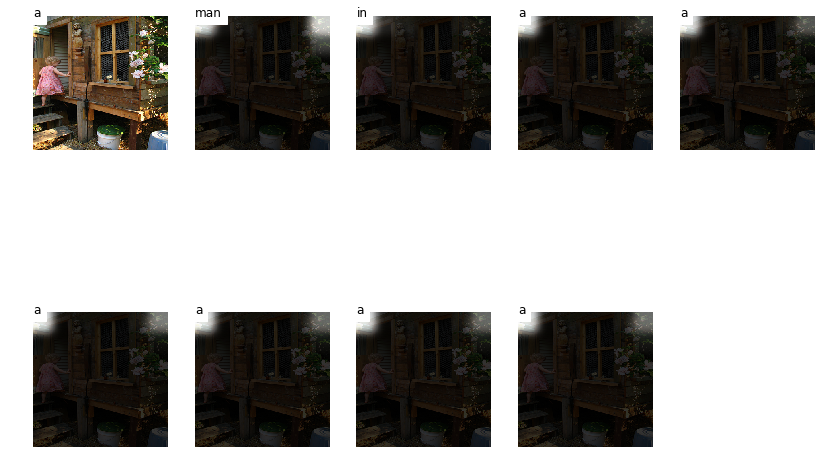

a black dog white dog a a a a a
----------------------------------------------------------------------------------------------------


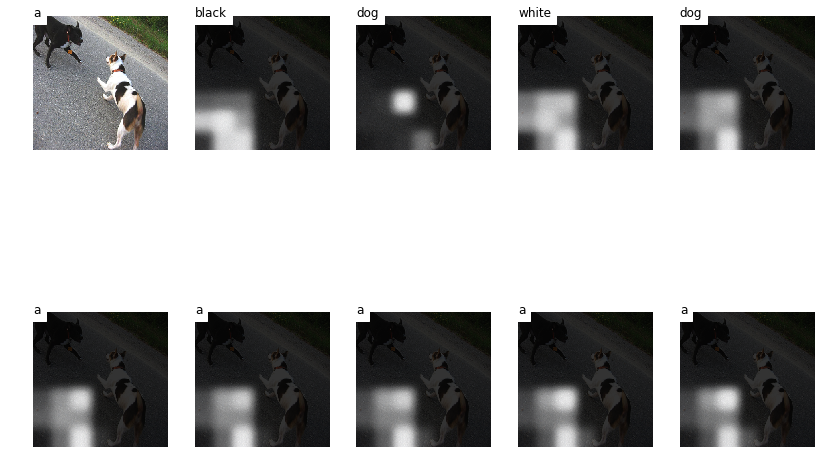

a boy boy a a a a a
----------------------------------------------------------------------------------------------------


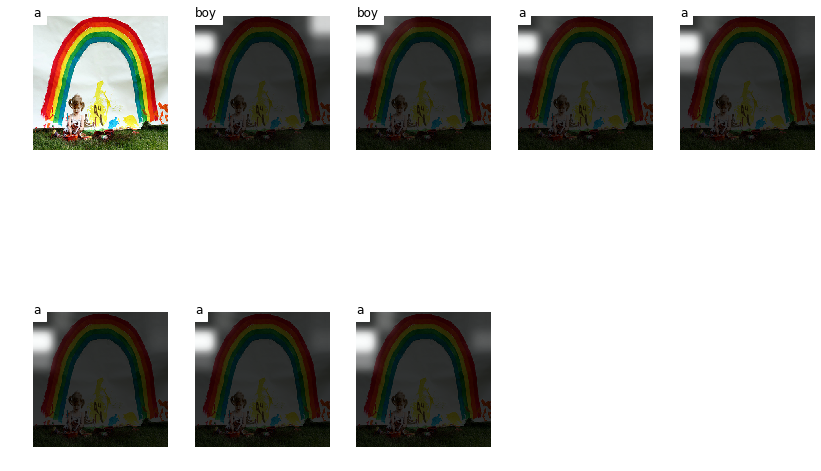

a man in a a a a a a
----------------------------------------------------------------------------------------------------


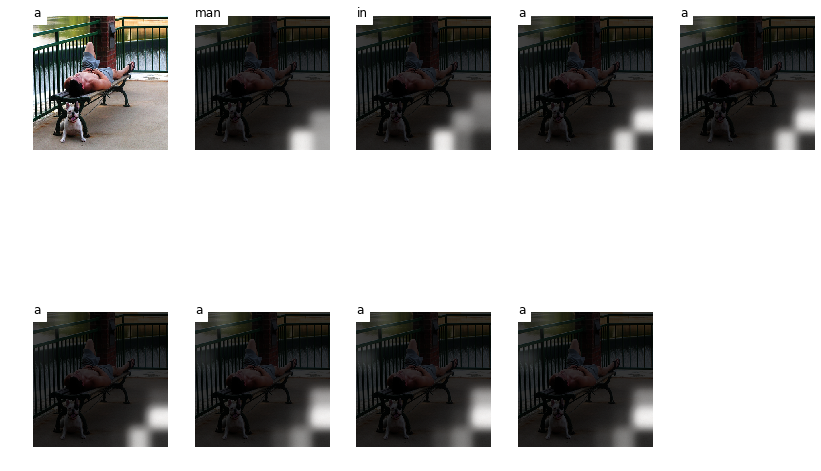

a man with a hat hat hat hat hat
----------------------------------------------------------------------------------------------------


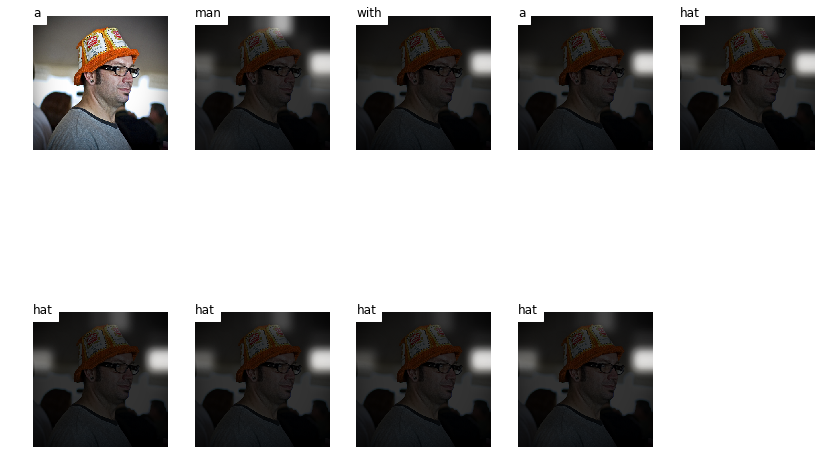

a little in in a a a a
----------------------------------------------------------------------------------------------------


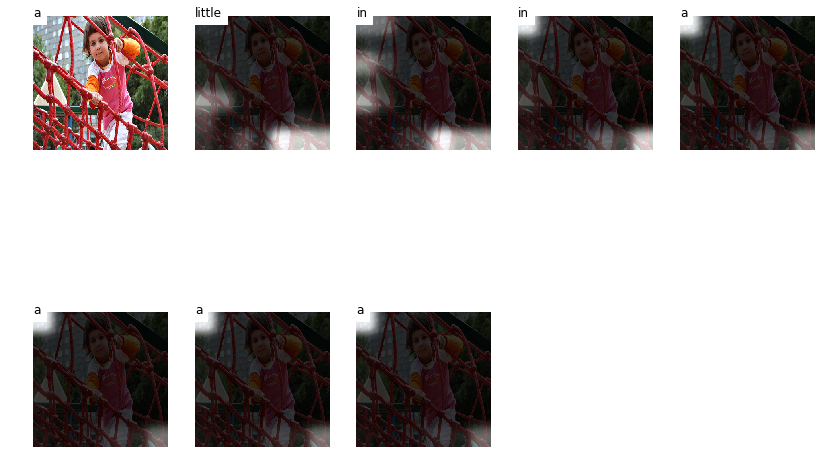

a dog and white a a a a
----------------------------------------------------------------------------------------------------


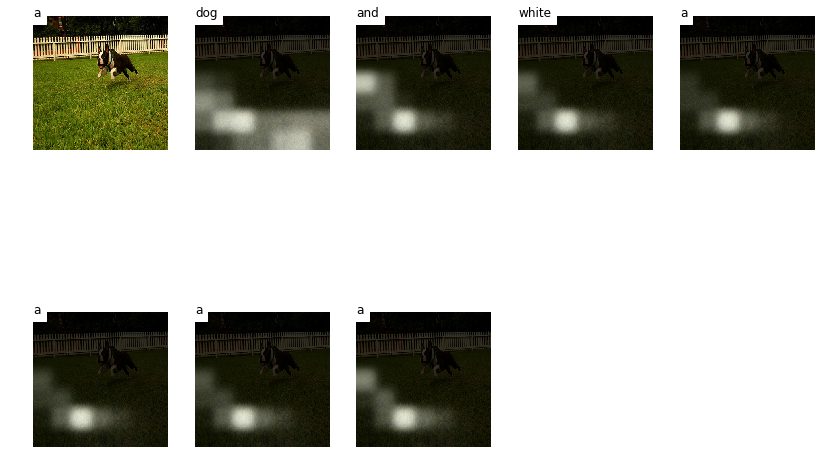

a brown dog is a the the a .
----------------------------------------------------------------------------------------------------


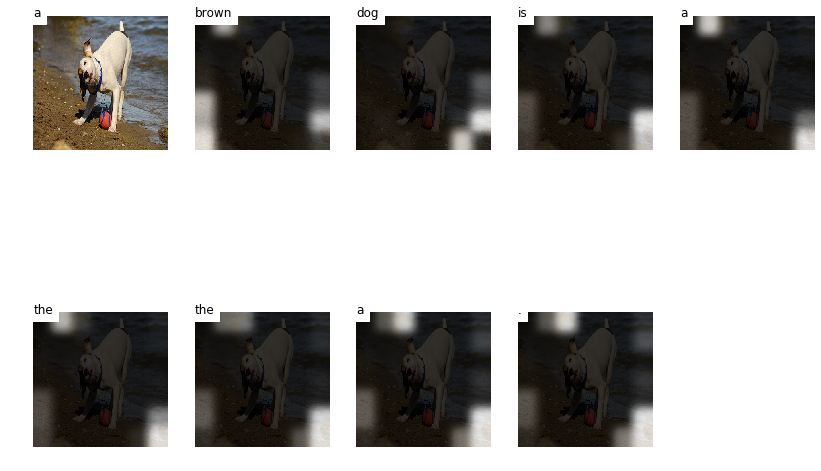

a man in a a shirt a a
----------------------------------------------------------------------------------------------------


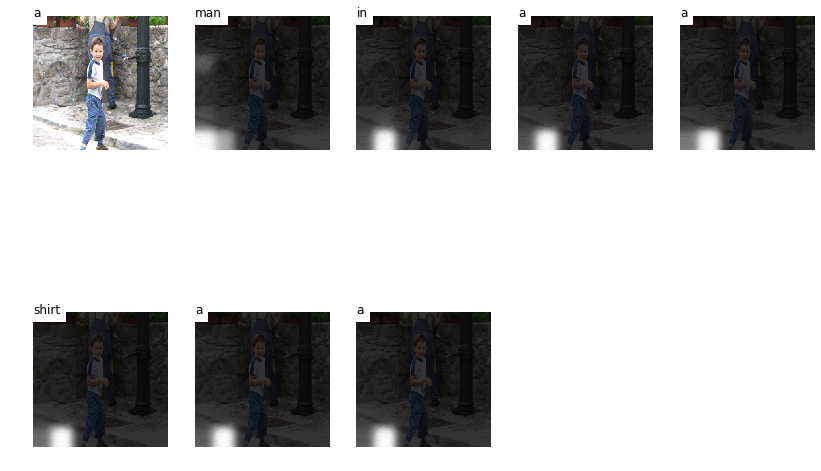

a black dog is a a a .
----------------------------------------------------------------------------------------------------


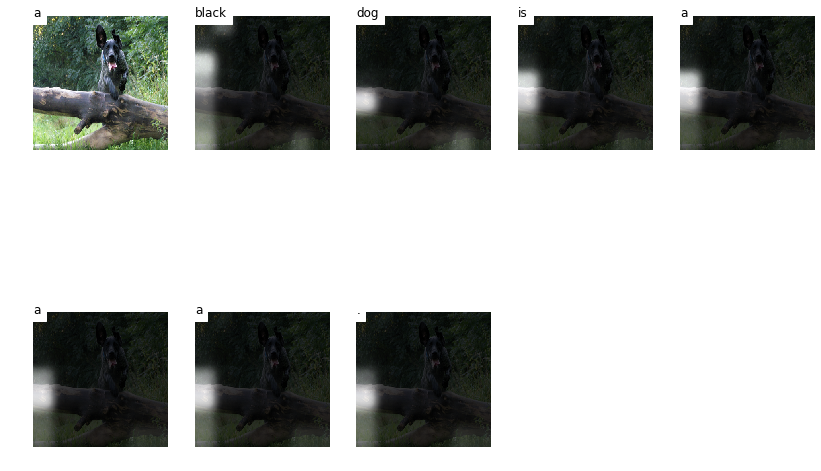

a white dog white snow snow snow snow snow
----------------------------------------------------------------------------------------------------


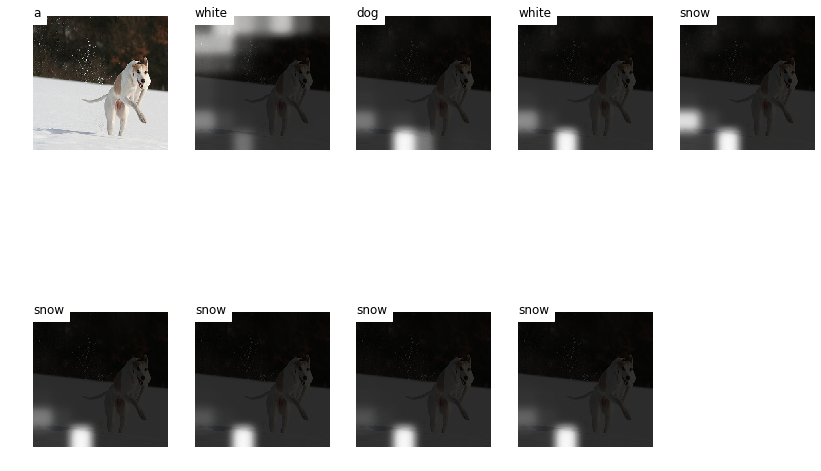

a man in a a a a
----------------------------------------------------------------------------------------------------


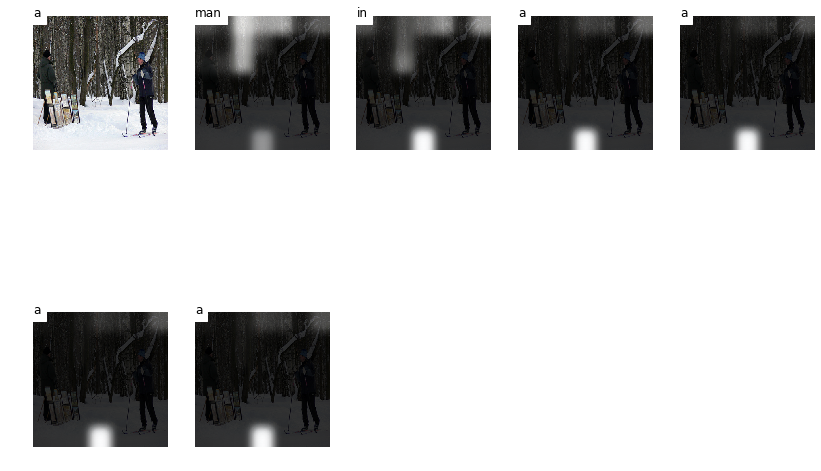

a man in a a a a a a
----------------------------------------------------------------------------------------------------


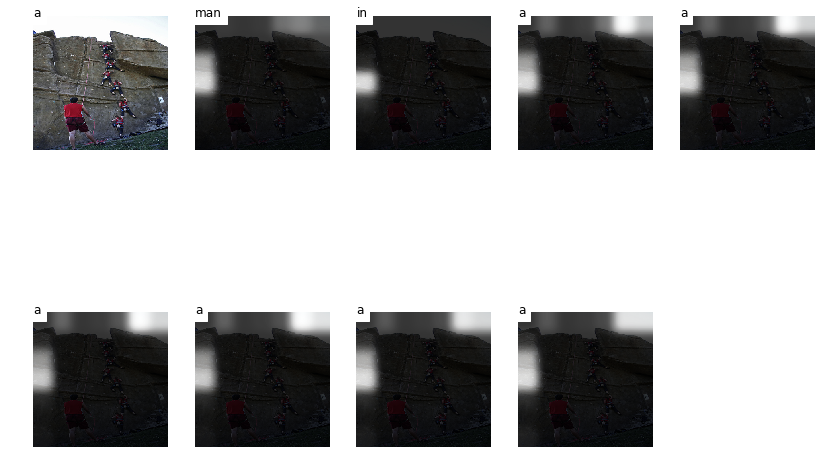

a dog dog is a a a a a
----------------------------------------------------------------------------------------------------


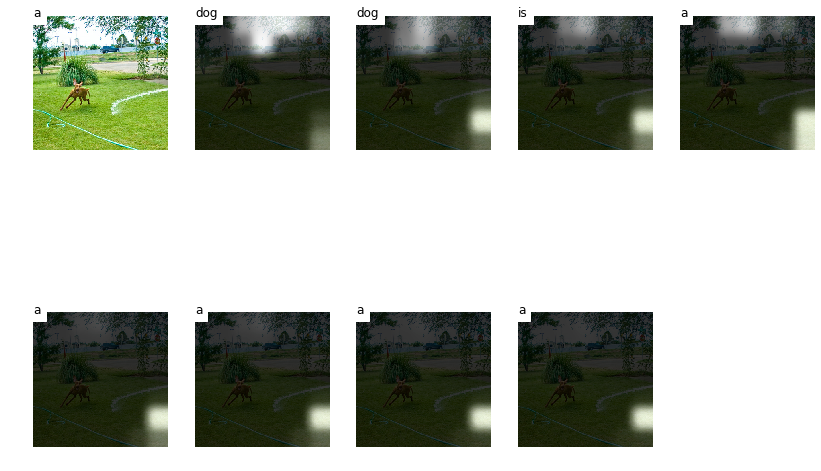

a dog dog is a a a a
----------------------------------------------------------------------------------------------------


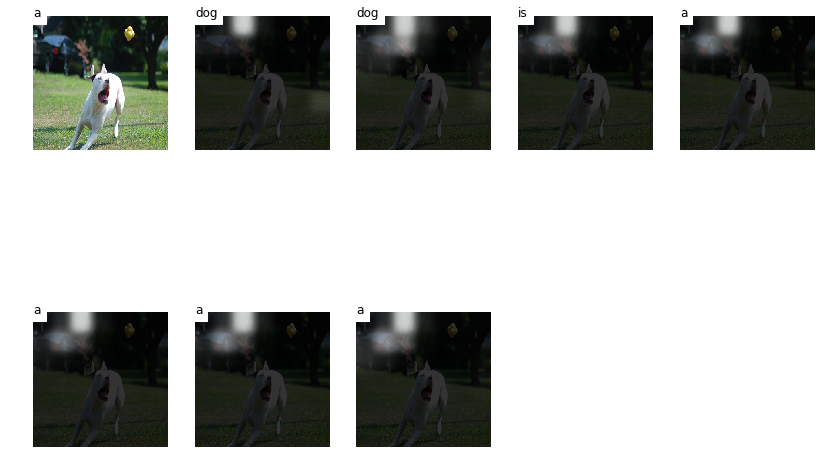

a dog and a a a a a
----------------------------------------------------------------------------------------------------


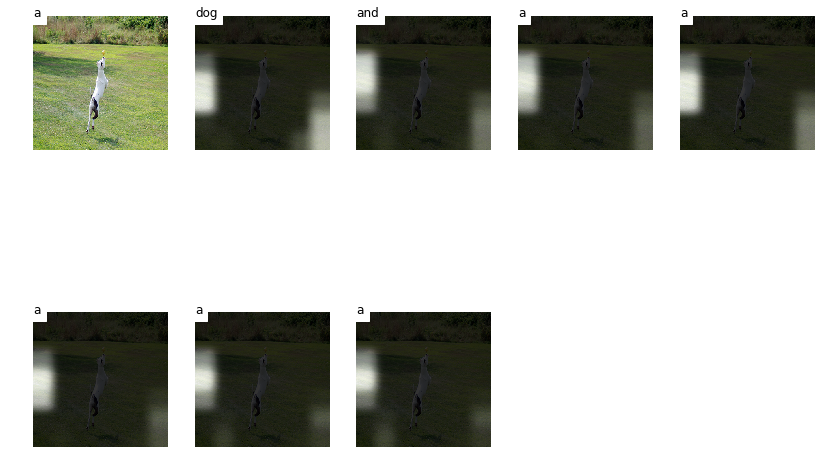

a man in a a a a a a .
----------------------------------------------------------------------------------------------------


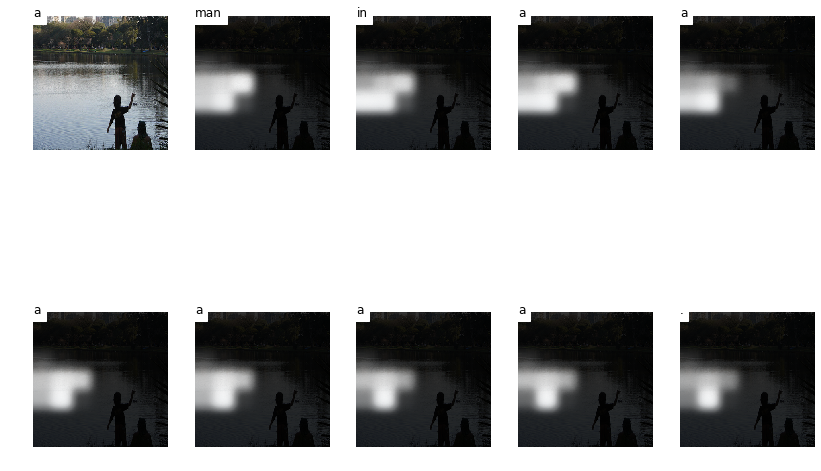

a man in a a a a
----------------------------------------------------------------------------------------------------


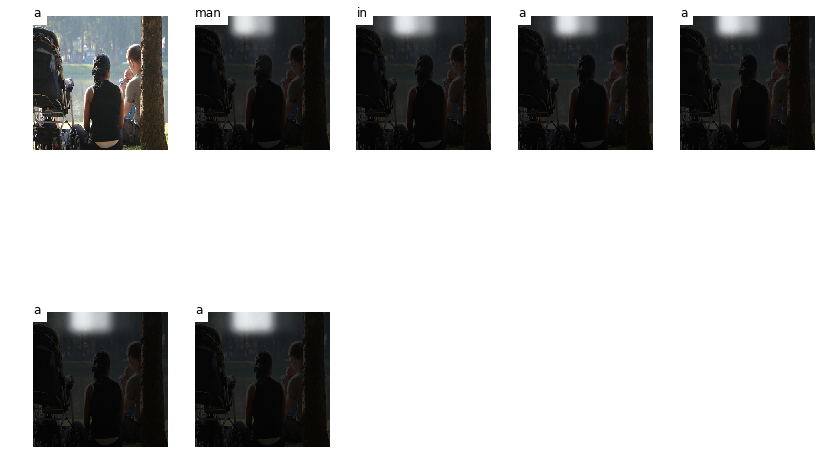

a black dog is a a a a .
----------------------------------------------------------------------------------------------------


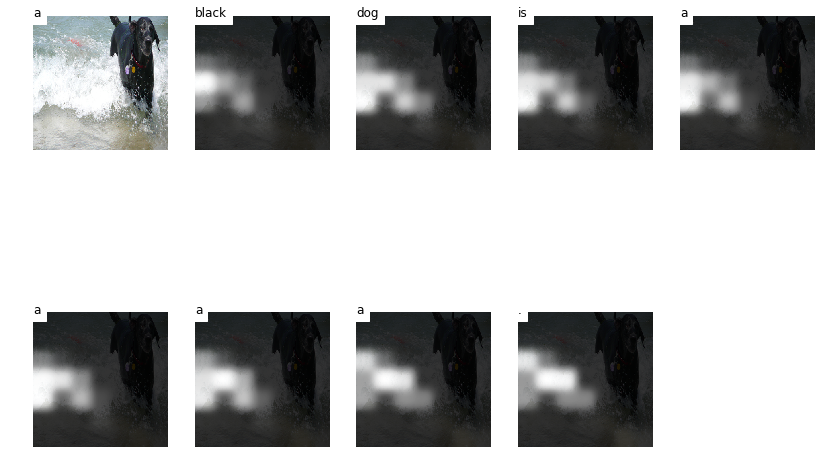

a man is a a a a
----------------------------------------------------------------------------------------------------


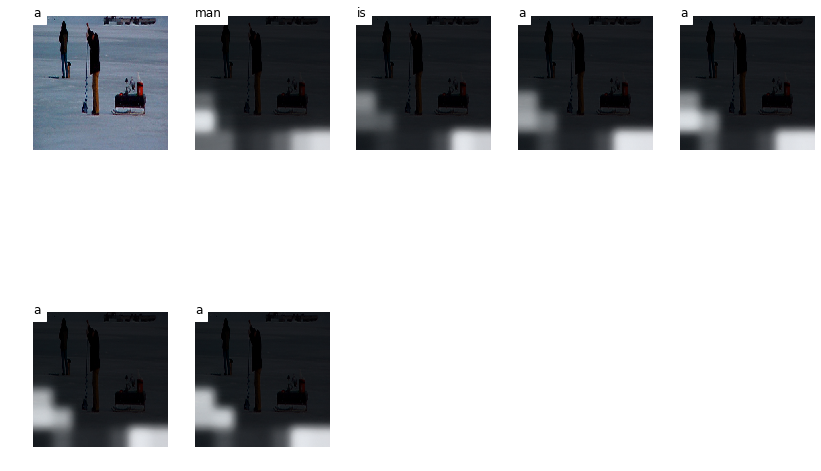

In [434]:
for i in range(20):
    image_path = os.path.join('./data/Flicker8k_Dataset/', dataset.test_ids[i])
    encoder_out = dataset._getitem_by_img_id(dataset.test_ids[i])[0]

    plot_pred(encoder_out, image_path, img2seq_beam_search)

## Сгенерируем описание для 5 моих изображений

two boy boy a a a a
----------------------------------------------------------------------------------------------------


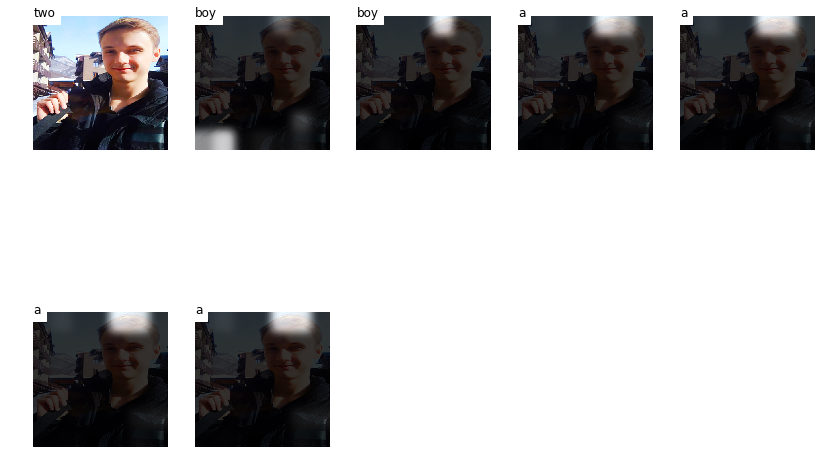

a girls are a a a a a
----------------------------------------------------------------------------------------------------


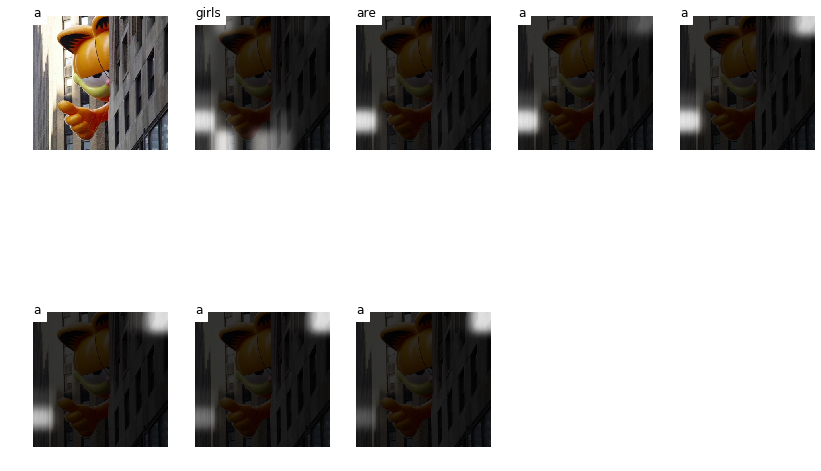

In [435]:
img_dir = './data/my_img/'
for name in os.listdir(img_dir):
    if not name.endswith('.jpg'):
        continue
    
    img_path = os.path.join(img_dir, name)
    encoder_out = encoder(enc_transform(Image.open(img_path)).unsqueeze(0)).squeeze(0)
    plot_pred(encoder_out, img_path, img2seq_beam_search)